# Управление рисками 2026

## Часть 1. График линейности признака по WoE.

В этой части домашки мы познакомимся с одним из основных инструментов для анализа переменных в модели логистической регрессии - графиком линейности. 

Кратко идею этого графика можно сформулировать так:
 - модель *линейной* регрессии корректно применять, если значение $y$ *линейно* связано со значением $x$. Иначе линрег не подходит для данной задачи и даст неверные результаты.
 - аналогичную проверку хочется сделать и для *логистической* регрессии. Но как проверить линейность, если таргет принимает всего два значения?
 - для этого необходимо преобразовать таргет: разбить признак на бакеты и в каждом бакете посчитать WoE
 - **линейность признака по WoE для логрега – аналог линейной связи признака и таргета для линрега**

Ниже пример признака с неплохой линейностью:

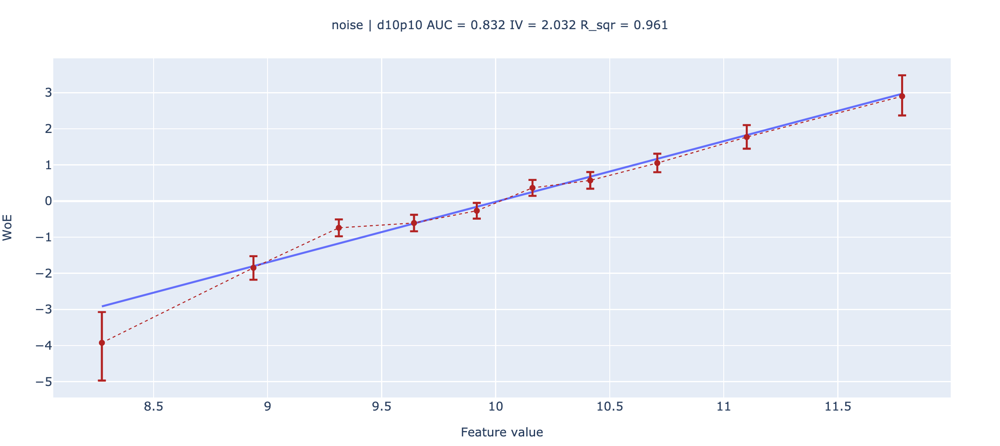

Нам нужно обратить внимание на 3 вещи:

**1. Фиолетовые точки с доверительными интервалами.**

Это WoE для каждого отдельного бакета. В идеале нам бы хотелось, чтобы **через эти точки можно было провести прямую линию** с небольшой погрешностью. Это и означает линейную взаимосвязь с таргетом.

**2. Синяя линия**

Попытка провести прямую линию через точки. Строится с помощью логистической регрессии на одной переменной. Затем предсказания переводятся в пространство WoE, отчего и получается прямая линия.

**3. Метрики в заголовке графика**

Метрики для признака:
 - roc auc, IV измеряют разделяющую способность переменной
 - $R^2$ измеряет *линейность взаимосвязи*. Признак считается линейным, если $R^2 \geq 0.95$

Далее напишем woe-line руками, чтобы в деталях разобраться, как он строится.

In [67]:
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as sps
from typing import Union, Tuple

### Шаг 0: разбиение на бакеты

In [68]:
def calc_buckets(x : Union[np.ndarray, pd.Series], n_buckets : int) -> np.ndarray:
    """Разбивает массив значений признака x на 
    n_buckets бакетов"""

    x = pd.Series(x).reset_index(drop=True)
    buckets = x.rank(method="dense", pct=True) * n_buckets
    buckets = np.ceil(buckets) - 1   # np.floor дает другой результат для 5.0, 6.0 и т.д.
    buckets = np.array(buckets, dtype=np.int16)

    return buckets

In [69]:
# протестируйте calc_buckets
df = pd.read_csv('lr_hw_dataset-f0c3f806-f366-4c1d-adba-026bc2c96b54.csv')
ex = calc_buckets(df['feature_1'], 10)
len(ex) == len(df['feature_1'])

True

In [70]:
np.unique(ex)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int16)

### Шаг 1: расчет WoE по бакетам (2 балла)

Пусть $x_i \in \{ 0, 1\}^n$

$x_i$ - это вектор, состоящий из значений таргета *в одном бакете* $i$. 

Для бакета можно посчитать количество единиц $B_i$ (bads, выпавшие в дефолт) и количество нулей $G_i$ (goods).

$$
B_i = \sum_{j \in x_i} \mathbb{I} \{ j = 1\}\quad G_i = \sum_{j \in x_i} \mathbb{I} \{ j = 0\}
$$

Также число бэдов и гудов можно посчитать и **для всей выборки**: 

$$
% X = x_1 \cup x_2 \ldots \cup x_n
X = \{x_1,\; x_2\; \ldots\; x_n\}
$$

$$
B = \sum_{j \in X} \mathbb{I} \{ j = 1\}\quad G = \sum_{j \in X} \mathbb{I} \{ j = 0\}
$$

Тогда WoE можно посчитать как

$$
\text{WoE}_i(x) = \ln \Big ( \frac{B_i}{G_i} \Big ) - \ln \Big ( \frac{B}{G} \Big ) 
$$

**Задание**

Убедиться, что

$$
\text{WoE}_i(x) = \text{logit}(b_i) - \text{logit}(b)\quad  (1)
$$

где 

$$
b = \frac{B}{B + G}\quad \text{logit}(p) = \ln \Big (  \frac{p}{1 - p} \Big )
$$

В дальнейшем будем считать WoE по формуле $(1)$

In [71]:
from scipy.special import logit

def woe_transform(badrate : float, offset : float) -> float:
    """Считаем WoE для бакета с данным badrate и выборки
    с данным offset."""
    woe = logit(badrate) - offset
    return woe

Здесь и далее предлагается протестироать получившиеся функции. Нужно проверить, что
 - функция не ложится с ошибкой
 - возвращает то, что ожидается

In [72]:
# протестируй woe_transform
woe_transform(0.2, logit(0.1))

np.float64(0.8109302162163285)

In [73]:
np.log(20/80) - np.log(100/900)

np.float64(0.810930216216329)

In [74]:
b_i = 0.2
b = 0.1
offset = logit(b)
woe_transform(b_i, offset)
np.isclose(woe_transform(b_i, offset), np.log(20/80) - np.log(100/900))

np.True_

Ниже представлен шаблон функции, которая будет считать доверительный интервал к нашим вычислениям. Можно воспользоваться любым способом, который вам больше нравится. Для идей можно посмотреть различные способы подсчета доверительного интервала [здесь](https://en.wikipedia.org/wiki/Binomial_proportion_confidence_interval).

**P. S.**
Для того, чтобы построить доверительный интервал к $WoE$, можно сначала построить его для величины  $b_i = \frac{B_i}{B_i+G_i}$, а потом применить ```woe_transform```. В свою очередь величина $b_i$ является параметром распределения Бернулли, который мы можем оценить классическими методами (см. ссылку выше)

In [75]:
from scipy.stats import norm

def wilson_ci(k, n, alpha=0.05):
    z = norm.ppf(1 - alpha/2)
    p = k / n
    denom = 1 + (z**2)/n
    center = (p + (z**2)/(2*n)) / denom
    half = (z * np.sqrt((p*(1-p) + (z**2)/(4*n)) / n)) / denom

    lower = center - half
    upper = center + half
    return lower, upper

def woe_ci(target: np.ndarray, buckets: np.ndarray, offset: float, alpha: float = 0.05,
           eps: float = 1e-6) -> Tuple[pd.Series, pd.Series, pd.Series]:
    """Для каждого бакета вычисляем WoE и доверительный
    интервал для него."""
    target = np.asarray(target).astype(int)
    buckets = np.asarray(buckets).astype(int)

    df = pd.DataFrame({"bucket": buckets, "y": target})
    g = df.groupby("bucket")["y"]

    n = g.size().astype(float)
    k = g.sum().astype(float)
    p = (k / n).values
    p_low, p_up = wilson_ci(k.values, n.values, alpha=alpha)
    p = np.clip(p, eps, 1 - eps)
    p_low = np.clip(p_low, eps, 1 - eps)
    p_up = np.clip(p_up, eps, 1 - eps)

    w = woe_transform(p, offset)
    w_low = woe_transform(p_low, offset)
    w_up = woe_transform(p_up, offset)
    idx = n.index
    woe = pd.Series(w, index=idx, name="woe")
    woe_lower = pd.Series(w_low, index=idx, name="woe_lower")
    woe_upper = pd.Series(w_up, index=idx, name="woe_upper")

    return woe, woe_lower, woe_upper

### Шаг 2: расчет линейной интерполяции (1 балл)

In [76]:
from sklearn.linear_model import LogisticRegression

def calc_line(values : np.ndarray, target : np.ndarray, mean_feature : np.ndarray, offset : float) -> np.ndarray:
    """Строим линейную интерполяцию для WoE."""

    # строим логистическую регрессию на одном признаке
    # и считаем ее предсказания в точках – mean_feature
    X = np.asarray(values).reshape(-1, 1)
    y = np.asarray(target).astype(int)
    model = LogisticRegression(solver="lbfgs", max_iter=1000)
    model.fit(X, y)
    X_line = np.asarray(mean_feature).reshape(-1, 1)
    proba = model.predict_proba(X_line)[:, 1]
    line = woe_transform(proba, offset)
    return line

In [77]:
# протестируйте calc_line
values = df["feature_1"].values
target = df["d4p12"].values
mean_feature = np.linspace(values.min(), values.max(), 20)
offset = logit(np.clip(target.mean(), 1e-6, 1 - 1e-6))
line = calc_line(values, target, mean_feature, offset)
line

array([-3.39794965, -3.09147454, -2.78499942, -2.47852431, -2.17204919,
       -1.86557408, -1.55909897, -1.25262385, -0.94614874, -0.63967362,
       -0.33319851, -0.02672339,  0.27975172,  0.58622684,  0.89270195,
        1.19917707,  1.50565218,  1.8121273 ,  2.11860241,  2.42507753])

### Шаг3: собираем результаты по бакетам в один словарь (1 балл)

In [78]:
def calc_buckets_info(values : np.ndarray, target : np.ndarray, buckets : np.ndarray) -> dict:
    """Для каждого бакета расчитывает
     - среднее значение признака
     - линейную интерполяцию в пространстве woe
     - значение woe и доверительный интервал для него"""

    values = np.asarray(values)
    target = np.asarray(target)
    buckets = np.asarray(buckets)
    b = target.mean()
    offset = logit(np.clip(b, 1e-6, 1 - 1e-6))
    mean_feature = (pd.DataFrame({"value": values, "bucket": buckets}).groupby("bucket")["value"].mean().values)
    woe, woe_lower, woe_upper = woe_ci(target, buckets, offset)
    line = calc_line(values, target, mean_feature, offset)
    
    buckets_info = {
        "mean_feature": mean_feature,
        "line": line,
        "woe": woe.values,
        "woe_lower": woe_lower.values,
        "woe_upper": woe_upper.values
    }

    return buckets_info

In [79]:
# протестируйте calc_buckets_info
values = df["feature_1"].values
target = df["d4p12"].values
buckets = calc_buckets(values, n_buckets=10)

buckets_info = calc_buckets_info(values, target, buckets)

for k, v in buckets_info.items():
    print(k, type(v), len(v))

mean_feature <class 'numpy.ndarray'> 10
line <class 'numpy.ndarray'> 10
woe <class 'numpy.ndarray'> 10
woe_lower <class 'numpy.ndarray'> 10
woe_upper <class 'numpy.ndarray'> 10


### Шаг 4: считаем метрики признака (2 балла)

Рассчитаем также несколько метрик, чтобы судить о качестве признака не только по картинкам. 

Приведем формулу для IV:

$$
\text{IV}(x) = \sum_{i = 1}^{n}\Big ( \frac{B_i}{B} - \frac{G_i}{G} \Big ) \times \text{WoE}_i
$$

**Вопрос:** зачем считать ранжирующую силу признака двумя способами? Какую дополнительную информацию может дать IV относительно roc auc?

Ответ: IV показывает немонотонности WoE и повзволяет понимать, когда фича разделяет риски, но плохо ранжирует наблюдения

In [80]:
from sklearn.metrics import roc_auc_score

def calc_plot_title(
        values : np.ndarray,
        target : np.ndarray,
        buckets : np.ndarray
    ) -> str:
    values = np.asarray(values).reshape(-1)
    target = np.asarray(target).astype(int).reshape(-1)
    buckets = np.asarray(buckets).astype(int).reshape(-1)

    df = pd.DataFrame({"bucket": buckets, "y": target, "x": values})
    agg = df.groupby("bucket").agg(
        B=("y", "sum"),
        N=("y", "size"),
        mean_feature=("x", "mean"),
    )
    agg["G"] = agg["N"] - agg["B"]

    B = agg["B"].sum()
    G = agg["G"].sum()
    eps = 1e-6
    b_i = (agg["B"] + eps) / (B + eps * len(agg))
    g_i = (agg["G"] + eps) / (G + eps * len(agg))

    woe = np.log(b_i / g_i).values

    bucket_to_woe = pd.Series(woe, index=agg.index)
    score_woe = df["bucket"].map(bucket_to_woe).values
    auc = roc_auc_score(target, score_woe)
    IV = float(np.sum((b_i.values - g_i.values) * woe))
    Xb = agg["mean_feature"].values
    Yb = woe
    Wb = agg["N"].values

    xw = np.average(Xb, weights=Wb)
    yw = np.average(Yb, weights=Wb)
    cov_xy = np.average((Xb - xw) * (Yb - yw), weights=Wb)
    var_x = np.average((Xb - xw) ** 2, weights=Wb)
    var_y = np.average((Yb - yw) ** 2, weights=Wb)
    R_sqr = float((cov_xy ** 2) / (var_x * var_y + 1e-12))

    return f"AUC = {auc:.3f} IV = {IV:.3f} R_sqr = {R_sqr:.3f}"

In [81]:
# протестируйте calc_plot_title
title = calc_plot_title(values, target, buckets)
title

'AUC = 0.635 IV = 0.239 R_sqr = 0.174'

### Шаг 5: собираем все в одну функцию и строим график

In [82]:
# в этот код можно не въезжать :)
import plotly.graph_objects as go

def make_figure(buckets_info : dict, plot_title : str) -> go.Figure:
    """Строит график линейности."""
    fig = go.Figure()

    # общие настройки
    title = dict(
        text=plot_title,
        y=0.95,
        x=0.5,
        font=dict(size=12),
        xanchor="center",
        yanchor="top"
    )
    margin = go.layout.Margin(
        l=50,
        r=50,
        b=50,
        t=60
    )

    fig.add_trace(
        go.Scatter(
            x=buckets_info["mean_feature"],
            y=buckets_info["line"],
            mode='lines',
            name="interpolation_line",
            showlegend=False
        )
    )

    fig.add_trace(
        go.Scatter(
            x=buckets_info["mean_feature"],
            y=buckets_info["woe"],
            line=dict(
                color='firebrick',
                width=1,
                dash='dot'
            ),
            error_y=dict(
                type='data',
                symmetric=False,
                array=buckets_info["woe_upper"],
                arrayminus=buckets_info["woe_lower"]
            ),
            name="WoE",
            showlegend=False)
    )

    fig.update_layout(
        width=1000,
        height=450,
        xaxis_title=dict(
            text='Feature value',
            font=dict(size=12)
        ),
        yaxis_title=dict(
            text="WoE",
            font=dict(size=12)
        ),
        title=title,
        margin=margin
    )

    return fig

In [83]:
def woe_line(
        values : np.ndarray,
        target : np.ndarray,
        n_buckets : int
    ) -> go.Figure:
    """График линейности переменной по WoE."""
    buckets : np.ndarray = calc_buckets(values, n_buckets)
    buckets_info : pd.DataFrame = calc_buckets_info(values, target, buckets)
    plot_title : str = calc_plot_title(values, target, buckets)
    fig = make_figure(buckets_info, plot_title)
    return fig

Чтобы протестировать реализацию, сгенерируем синтетические данные:

In [84]:
sample_size = int(1e4)
noise_std = 1.

df = pd.DataFrame()
y = np.array(sample_size // 2 * [0] + sample_size // 2 * [1])
df['target']  = y

np.random.seed(89)
x = np.concatenate([sps.norm(0, noise_std).rvs(size = sample_size // 2), sps.norm(1, noise_std).rvs(size = sample_size // 2)])
df['feature'] = x

<Axes: xlabel='feature', ylabel='Count'>

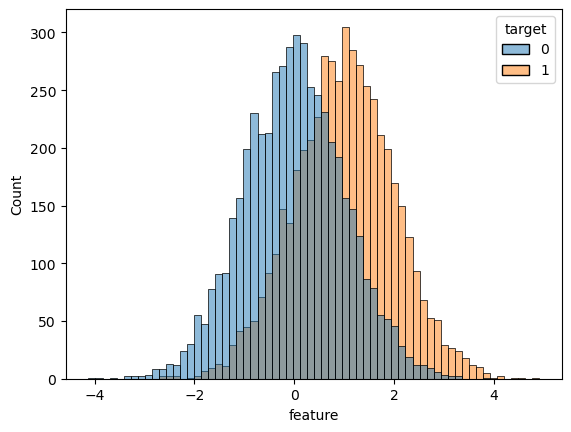

In [85]:
sns.histplot(df, x = 'feature', hue = 'target')

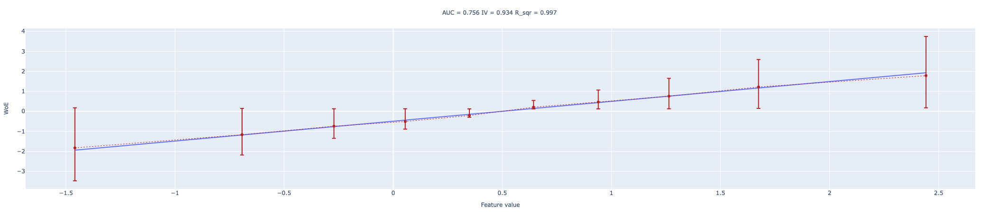

In [86]:
# запустите после того, как реализуете все функции 
woe_line(values=x, target=y, n_buckets=10)

### Эксперименты (2 балл)

#### №1 

Как будут меняться график, метрики разделяющей способности и $R^2$ при изменении дисперсии шума (параметр `noise_std`)? 

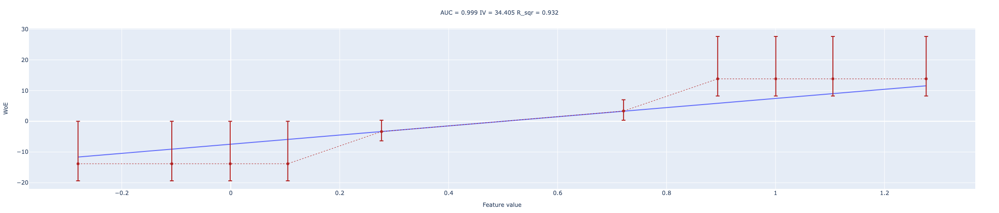

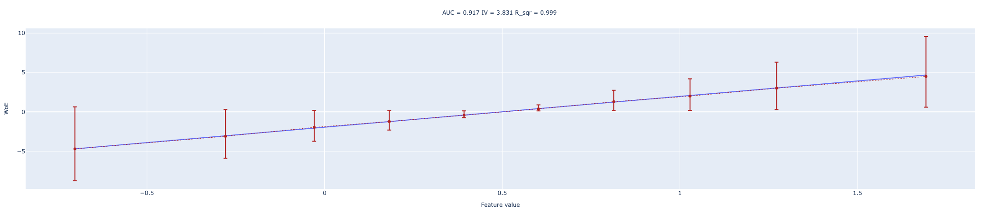

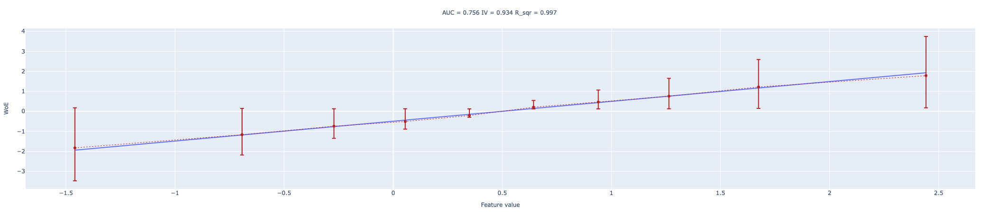

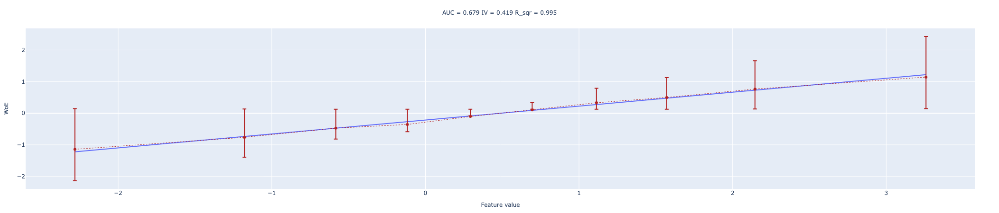

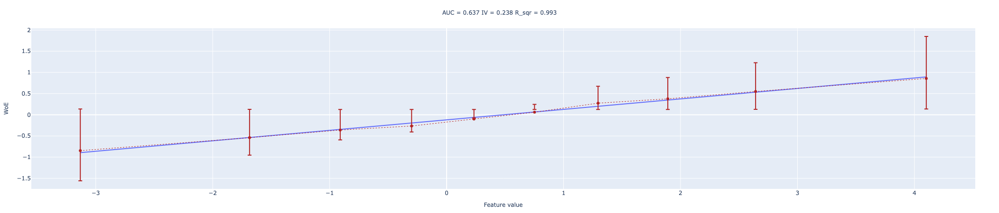

,noise_std,AUC,IV,R_sqr
0,0.2,0.999,34.405,0.932
1,0.5,0.917,3.831,0.999
2,1.0,0.756,0.934,0.997
3,1.5,0.679,0.419,0.995
4,2.0,0.637,0.238,0.993


In [87]:
noise_vals = [0.2, 0.5, 1.0, 1.5, 2.0]
sample_size = int(1e4)
y = np.array(sample_size // 2 * [0] + sample_size // 2 * [1])

rows = []

for noise_std in noise_vals:
    np.random.seed(89)
    x = np.concatenate([
        sps.norm(0, noise_std).rvs(size=sample_size // 2),
        sps.norm(1, noise_std).rvs(size=sample_size // 2)
    ])
    fig = woe_line(values=x, target=y, n_buckets=10)
    fig.show()
    buckets = calc_buckets(x, 10)
    title = calc_plot_title(x, y, buckets)
    auc = float(title.split("AUC = ")[1].split(" ")[0])
    IV = float(title.split("IV = ")[1].split(" ")[0])
    R_sqr = float(title.split("R_sqr = ")[1].split(" ")[0])

    rows.append([noise_std, auc, IV, R_sqr])

res = pd.DataFrame(rows, columns=["noise_std", "AUC", "IV", "R_sqr"])
res

#### №2 

Запустите функцию с `values=x ** 2`. Как по графику определить эту ситуацию? Что нужно делать в таком случае?

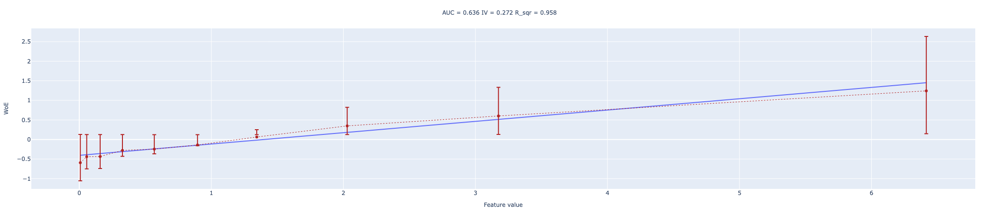

In [88]:
sample_size = int(1e4)
noise_std = 1.

df = pd.DataFrame()
y = np.array(sample_size // 2 * [0] + sample_size // 2 * [1])
df['target']  = y

np.random.seed(89)
x = np.concatenate([sps.norm(0, noise_std).rvs(size = sample_size // 2), sps.norm(1, noise_std).rvs(size = sample_size // 2)])
df['feature'] = x

woe_line(values=x**2, target=y, n_buckets=10)

Здесь видно, что зависимость не идеально линейная: на малых значениях есть сжатие, а на больших резкий рост. Также крайние бакеты имеют очень широкий доверительный интервал. В такой ситуации признак нельзя использовать в логистической регрессии напрямую. Необходимо либо преобразование, либо разбиение на линейные фрагменты.

#### №3

Запустите функцию с `values=np.exp(x)`. Как по графику определить эту ситуацию? Что нужно делать в таком случае?

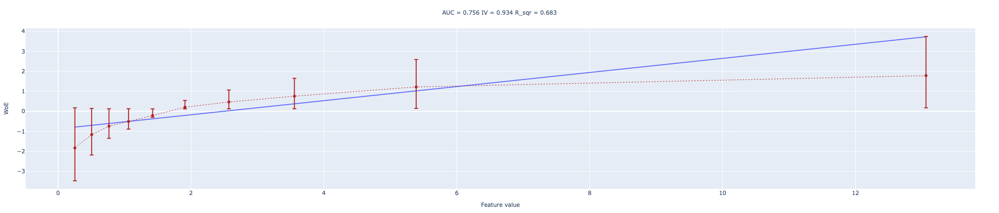

In [89]:
woe_line(values=np.exp(x), target=y, n_buckets=10)

Здесь видно, что зависимость не идеально линейная: экспоненциальное растежение шкалы. Крайние бакеты имеют очень широкий доверительный интервал. В такой ситуации признак нельзя использовать в логистической регрессии напрямую. Необходимо либо логарифмическое преобразование.

## Часть 2. Строим ЛогРег. (5 баллов)

В этом пунтке попробуем применить все наши навыки 

Скачайте датасет по [ссылке](https://data.tinkoff.ru/s/Nca7PoTNYokXgNF). Пароль вы найдете в телеграм-канале курса, в посте с анонсом домашки.

In [90]:
df = pd.read_csv('lr_hw_dataset-f0c3f806-f366-4c1d-adba-026bc2c96b54.csv')
df

,Unnamed: 0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,d4p12
0,0,-1.444709,3.554779,1.308371,-0.000119,0.029628,3.829880,1,8.825418,3.829880,11.565953,-513.014565,-1.072893,7.936545,0.047069,B,1
1,1,1.132531,-0.207661,-2.142882,0.062686,0.859062,6.189545,1,3.453220,6.189545,4.935665,-39.351891,3.409855,17.015210,0.029288,A,0
2,2,1.268781,-0.243999,10000.000000,0.339225,0.614599,12.503629,1,-10.116061,12.503629,6.234414,-4.993050,3.121126,4.878602,0.237255,A,0
3,3,-1.278475,-2.579890,5.050763,-0.938956,0.090461,-1.080041,1,6.780814,-1.080041,2.682539,-509.273095,-1.242741,20.293025,0.907788,B,0
4,4,3.507807,0.152661,-8.905005,0.067646,0.216199,1.367184,1,-10.638134,1.367184,6.881602,-2.034797,2.814972,7.352399,0.276854,A,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,99995,-3.061422,-0.163832,4.812768,-0.949937,0.224437,5.263508,1,-9.959913,5.263508,5.294558,-524.265291,-1.648415,5.410059,0.855190,B,0
99996,99996,0.222451,-0.273191,0.380895,0.860607,0.950708,0.581767,1,-1.645952,0.581767,5.571499,-13.499956,3.386865,92.903615,0.006668,A,1
99997,99997,1.078498,0.339526,-5.184847,0.242072,0.854085,0.995075,1,-5.565932,0.995075,-0.433263,3.928387,3.290285,1.233853,0.160933,A,1
99998,99998,-1.431421,-0.605388,2.466023,-0.056519,0.736255,2.980562,1,-4.517188,2.980562,10.812813,-507.593408,-1.398568,1904.246147,0.077164,B,1


Как вы выдите, ```feature_1, ..., feature_14``` - числа 
```feature_15``` - категориальная фича

### Задание 0. EDA.

Как бы вы начали знакомиться с данными до построения модели? Постройте 3-5 графиков / таблиц, чтобы передать основную информацию о датасете.

In [91]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 17 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Unnamed: 0  100000 non-null  int64  
 1   feature_1   100000 non-null  float64
 2   feature_2   100000 non-null  float64
 3   feature_3   100000 non-null  float64
 4   feature_4   100000 non-null  float64
 5   feature_5   100000 non-null  float64
 6   feature_6   100000 non-null  float64
 7   feature_7   100000 non-null  int64  
 8   feature_8   100000 non-null  float64
 9   feature_9   100000 non-null  float64
 10  feature_10  100000 non-null  float64
 11  feature_11  100000 non-null  float64
 12  feature_12  100000 non-null  float64
 13  feature_13  100000 non-null  float64
 14  feature_14  100000 non-null  float64
 15  feature_15  100000 non-null  object 
 16  d4p12       100000 non-null  int64  
dtypes: float64(13), int64(3), object(1)
memory usage: 13.0+ MB


<Axes: xlabel='d4p12'>

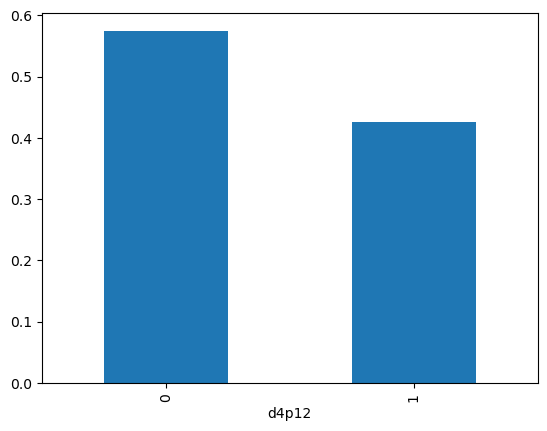

In [92]:
df['d4p12'].value_counts(normalize=True).plot(kind="bar")

<Axes: >

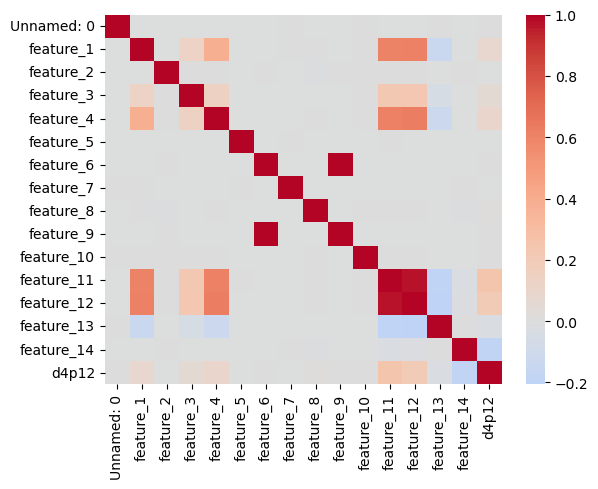

In [93]:
corr = df.select_dtypes(include="number").corr()
sns.heatmap(corr, cmap="coolwarm", center=0)

<Axes: xlabel='feature_15'>

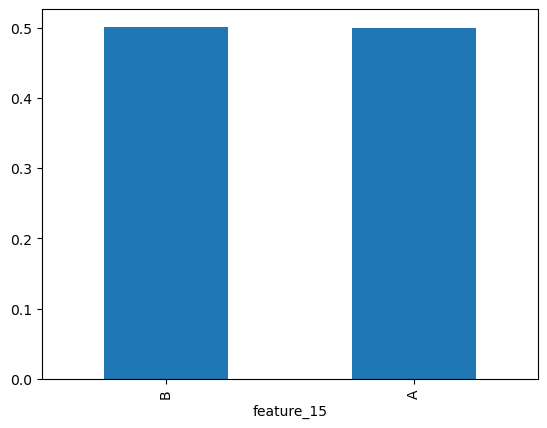

In [94]:
df['feature_15'].value_counts(normalize=True).plot(kind="bar")

### Задание 1. Бейзлайн.

Попробуйте построить ЛогРег только на числовых данных. Для этого разбейте датасет на трейн и тест (80/20). Перед обучением логрега стандартизуйте переменные. Это может быть полезно для численной устойчивости алгоритмов оптимизации.

Для этой модели и всех дальнейших:

1. Получилась ли модель линейной? Постройте график линейности на трейне и на тесте и сделайте вывод.
2. Расчитайте AUC и IV на трейне и на тесте. Что можно сказать о переобучении?

In [130]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score

In [131]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

X_num = df.drop(['feature_15', 'd4p12'], axis=1)
y = df['d4p12']

X_train_num, X_test_num, y_train, y_test = train_test_split(X_num, y, test_size=0.2, random_state=42, stratify=y)

In [132]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_num)
X_test_scaled = scaler.transform(X_test_num)

In [133]:
logreg = LogisticRegression()

logreg.fit(X_train_scaled, y_train)

LogisticRegression()

In [134]:
n_buckets = 10

score_train = logreg.predict_proba(X_train_scaled)[:, 1]
score_test = logreg.predict_proba(X_test_scaled)[:, 1]

buckets_train = calc_buckets(score_train, n_buckets)
buckets_test = calc_buckets(score_test, n_buckets)

title_train = calc_plot_title(values=score_train, target=y_train, buckets=buckets_train)
title_test = calc_plot_title(values=score_test, target=y_test, buckets=buckets_test)

print("train:", title_train)
print("test :", title_test)

train: AUC = 0.702 IV = 0.592 R_sqr = 0.969
test : AUC = 0.710 IV = 0.636 R_sqr = 0.976


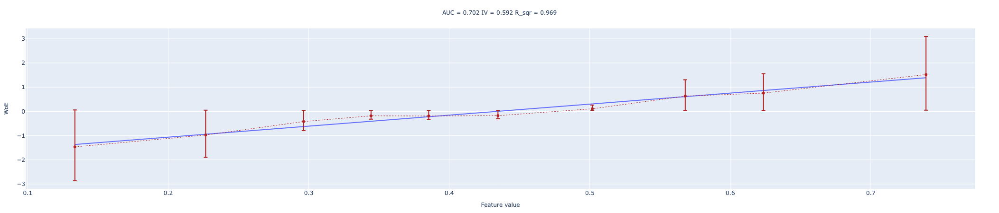

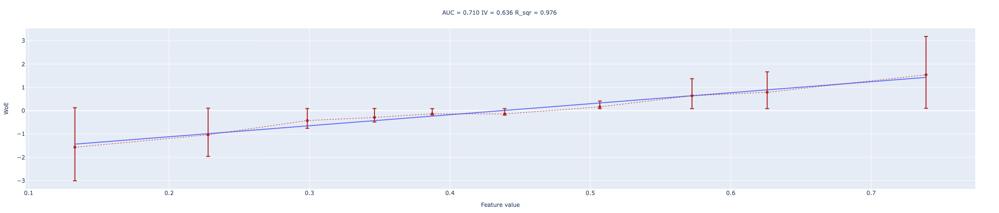

In [135]:
fig_train = woe_line(
    values=score_train,
    target=y_train.values,
    n_buckets=n_buckets
)
fig_train.show()

fig_test = woe_line(
    values=score_test,
    target=y_test.values,
    n_buckets=n_buckets
)
fig_test.show()

На трейне и на тесте график линейности близок к линейному: существенных изломов нет, доверительные интервалы не нарушают общий тренд. Это подтверждается высокими значениями r2 (0.969 на трейне и 0.976 на тесте), поэтому модель можно считать линейной. Различий между train и test не наблюдается, признаков переобучения нет.

### Задание 2. Добавляем категориальную переменную.

Повторите задание 1, включив в модель категориальную переменную (например, с помощью one-hot encoding).

Улучшилось ли качество?

In [136]:
X = df.drop('d4p12', axis=1)
y = df['d4p12']

X = pd.get_dummies(X, columns=['feature_15'], drop_first=True)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [137]:
logreg_cat = LogisticRegression()
logreg_cat.fit(X_train_scaled, y_train)

LogisticRegression()

In [138]:
score_train = logreg_cat.predict_proba(X_train_scaled)[:, 1]
score_test = logreg_cat.predict_proba(X_test_scaled)[:, 1]

buckets_train = calc_buckets(score_train, 10)
buckets_test = calc_buckets(score_test, 10)

print("train:", calc_plot_title(score_train, y_train, buckets_train))
print("test :", calc_plot_title(score_test, y_test, buckets_test))

train: AUC = 0.857 IV = 2.272 R_sqr = 0.951
test : AUC = 0.855 IV = 2.226 R_sqr = 0.949


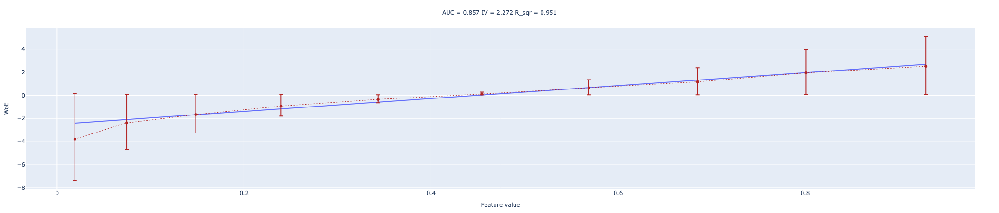

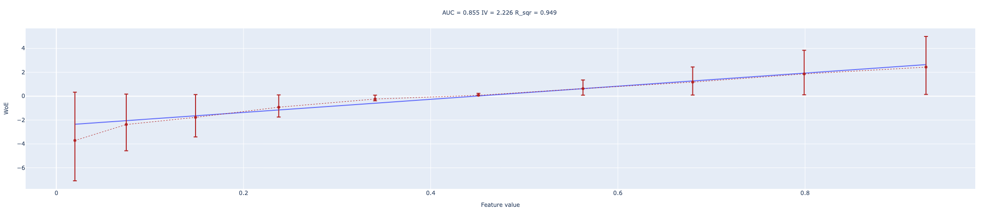

In [139]:
fig_train = woe_line(
    values=score_train,
    target=y_train.values,
    n_buckets=n_buckets
)
fig_train.show()

fig_test = woe_line(
    values=score_test,
    target=y_test.values,
    n_buckets=n_buckets
)
fig_test.show()

По графикам линейности скоринга по WoE на трейне и на тесте зависимость в целом близка к линейной. Значения находятся на границе порога 0.95. Линейность выполняется, но добавление категориальной переменной слегка ухудшило линейность по сравнению с моделью без неё. Качество модели существенно выросло. Переобучения не наблюдается

### Задание 3. Линеаризация переменных.

На самом деле, категориальные переменные можно учитывать в моделях совсем по-другому. С их помощью можно выделить в модели сегменты. Каждому сегменту соответствует своя модель (в нашем случае логрег). 

Примером такой сегментации может стать сегментация по наличию кредитной истории. В этом случае на разных сегментах будут не просто отдельные модели, но и даже разный изначальный набор признаков. Другое свидетельство удачной сегментации – разный характер зависимости признаков и целевой переменной. Это можно увидеть на графике линейности признака по WoE. Этим мы и займемся далее.

Используйте переменную 15 для сегментации модели. На каждом из двух сегментов линеаризуйте переменные. Для этого приложите:
 - график линейности переменной до преобразования
 - график после подобранного преобразования

Помимо этого:
 - попробуйте линеаризовать какие-нибудь 2 переменные *на всей выборке*. Получилось ли у вас что-то? Постройте график.
 - по графику линейности определите шумовые (либо слабоинформативные) переменные. В конце задания приложите их список.

In [148]:
target_col = "d4p12"
seg_col = "feature_15"
num_cols = [c for c in df.columns if c.startswith("feature_") and c != seg_col]

def clip_by_percentiles(x: np.ndarray, lo: float = 1, hi: float = 99):
    a, b = np.nanpercentile(x, lo), np.nanpercentile(x, hi)
    return np.clip(x, a, b)

def safe_log1p_abs(x: np.ndarray):
    return np.log1p(np.abs(x))

def safe_sqrt_abs(x: np.ndarray):
    return np.sqrt(np.abs(x))

def safe_rank_gauss(x: np.ndarray):
    s = pd.Series(x).rank(method="average", pct=True).values
    s = np.clip(s, 1e-6, 1 - 1e-6)
    from scipy.stats import norm
    return norm.ppf(s)

In [149]:
def plot_distribution(x: np.ndarray, y: np.ndarray, title: str, bins: int = 60):
    tmp = pd.DataFrame({"x": x, "y": y})
    fig, ax = plt.subplots(1, 2, figsize=(12, 4))

    sns.histplot(tmp["x"], bins=bins, ax=ax[0])
    ax[0].set_title(f"{title} | distribution")
    ax[0].set_xlabel("x")

    sns.histplot(data=tmp, x="x", hue="y", bins=bins, ax=ax[1], common_norm=False)
    ax[1].set_title(f"{title} | by target")
    ax[1].set_xlabel("x")

    plt.tight_layout()
    plt.show()

In [150]:
transforms = [
    ("raw", lambda x: x),
    ("clip_p1_p99", lambda x: clip_by_percentiles(x, 1, 99)),
    ("log1p_abs", lambda x: safe_log1p_abs(x)),
    ("sqrt_abs", lambda x: safe_sqrt_abs(x)),
    ("rank_gauss", lambda x: safe_rank_gauss(x)),
]

сегмент: A size: 49894
feature_1 | segment A


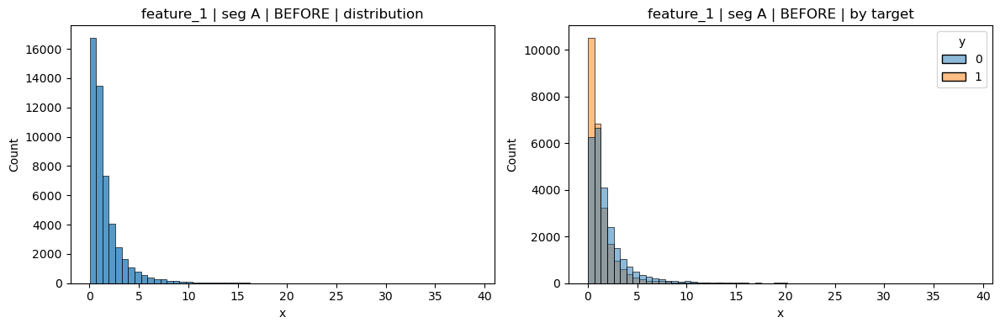

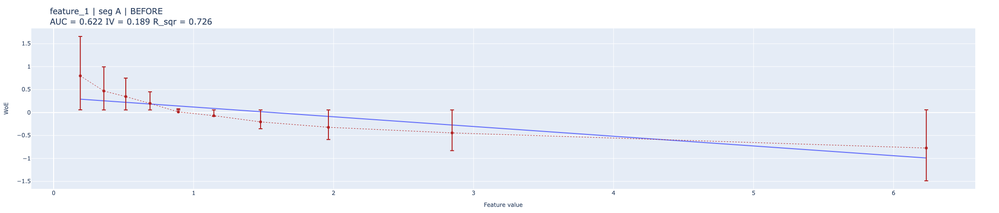

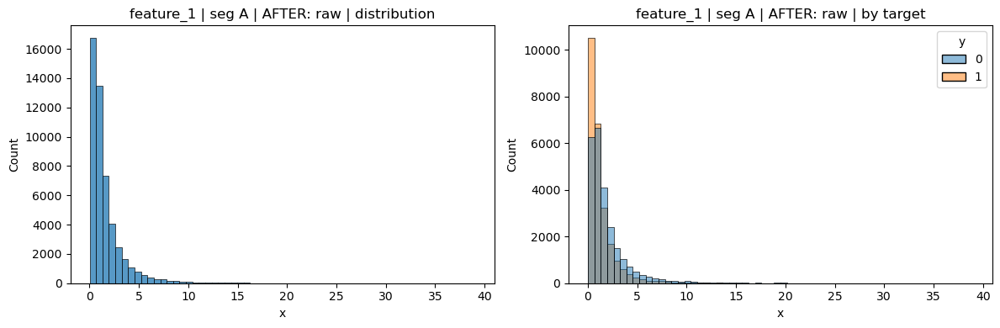

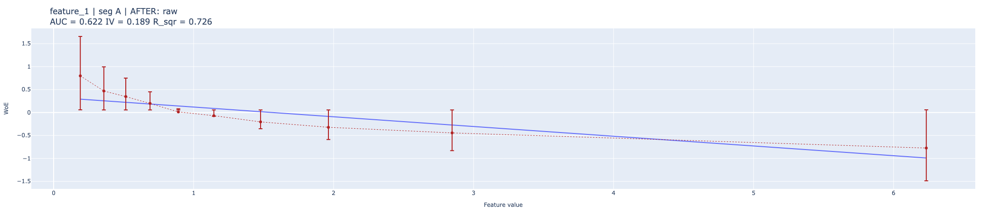

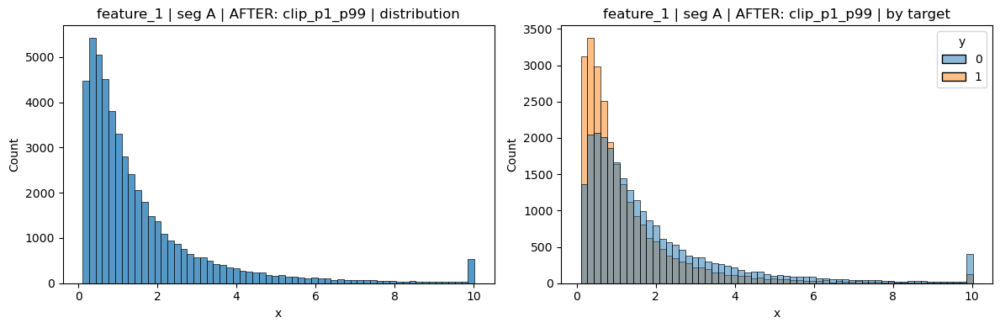

...

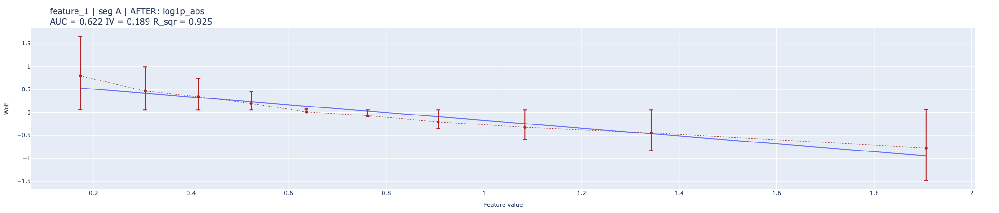

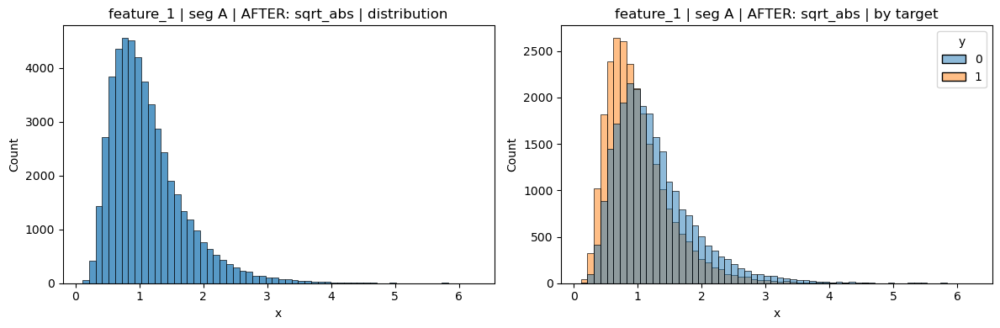

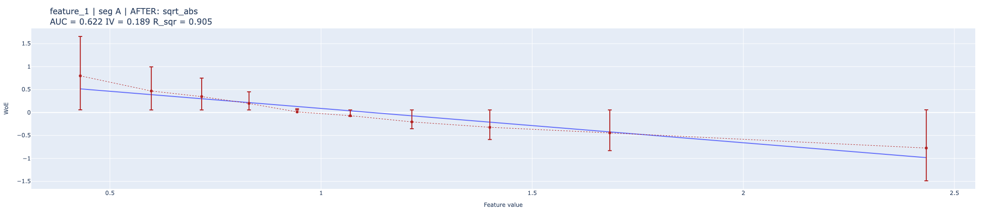

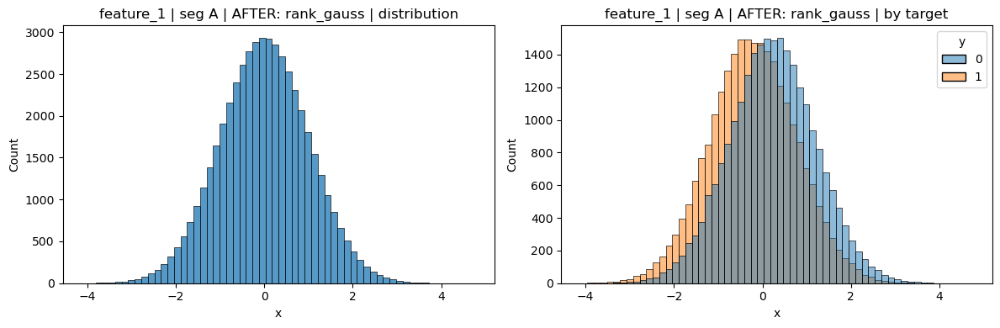

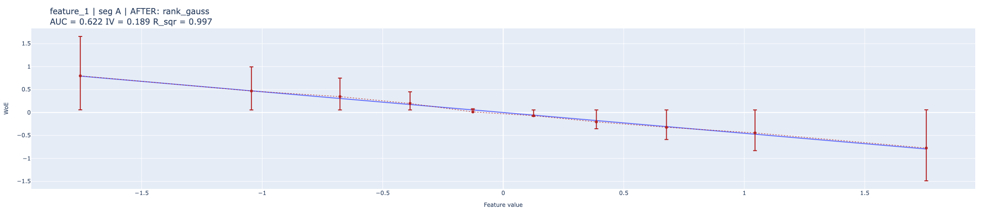

feature_2 | segment A


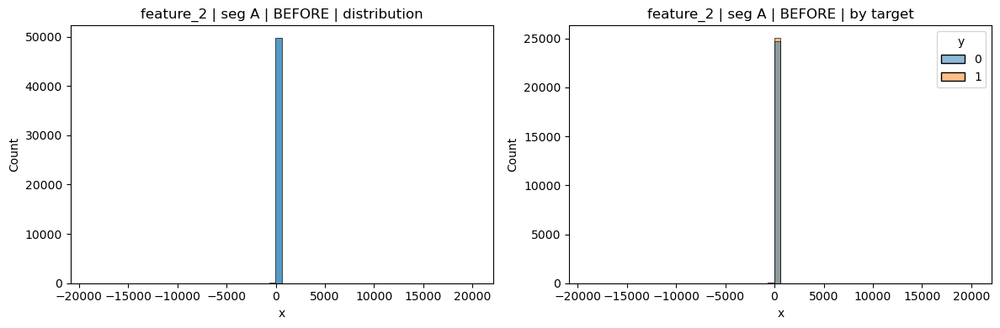

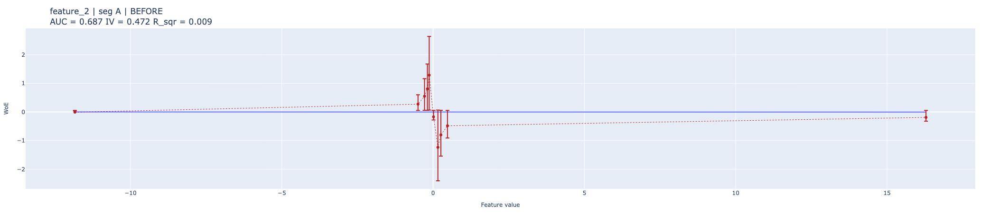

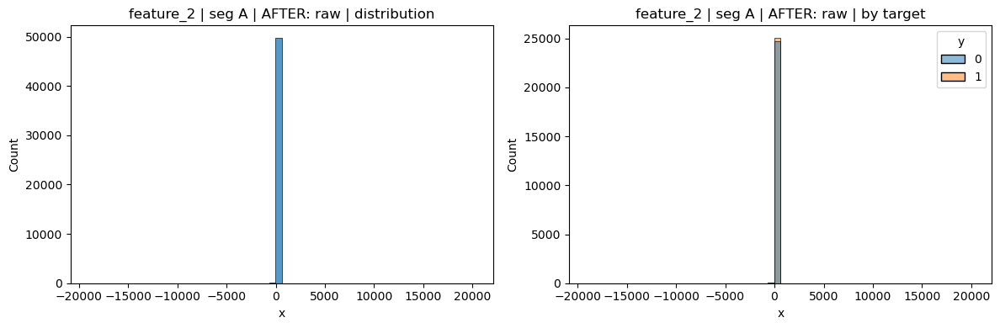

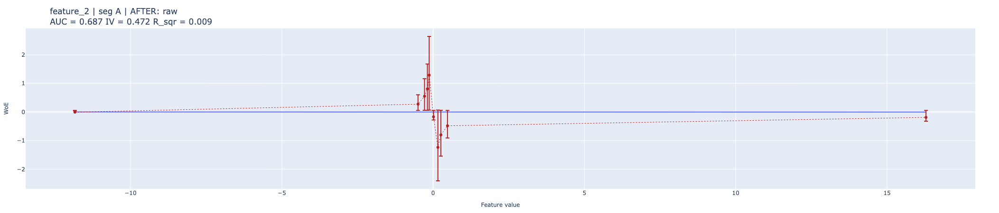

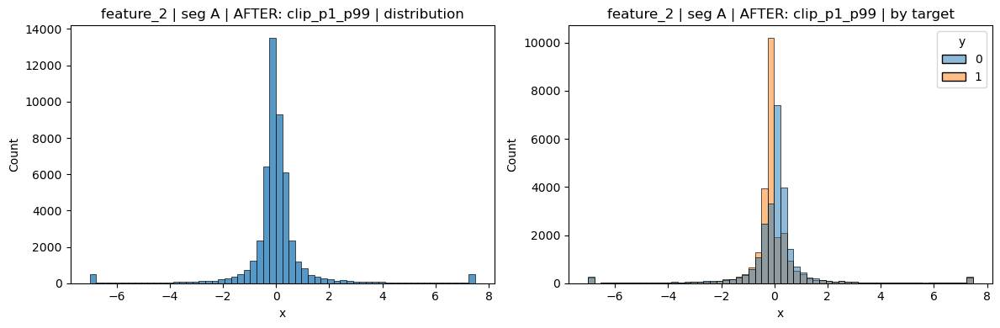

...

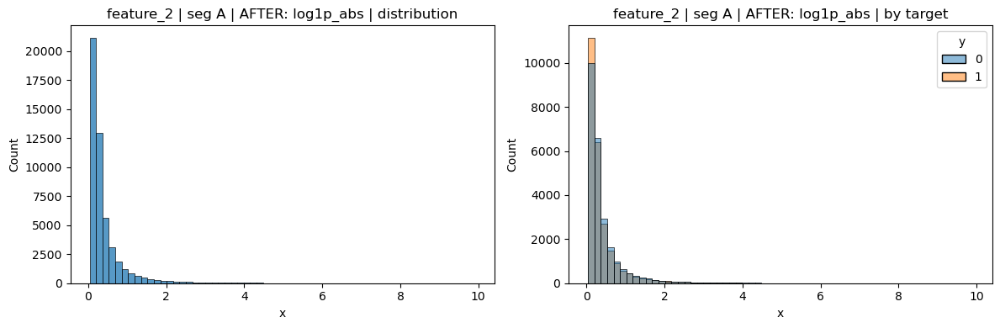

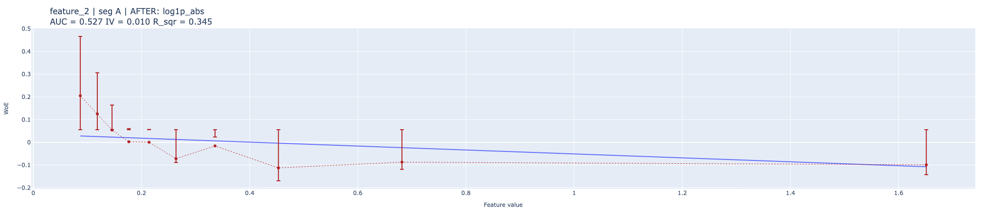

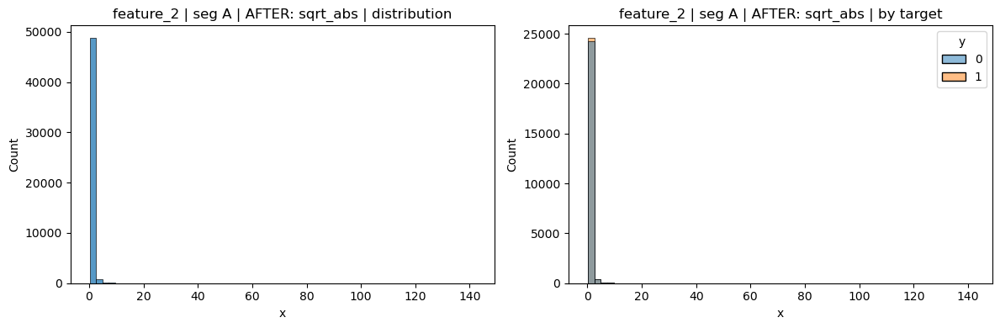

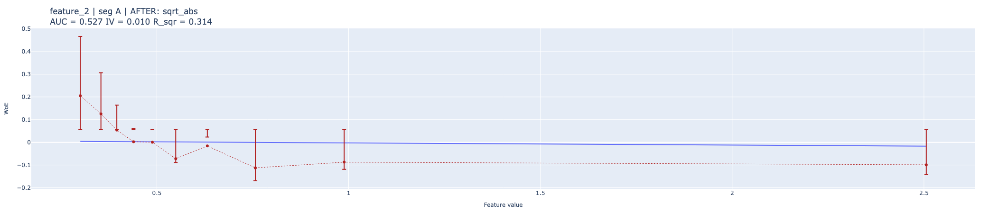

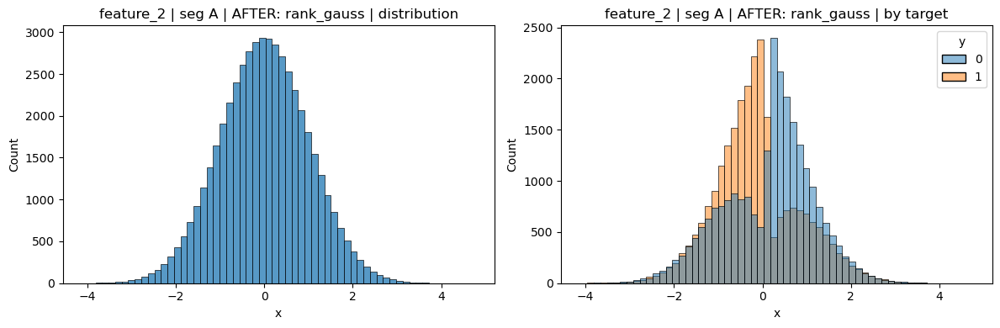

feature_3 | segment A


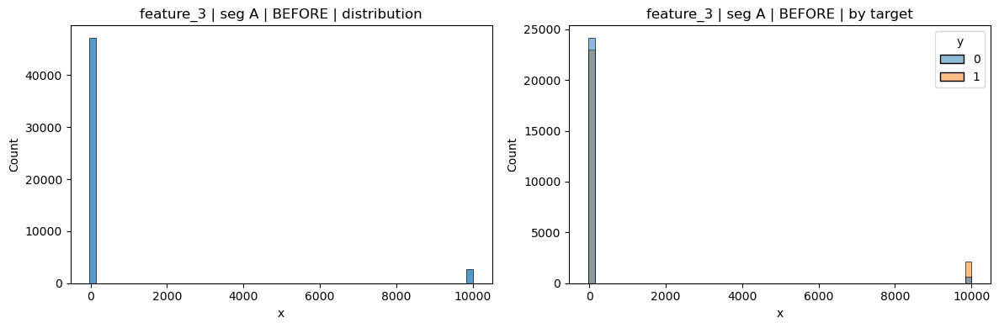

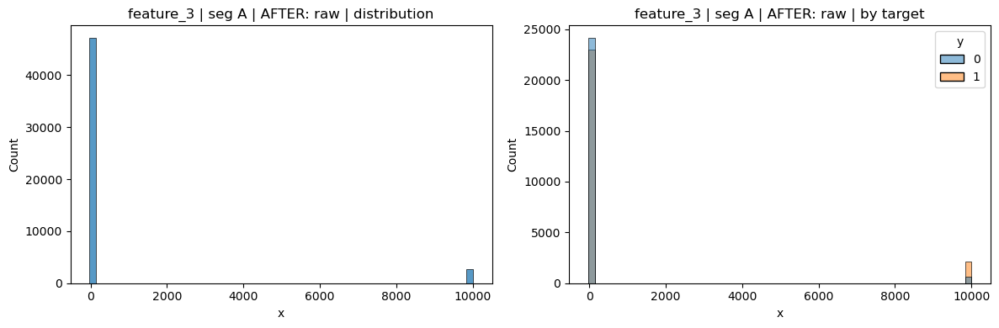

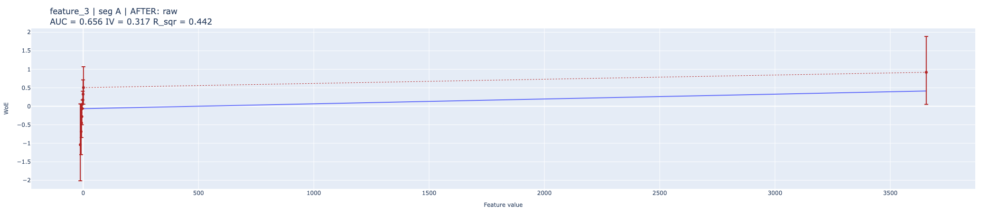

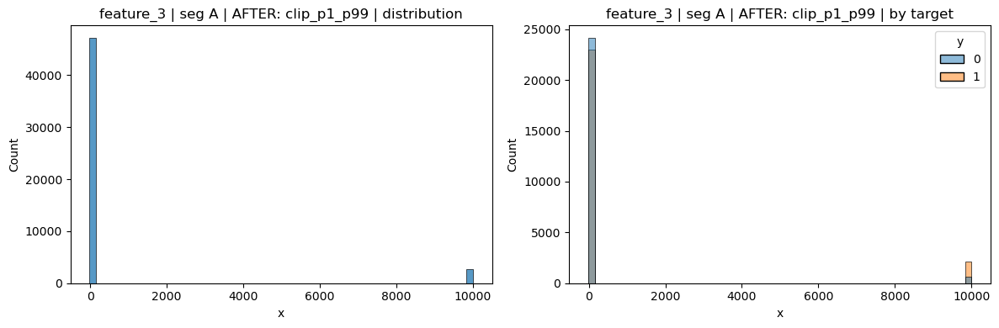

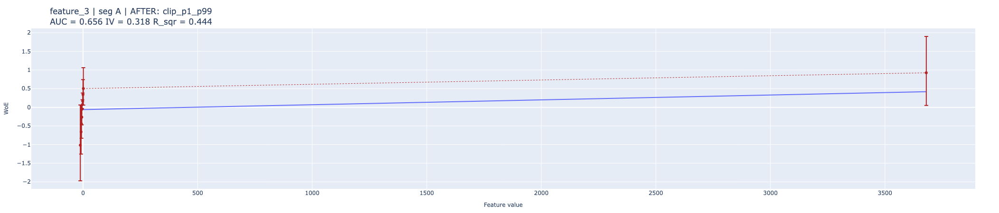

...

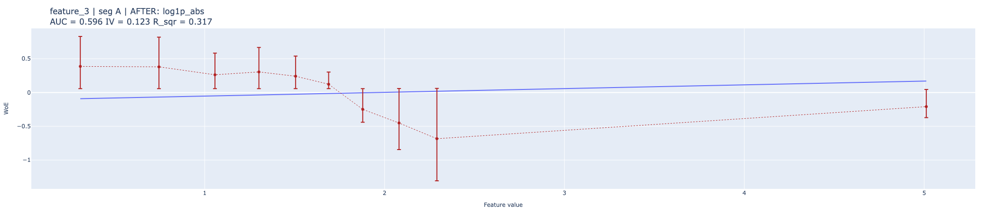

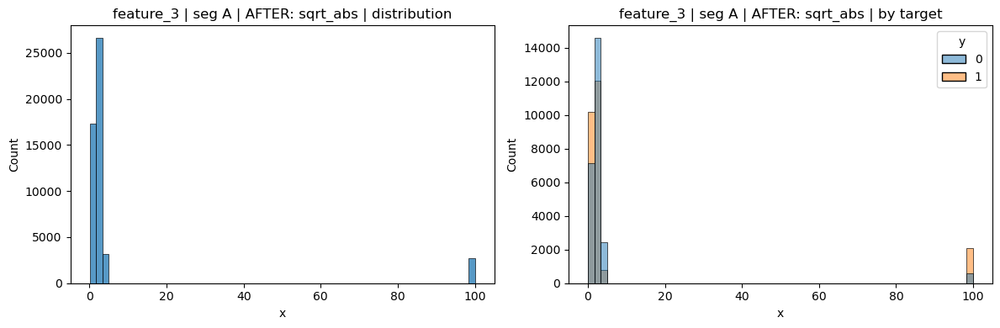

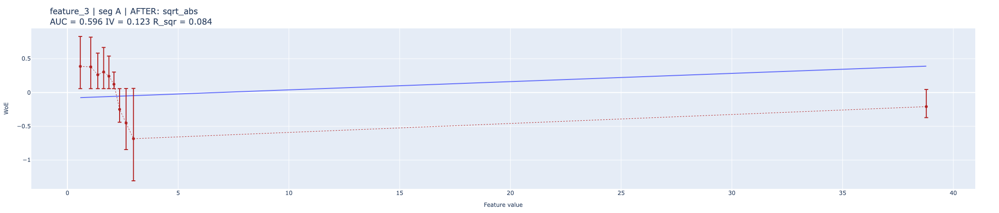

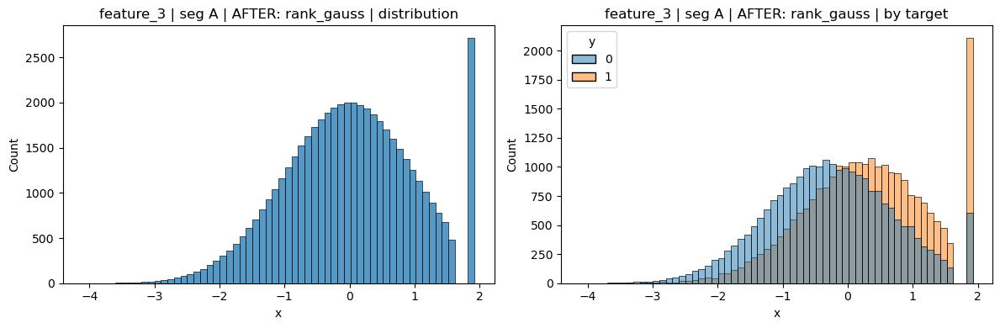

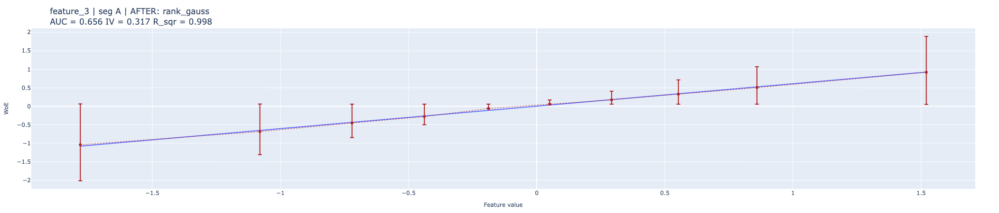

feature_4 | segment A


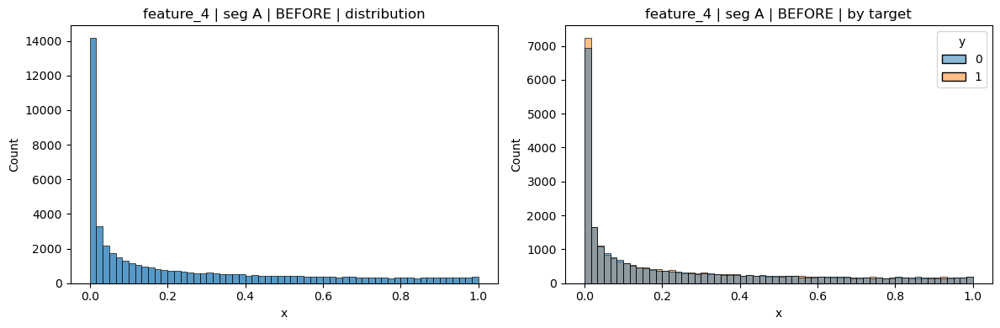

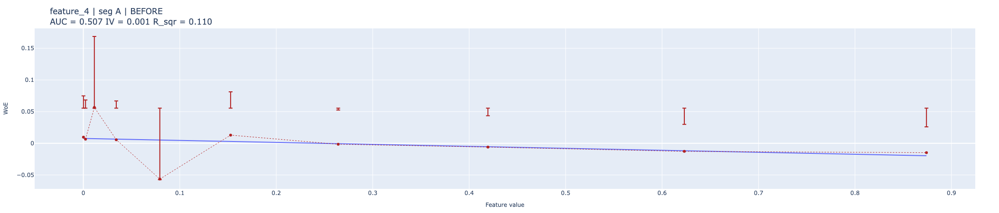

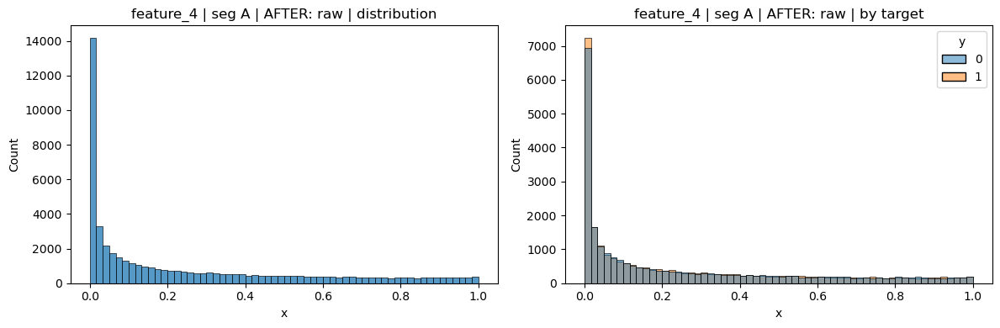

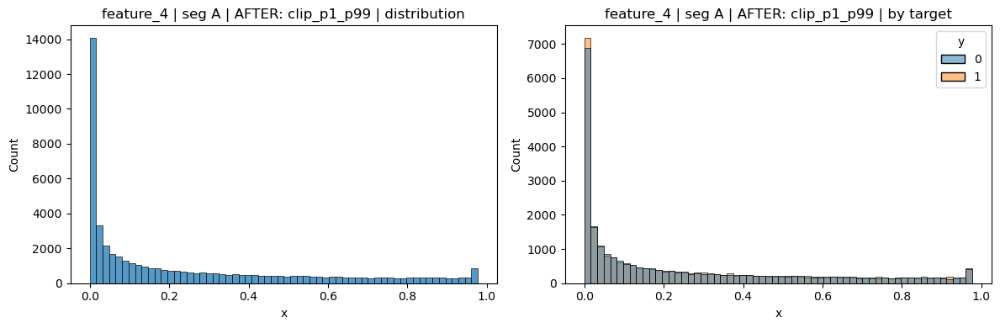

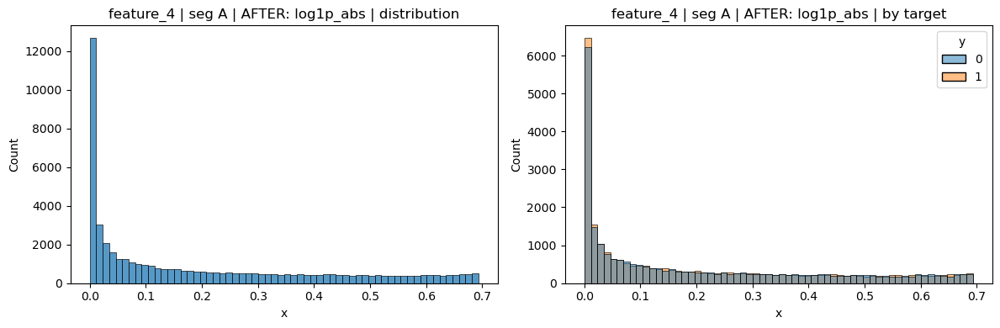

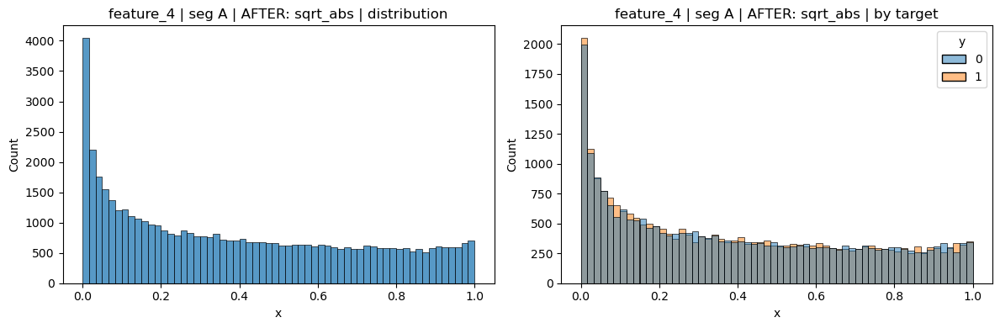

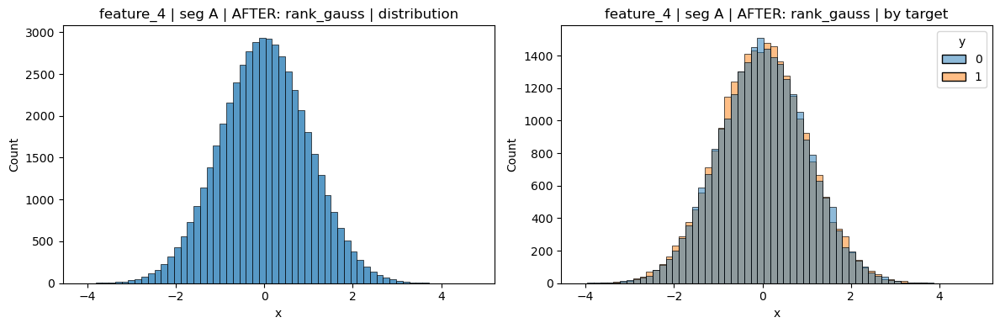

feature_5 | segment A


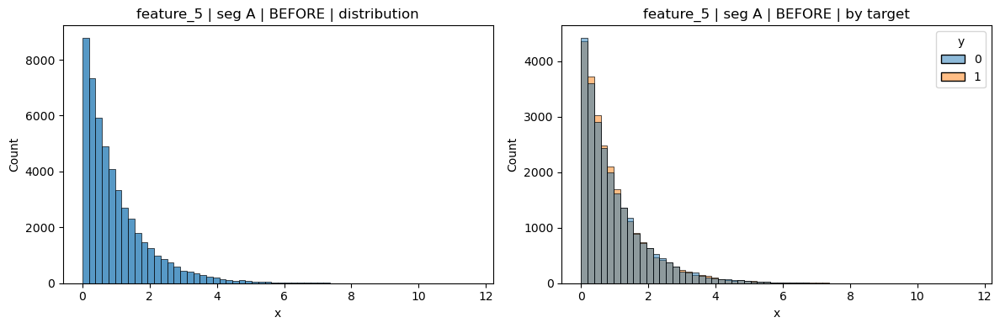

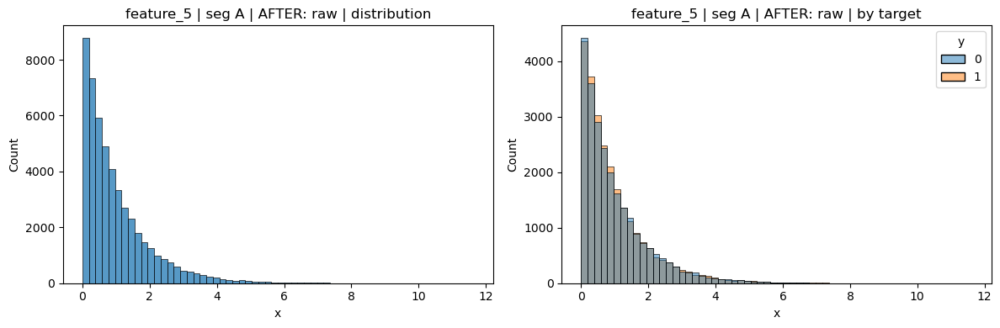

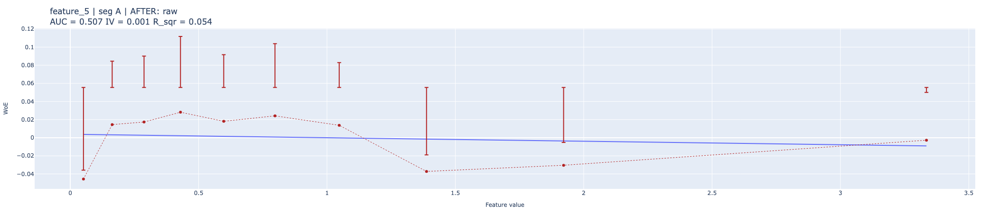

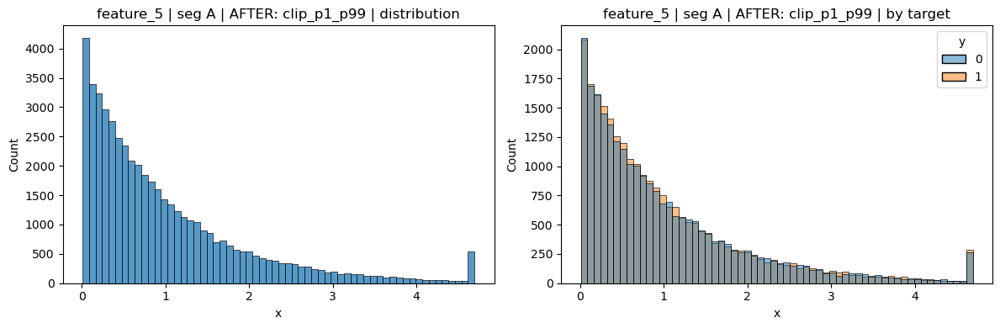

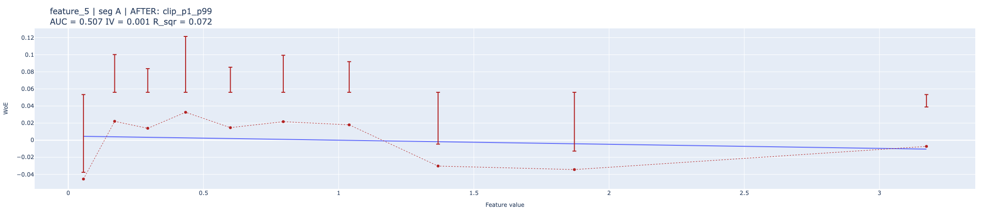

...

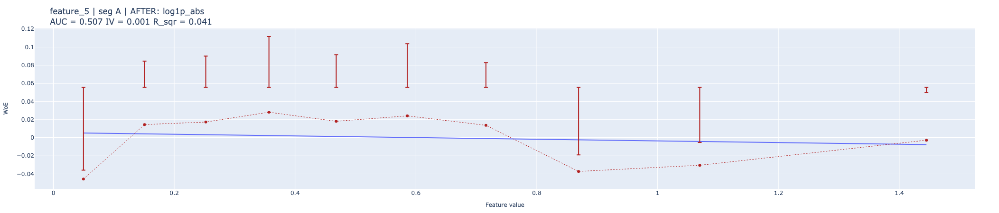

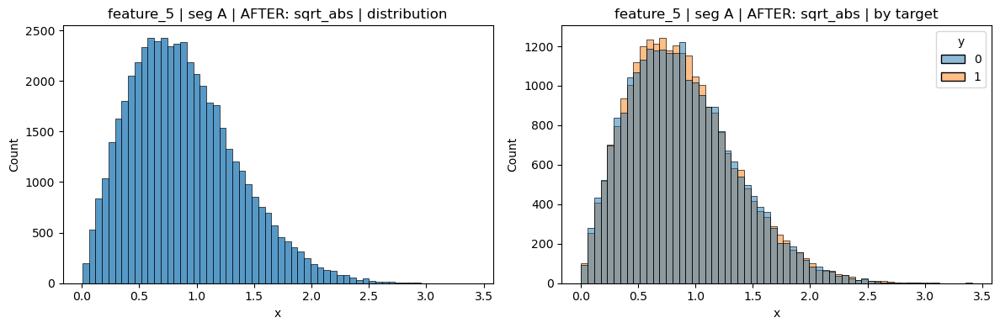

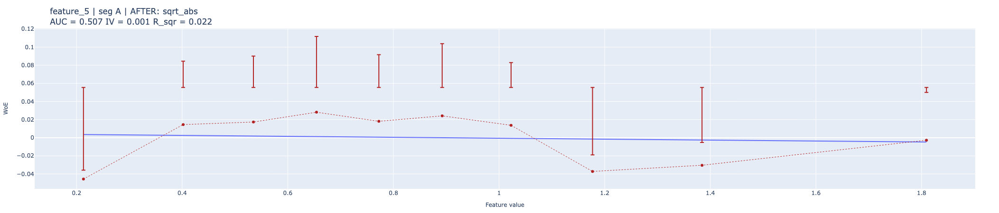

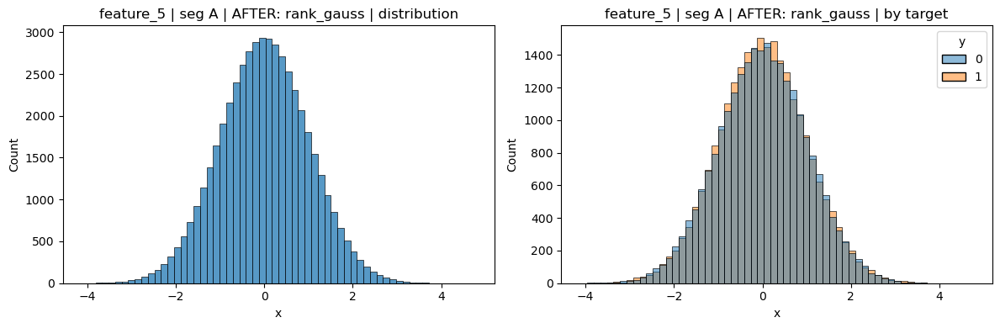

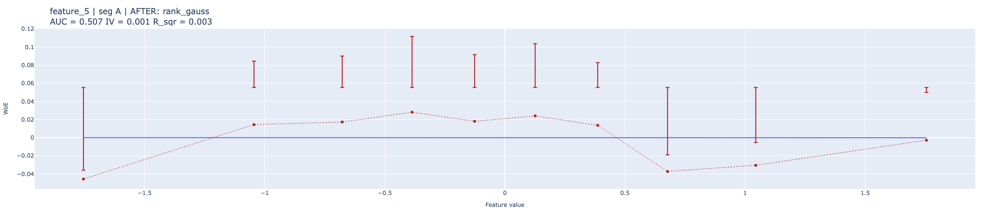

feature_6 | segment A


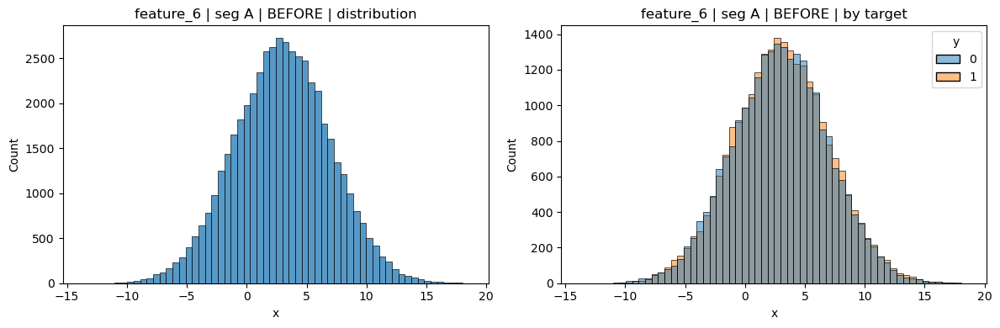

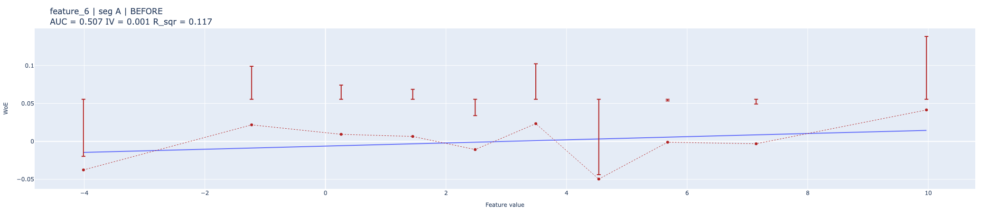

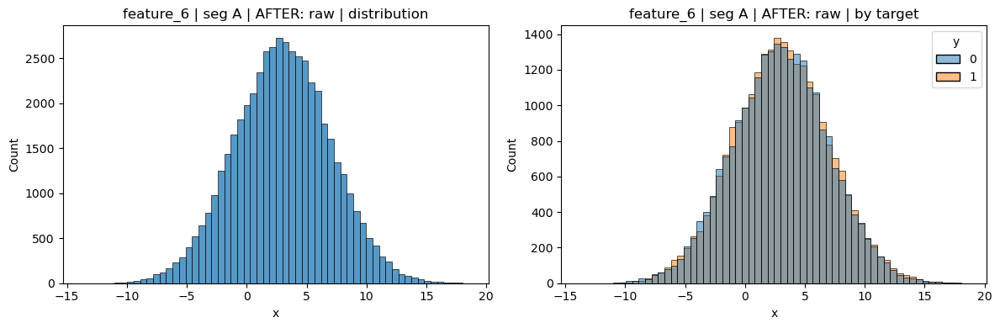

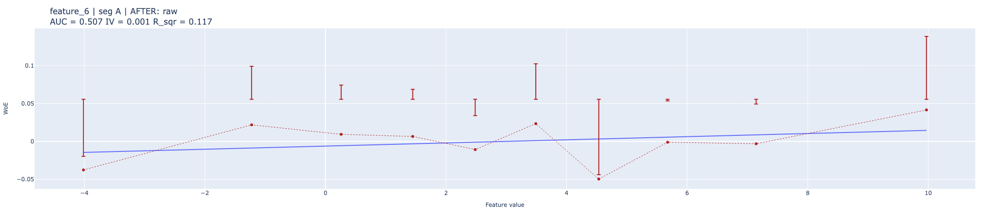

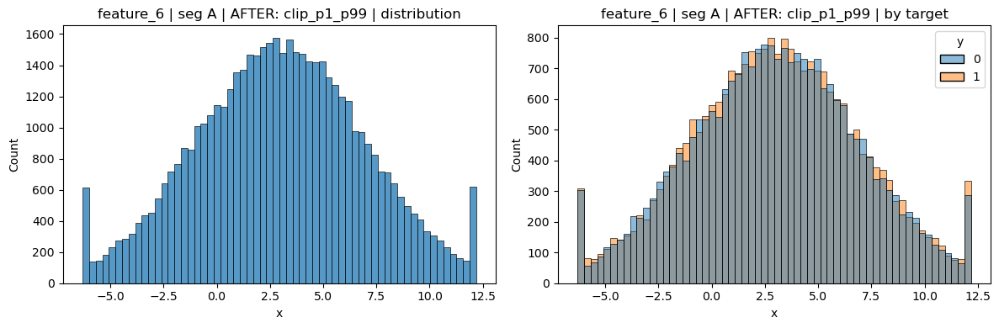

...

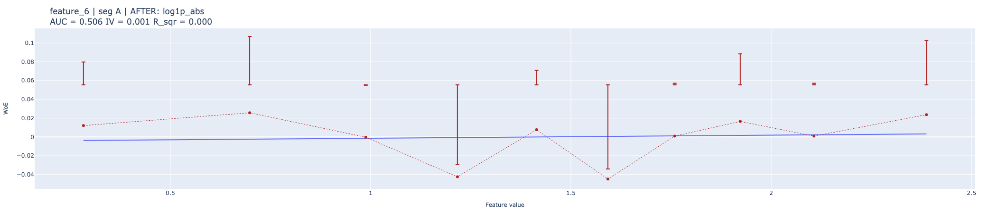

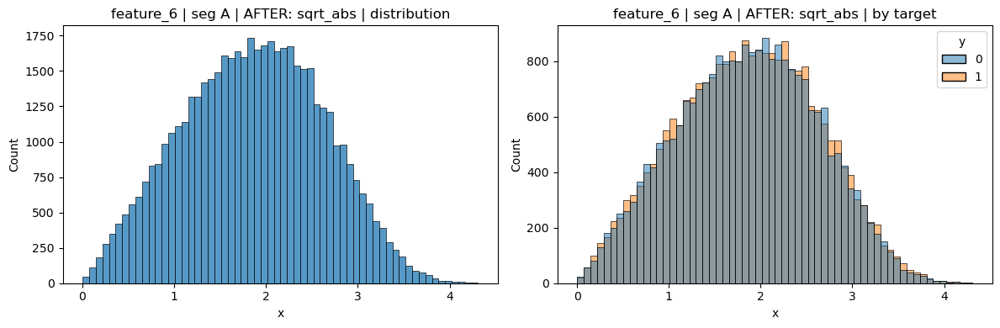

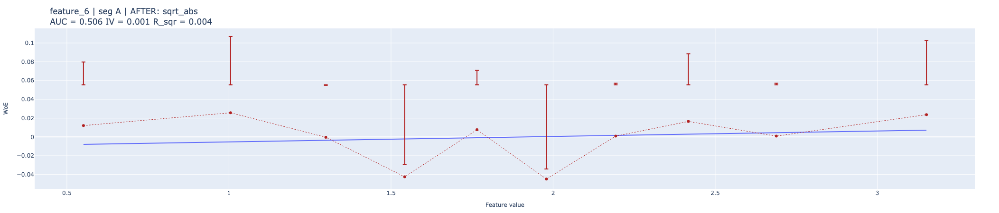

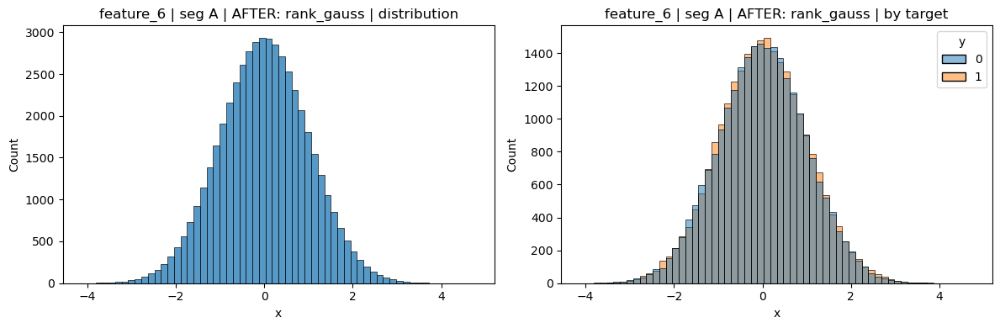

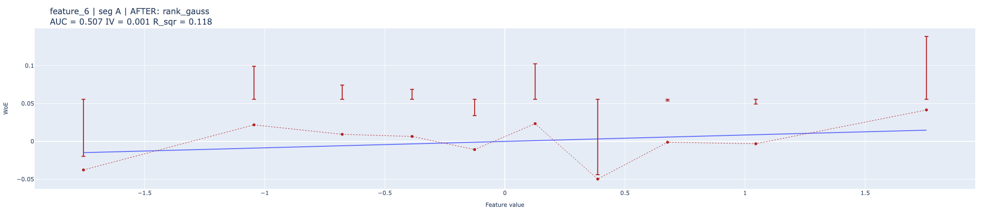

feature_7 | segment A


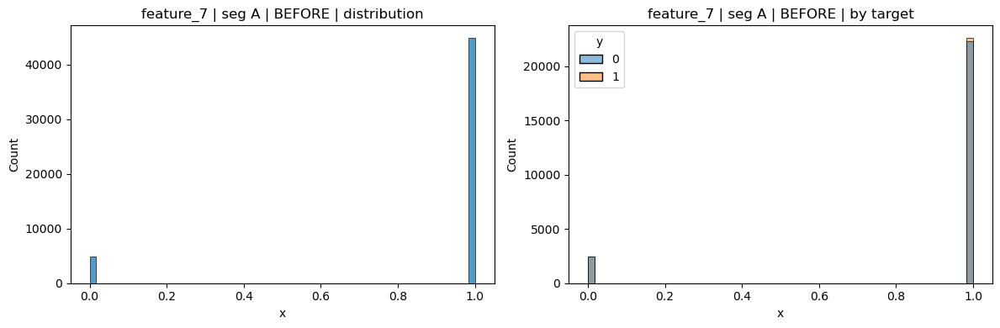

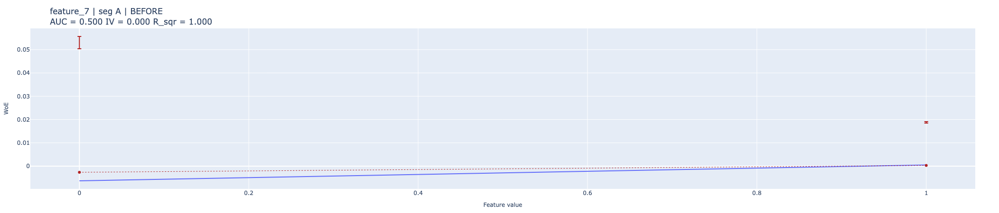

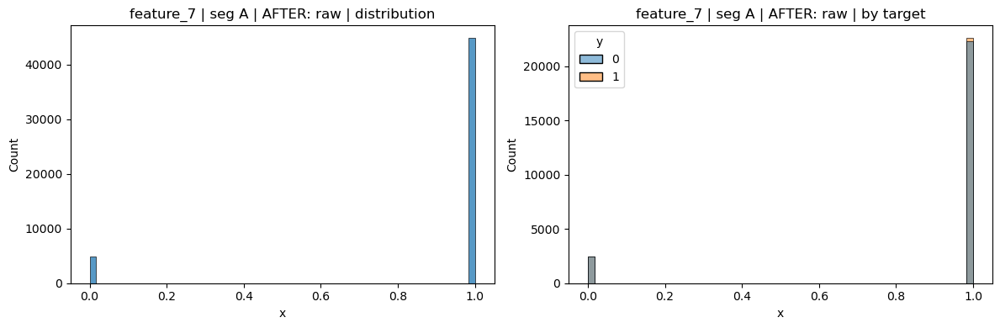

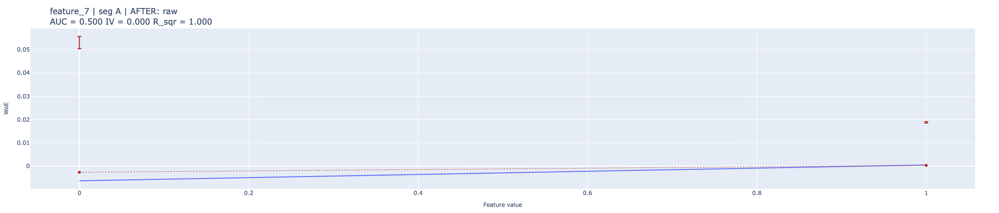

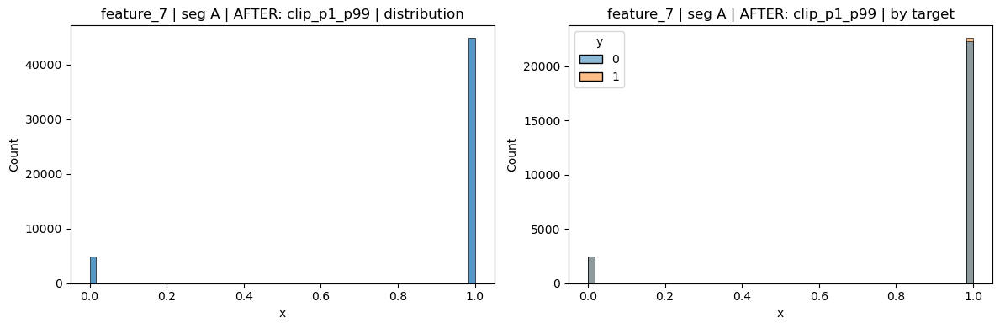

...

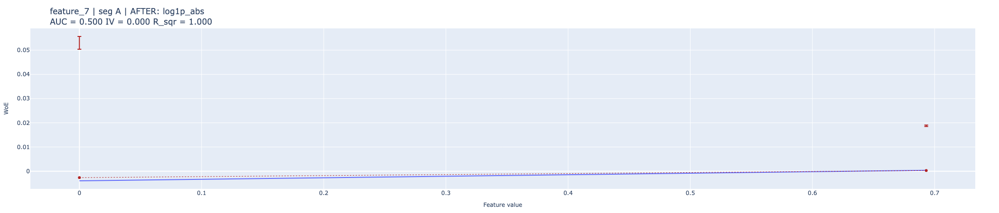

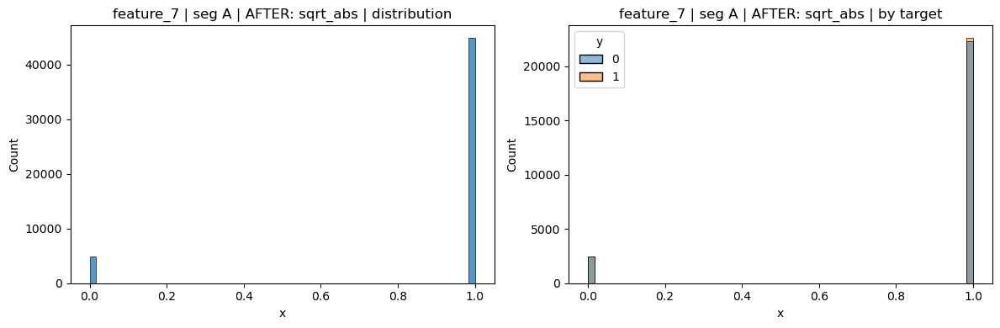

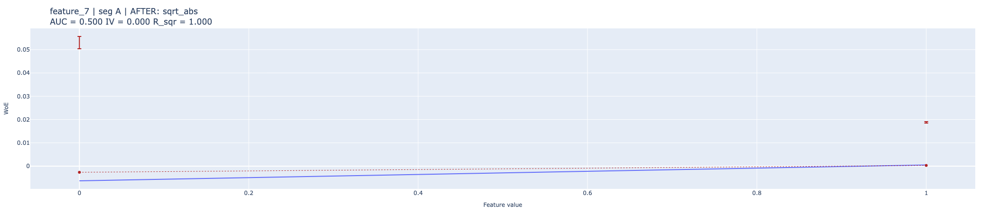

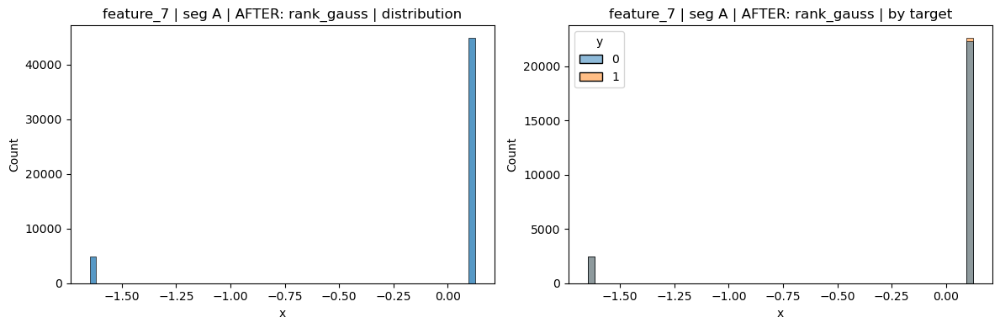

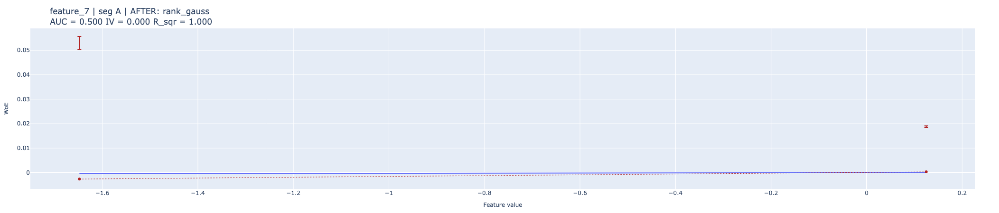

feature_8 | segment A


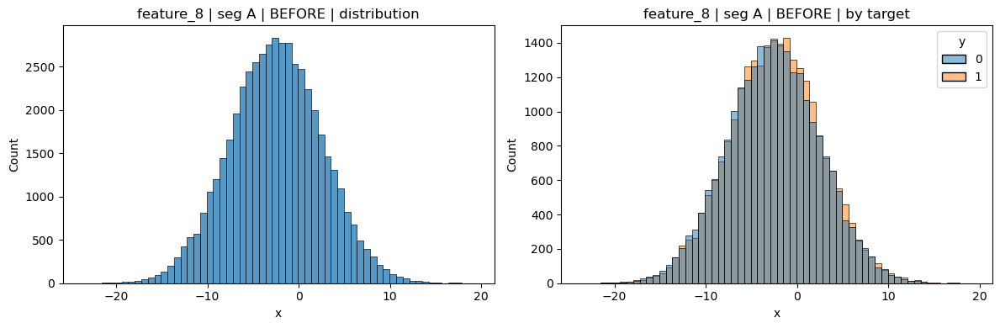

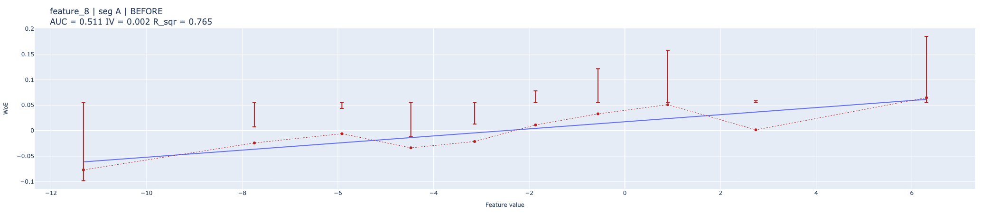

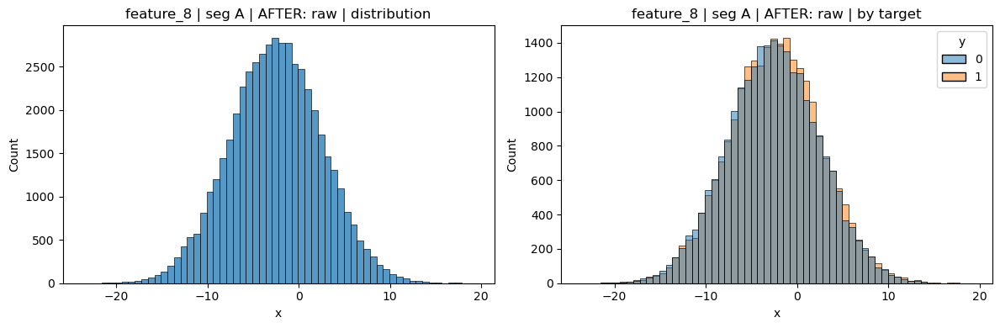

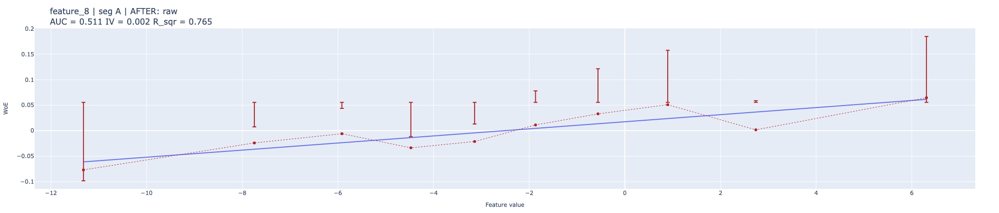

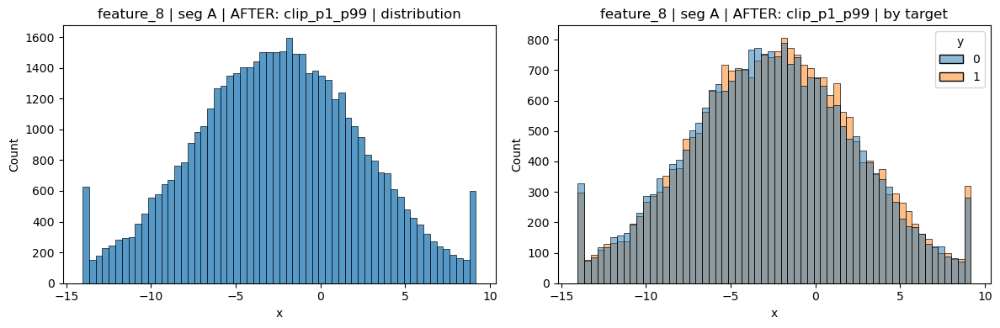

...

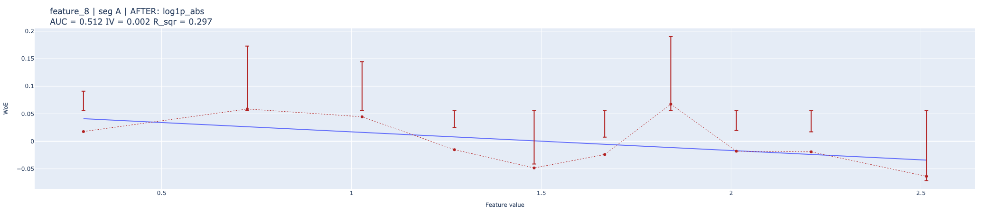

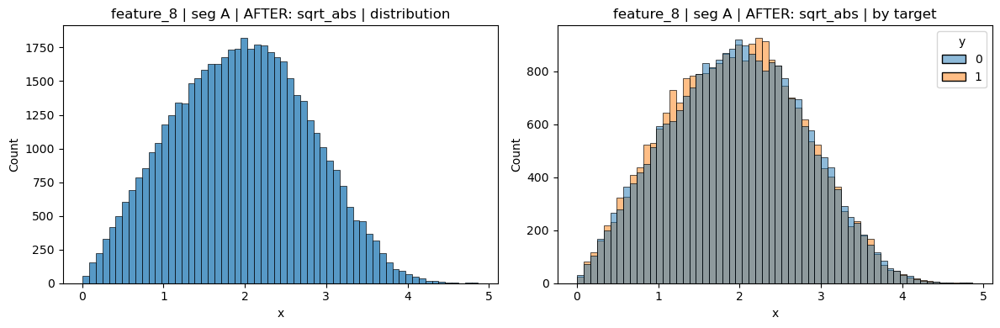

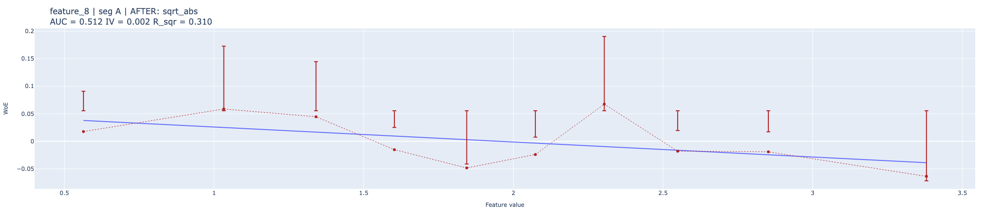

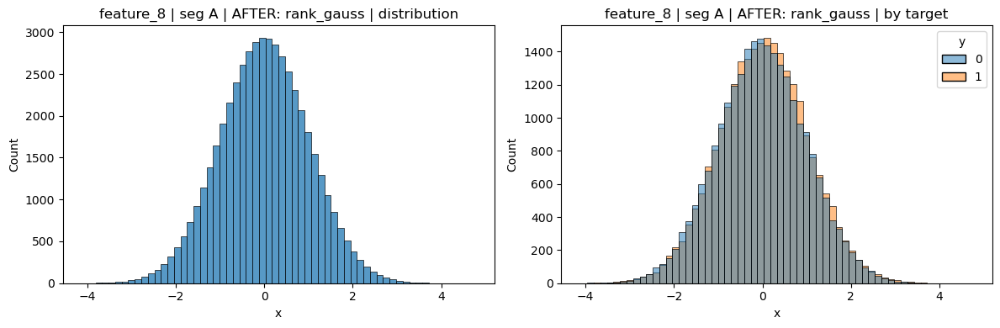

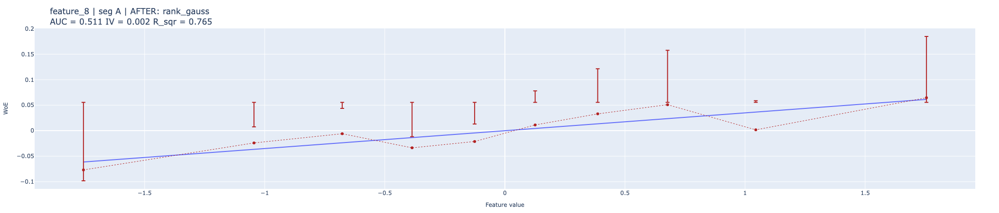

feature_9 | segment A


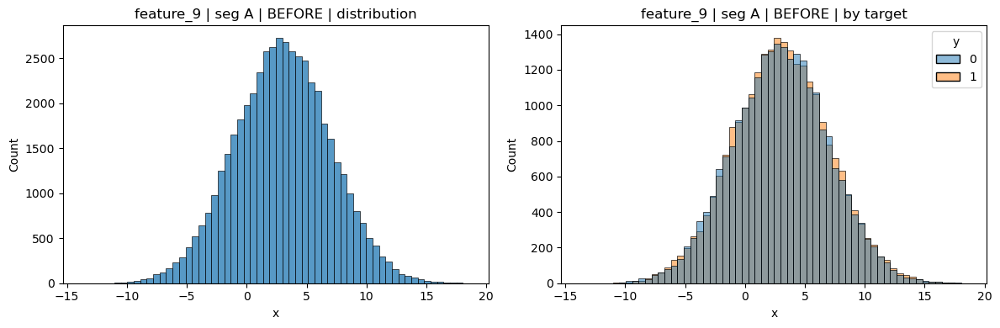

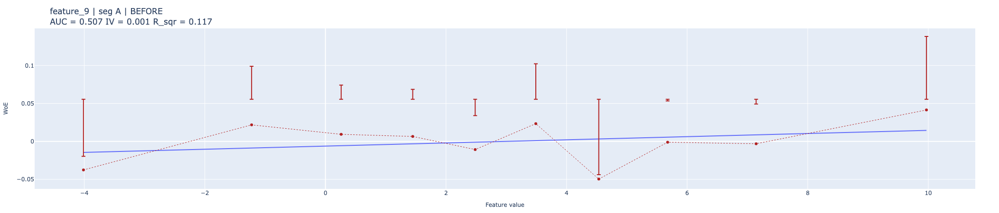

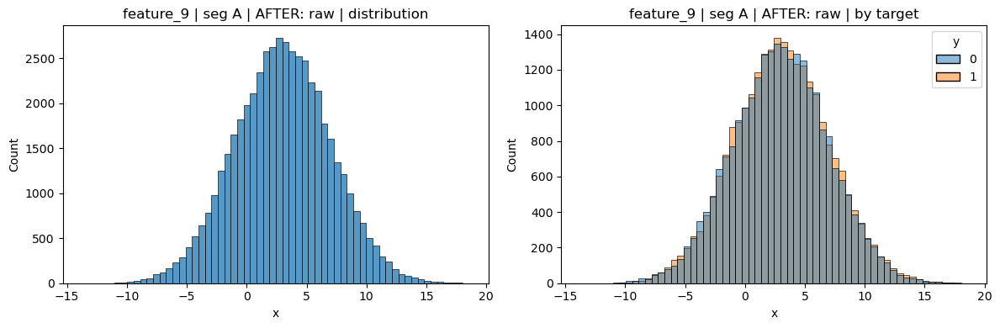

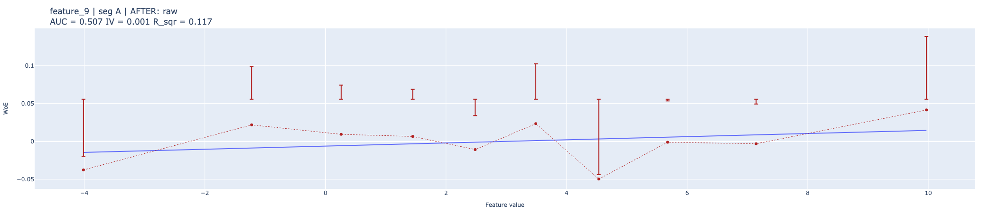

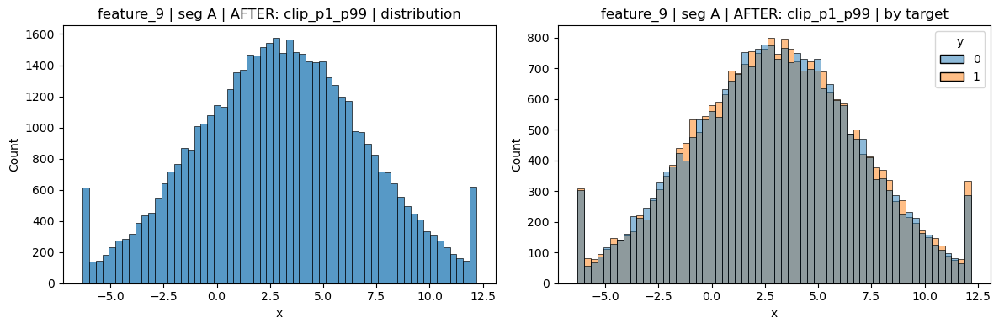

...

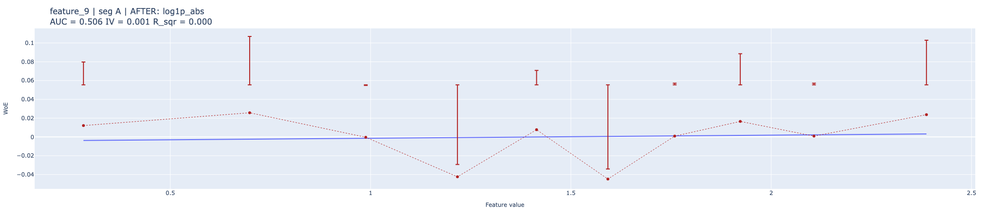

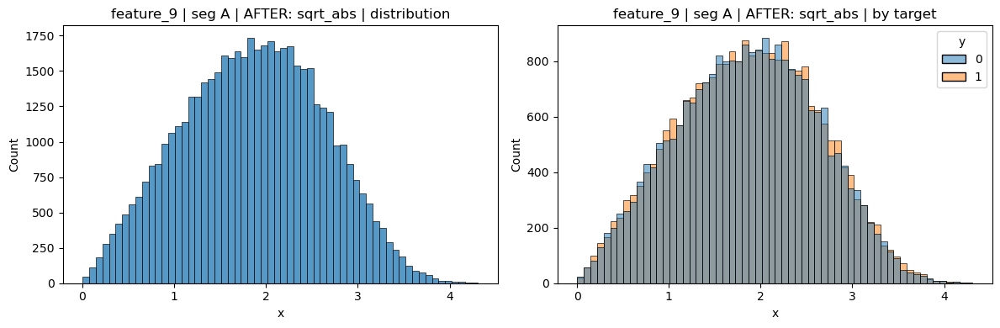

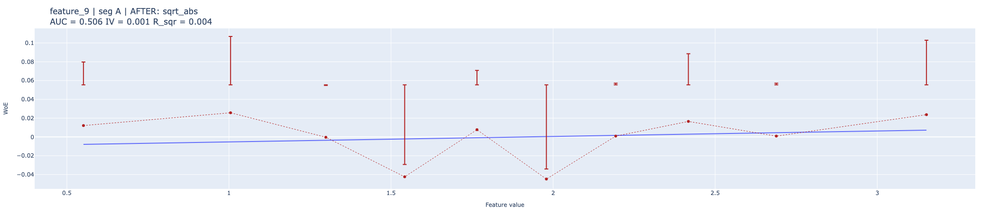

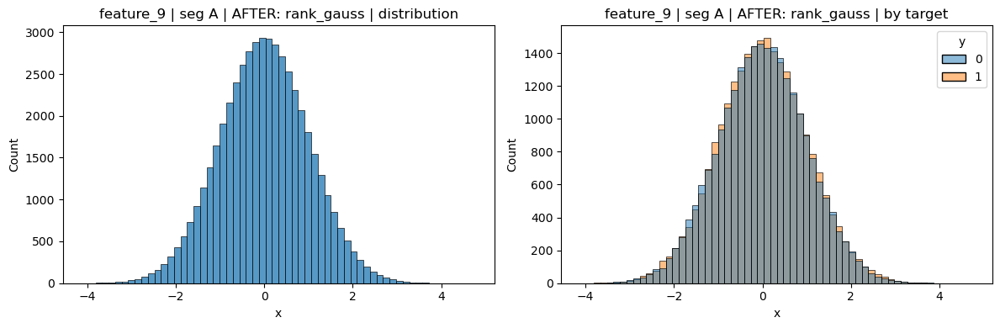

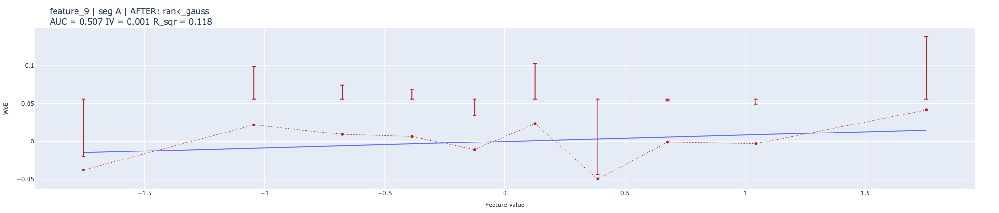

feature_10 | segment A


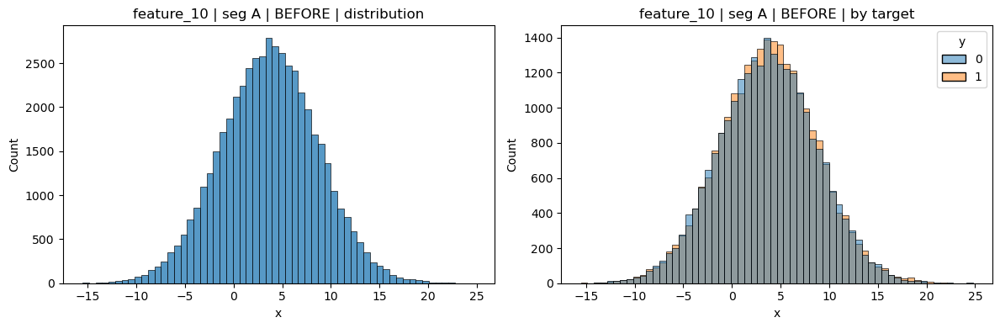

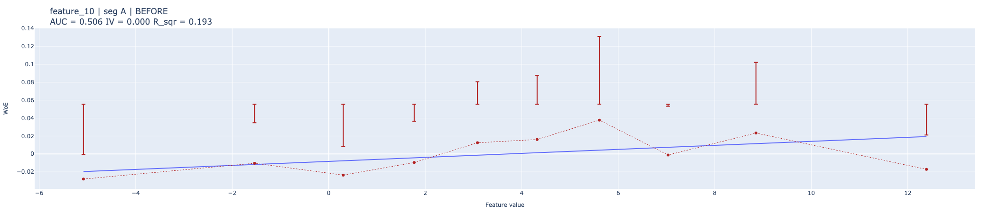

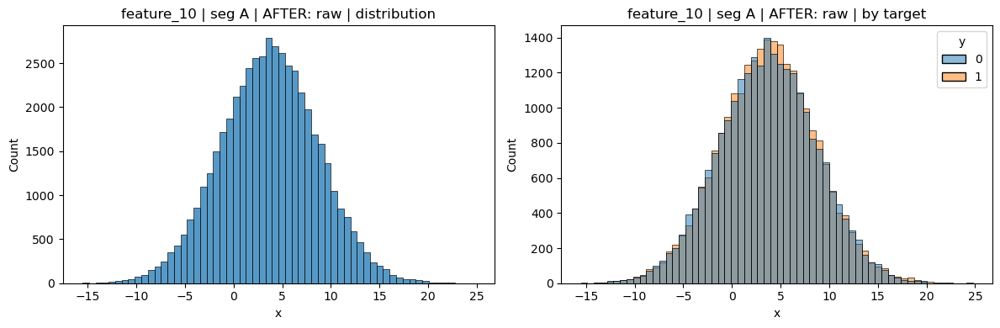

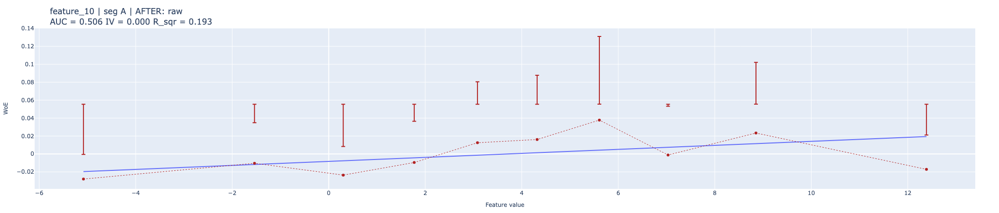

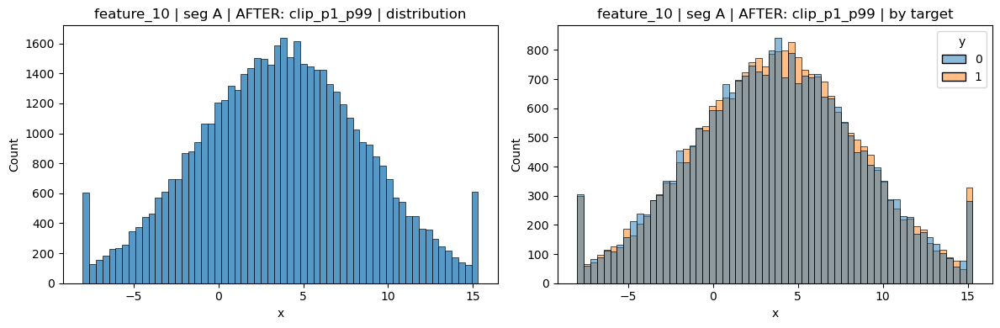

...

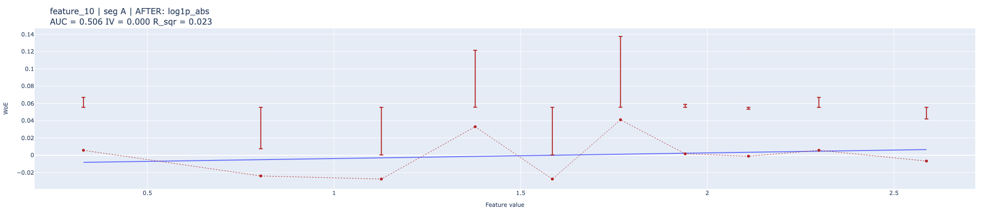

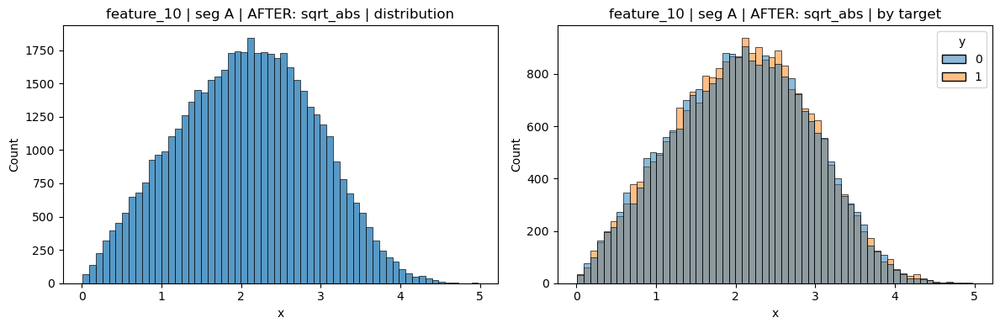

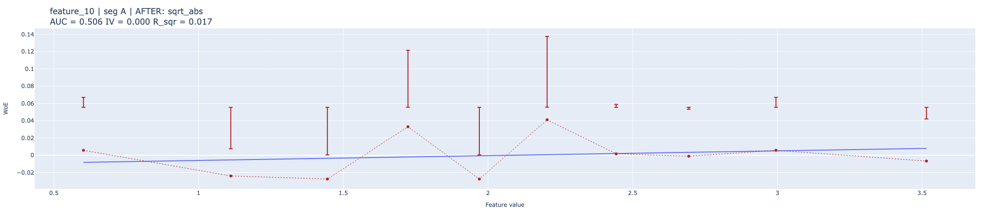

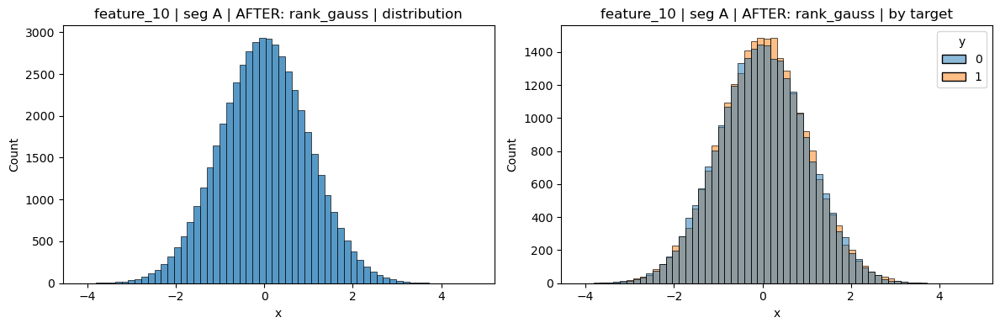

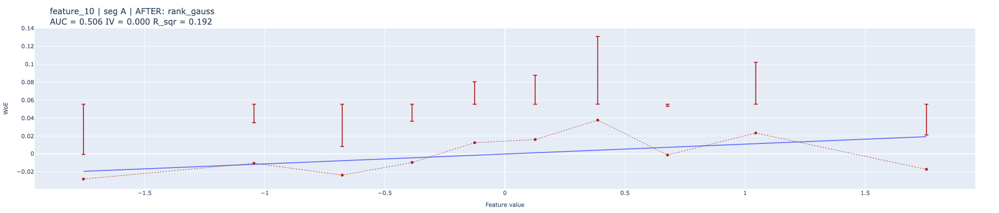

feature_11 | segment A


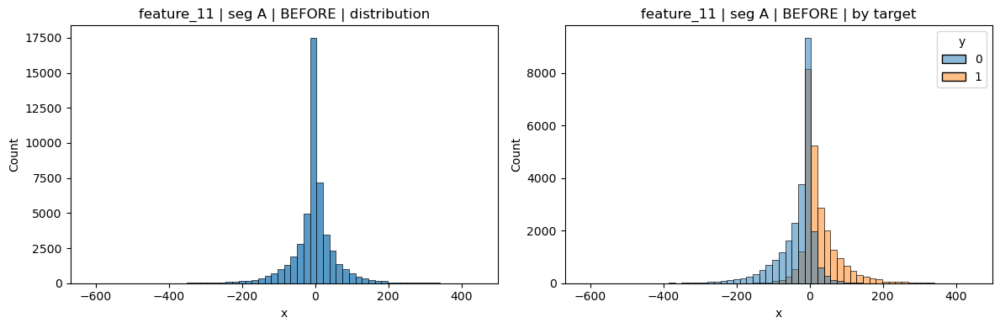

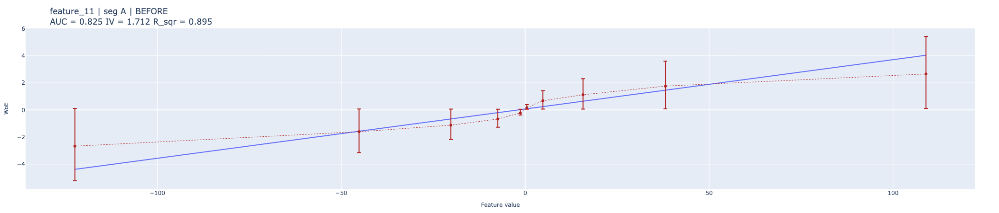

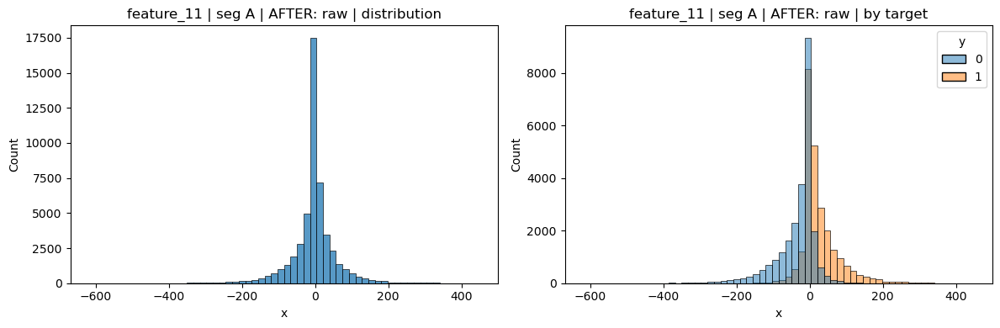

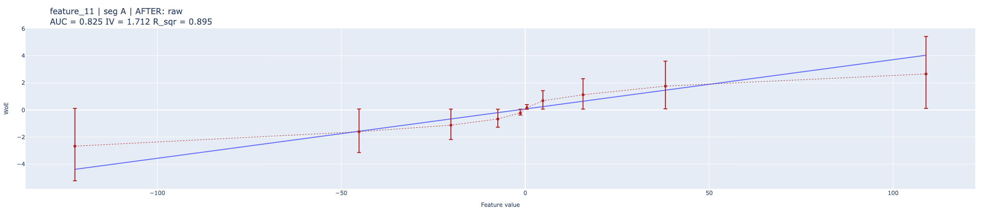

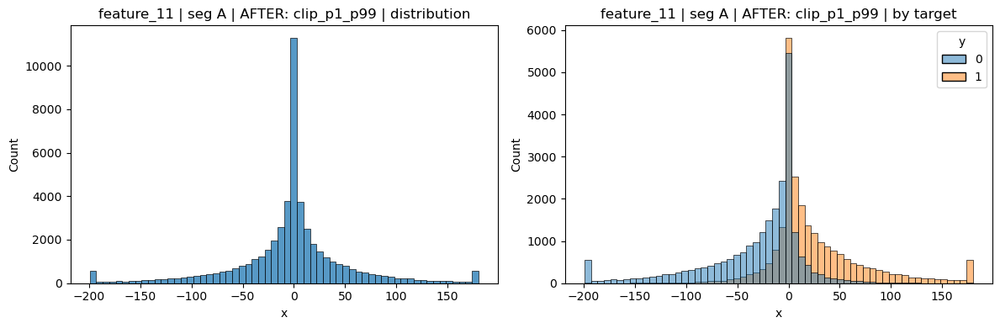

...

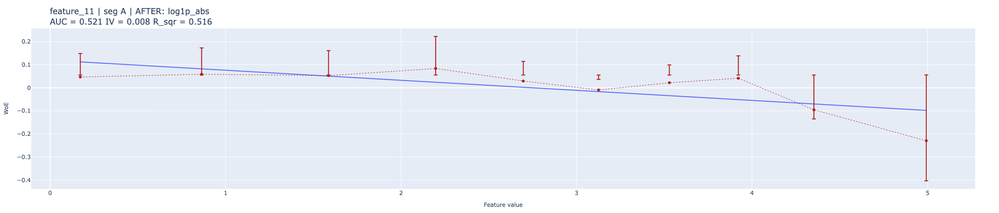

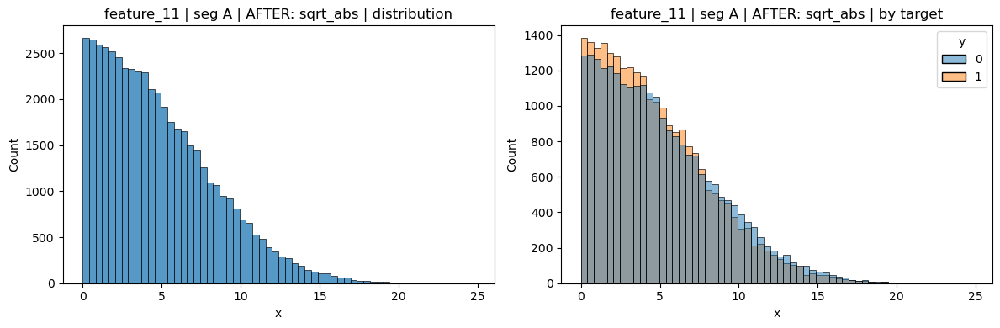

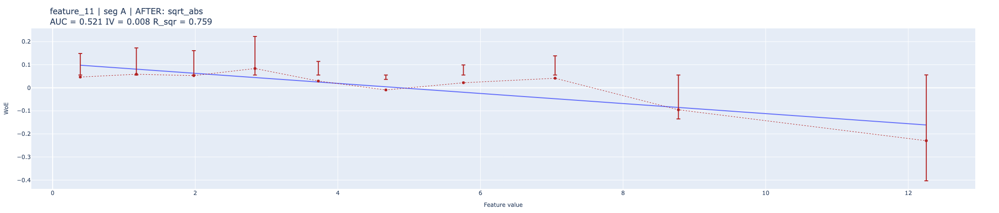

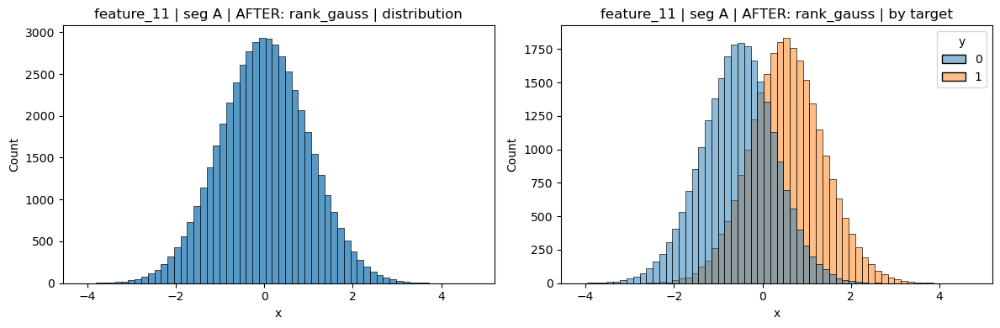

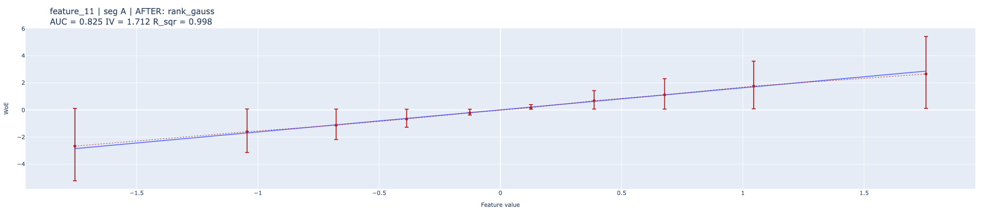

feature_12 | segment A


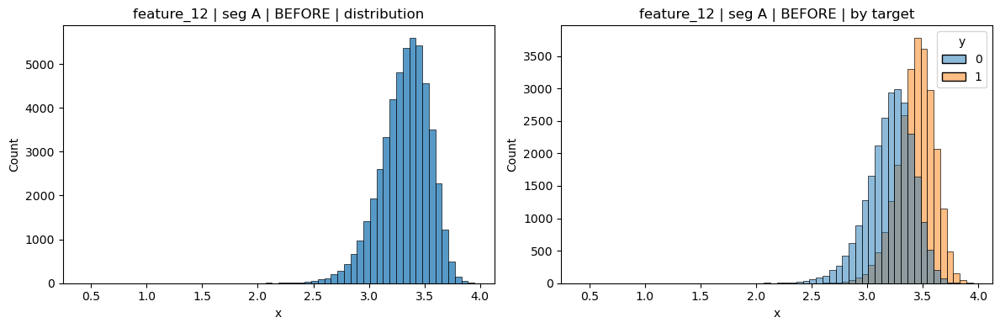

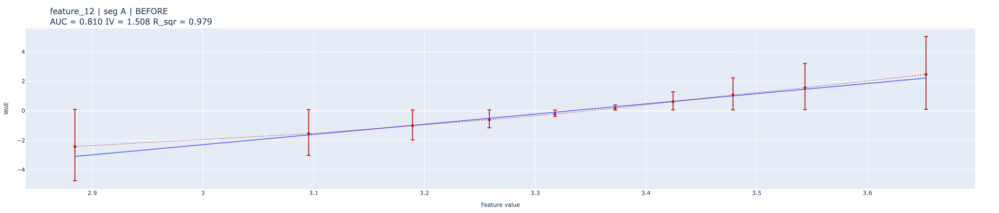

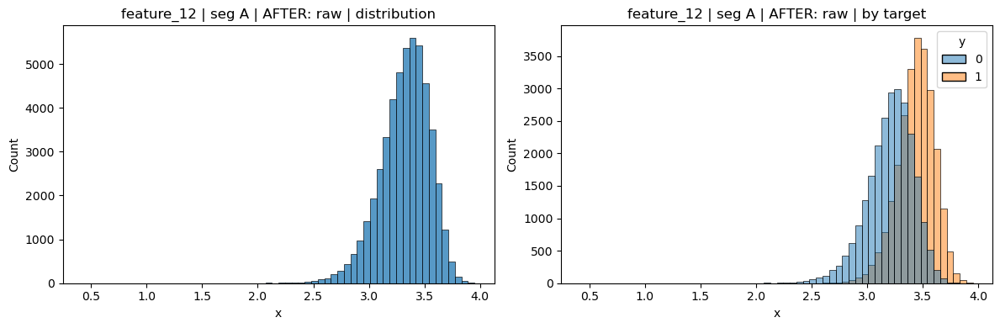

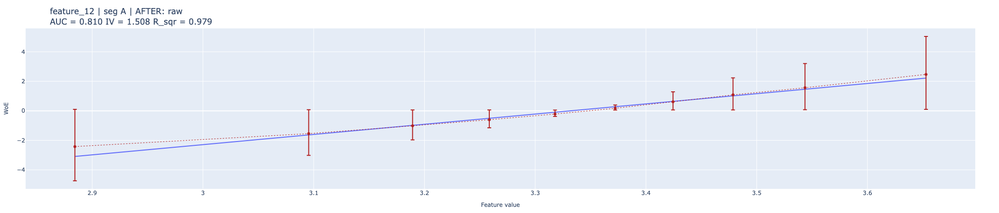

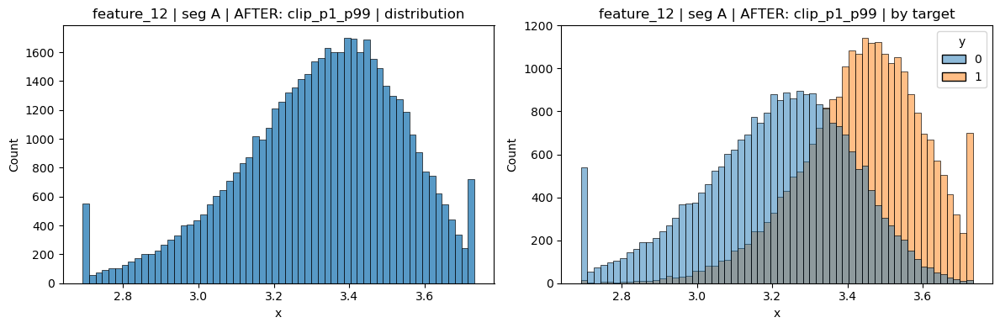

...

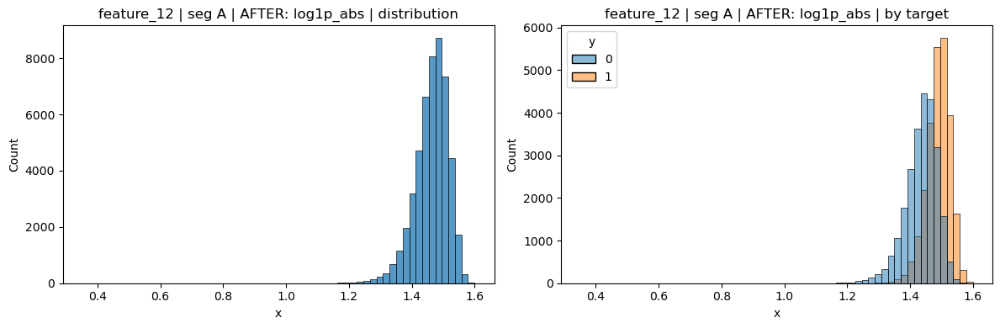

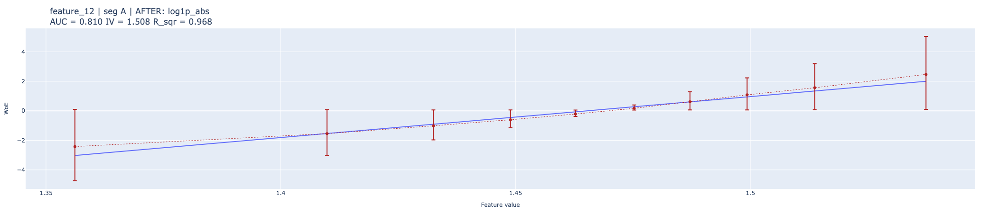

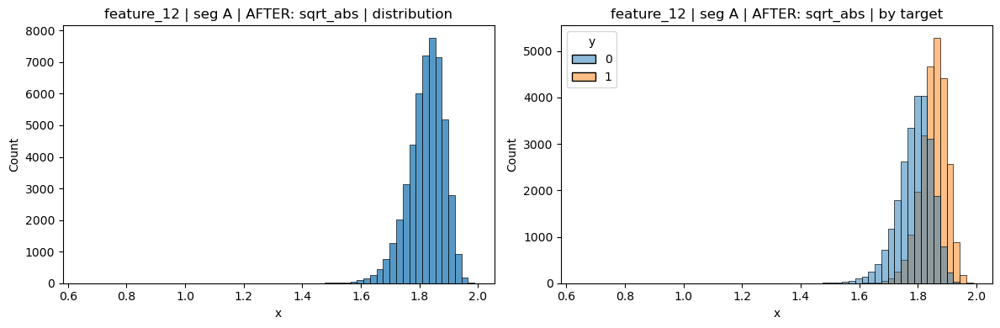

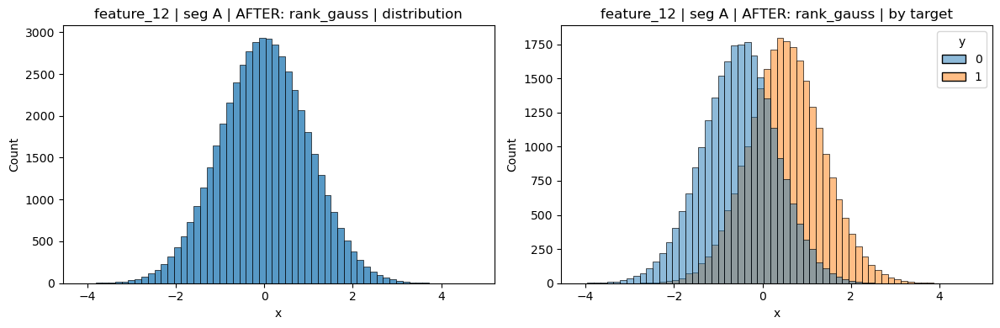

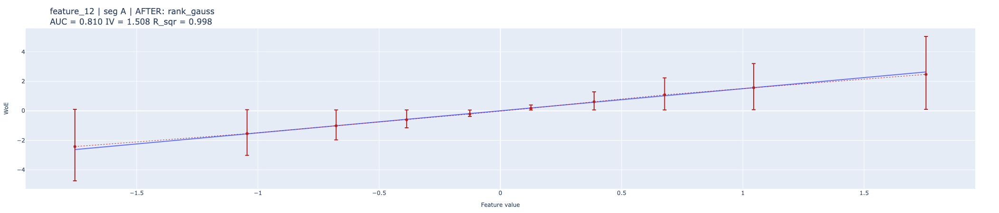

feature_13 | segment A


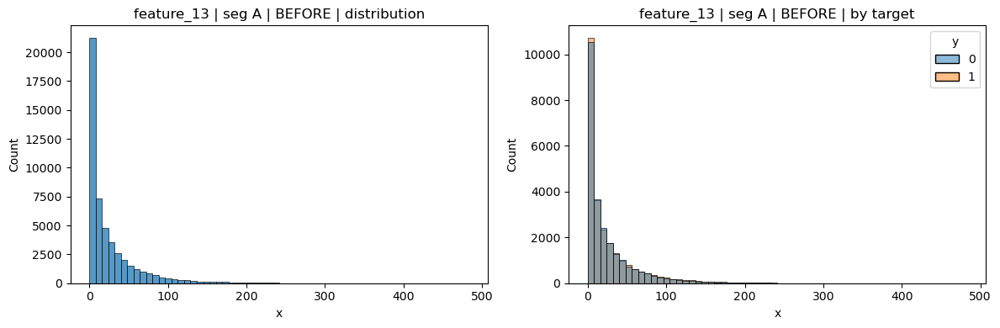

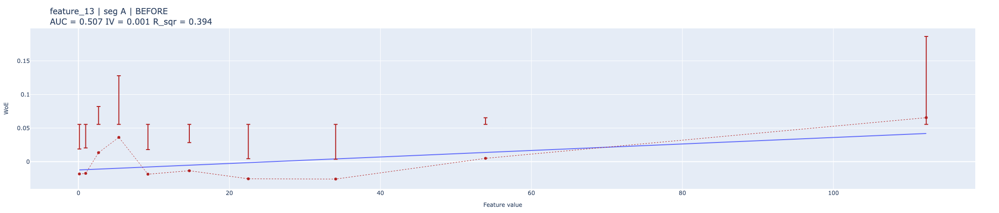

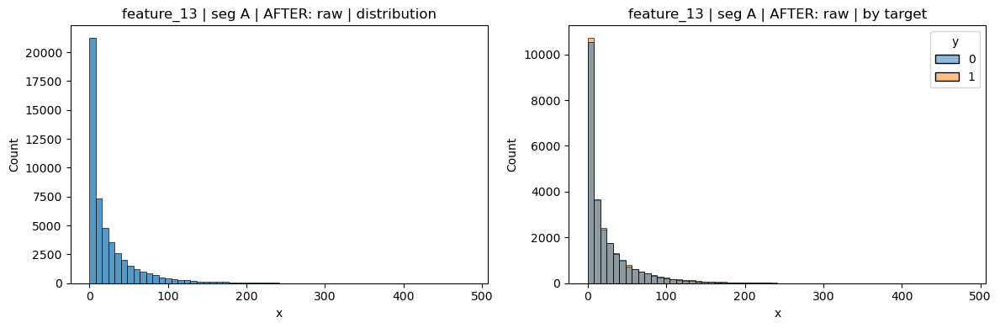

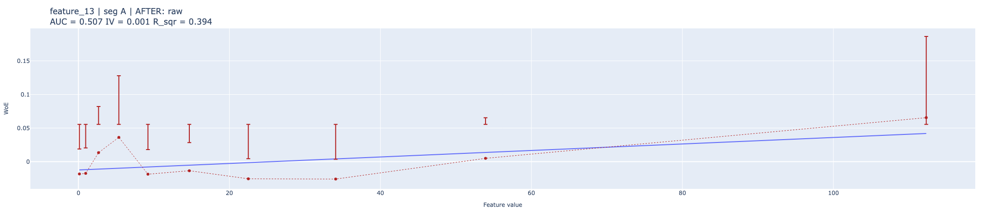

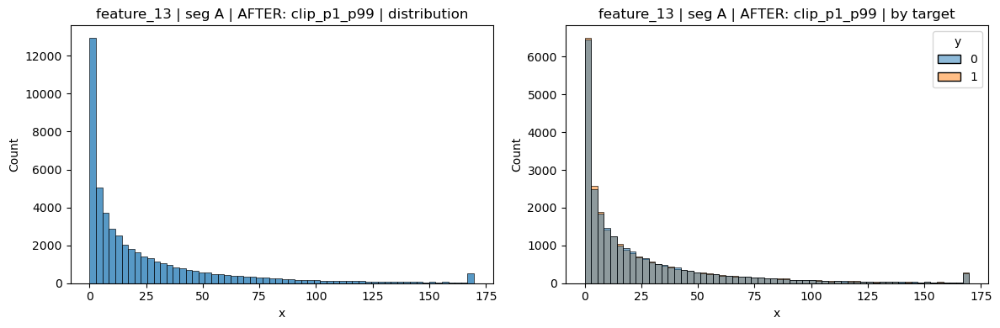

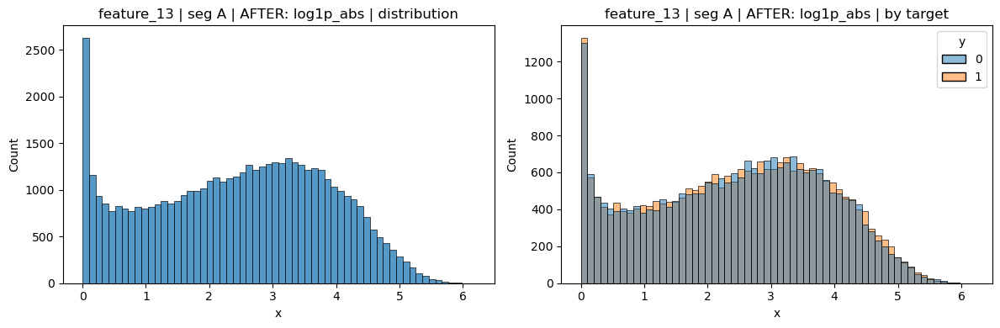

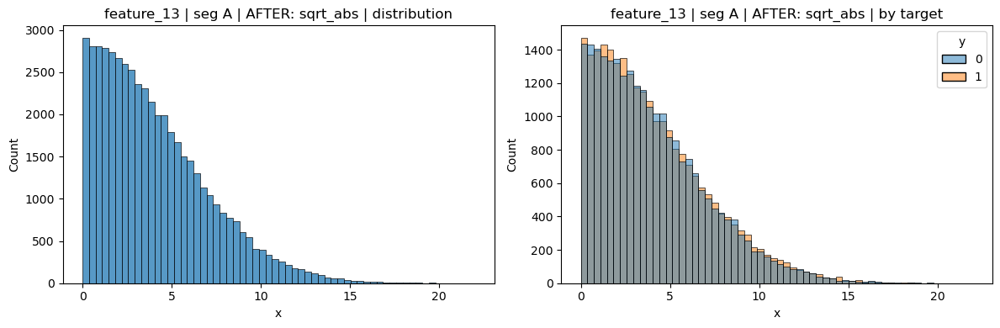

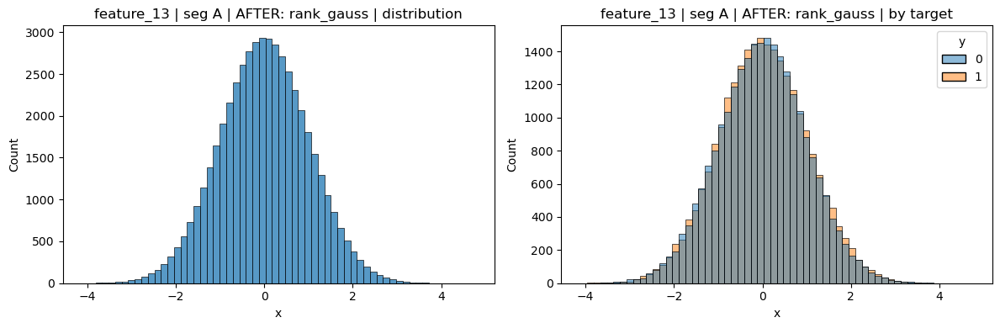

feature_14 | segment A


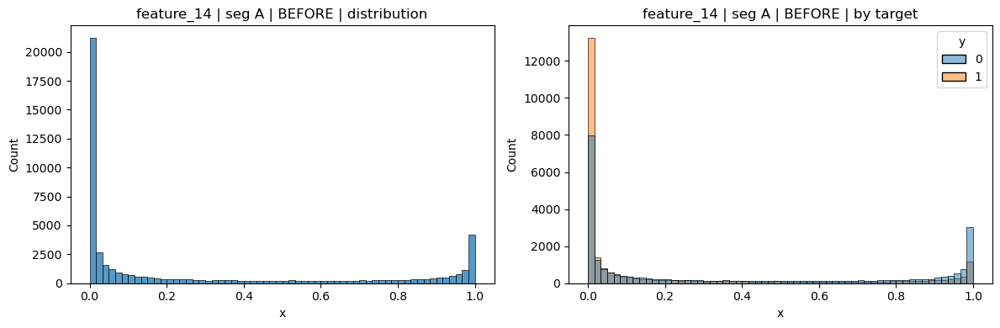

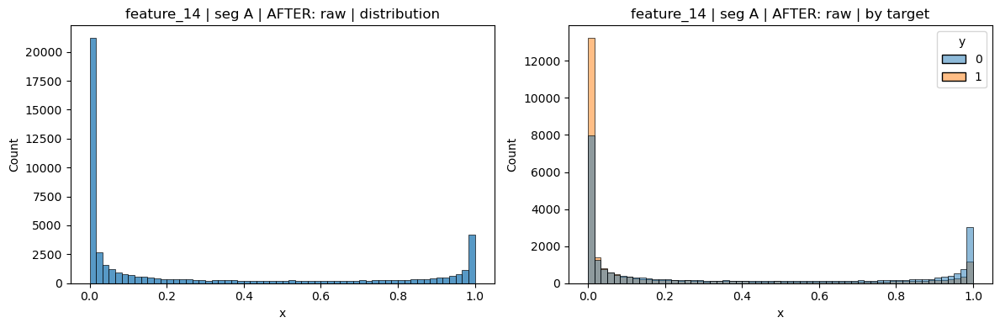

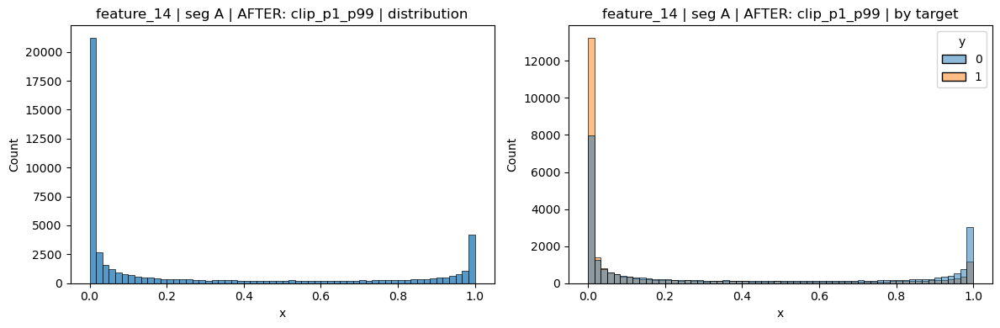

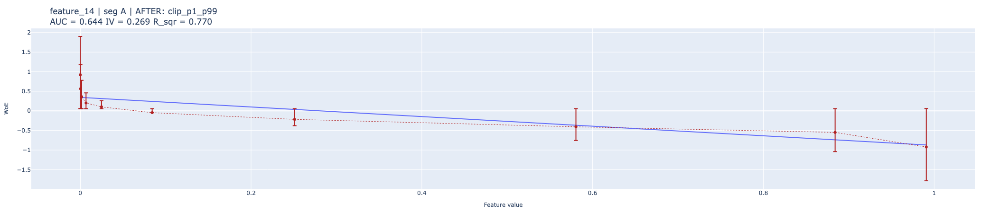

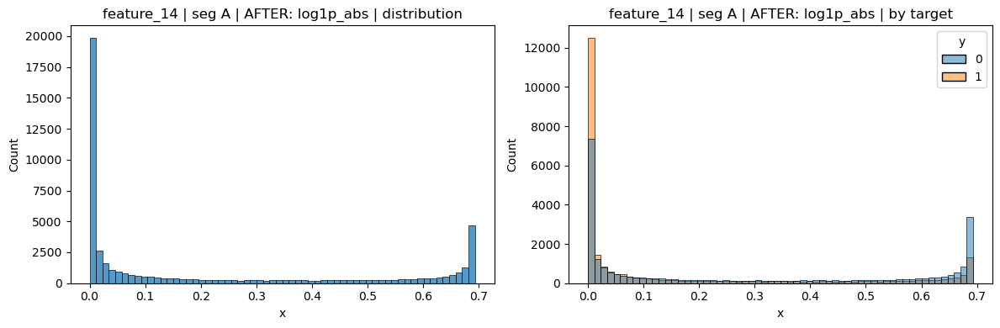

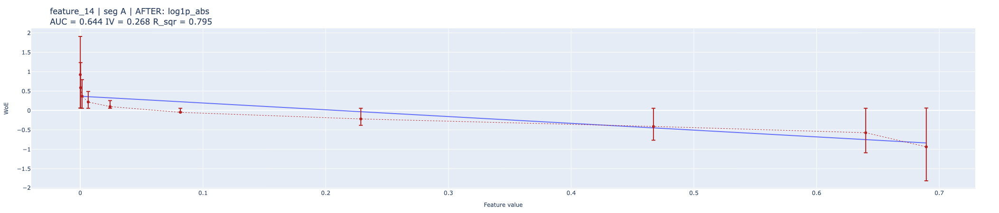

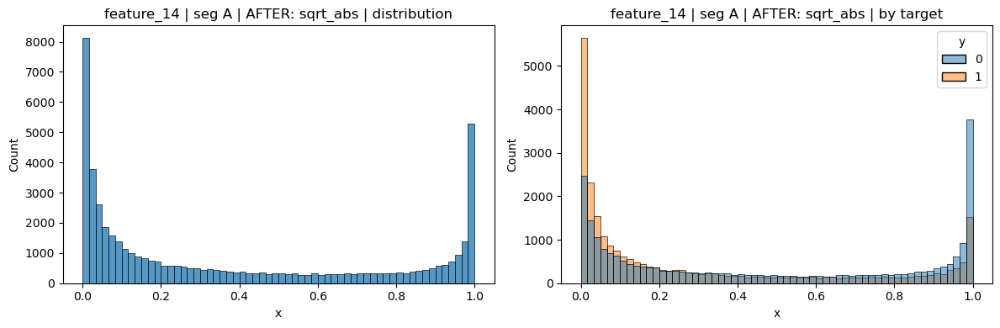

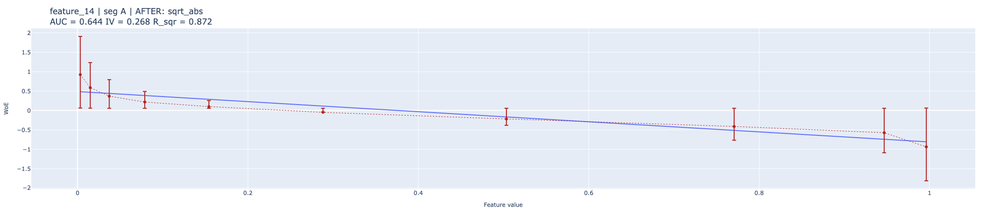

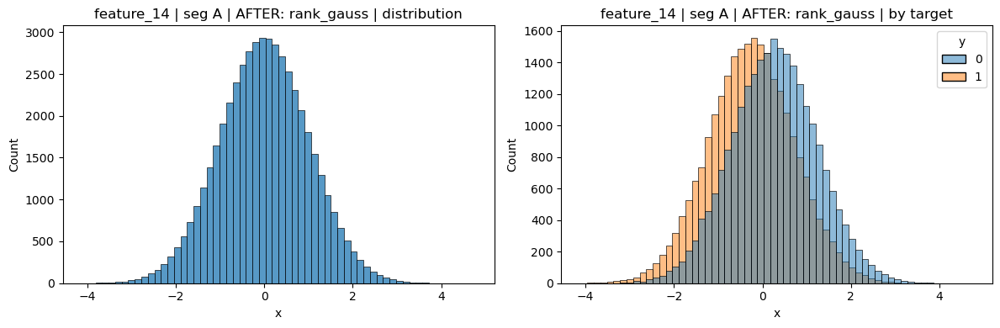

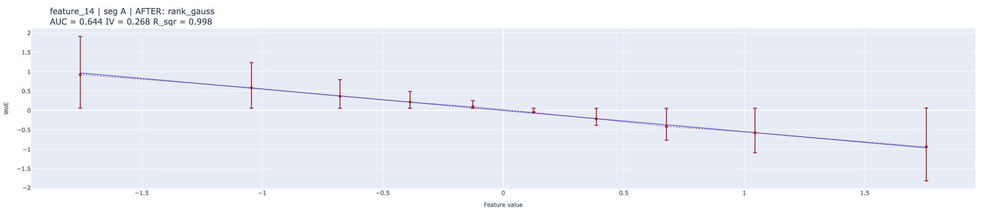

сегмент: B size: 50106
feature_1 | segment B


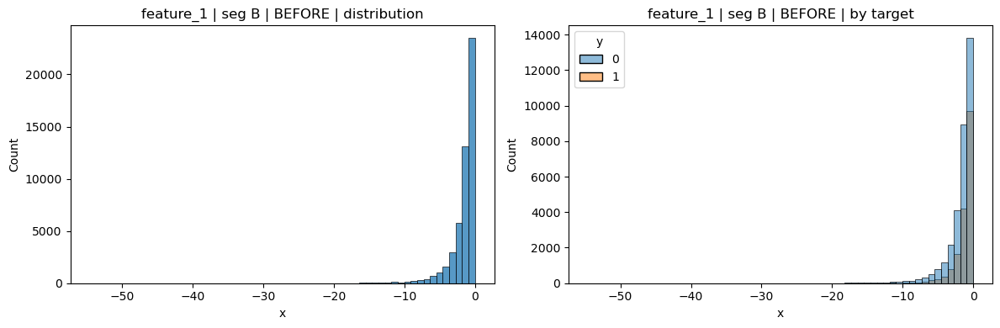

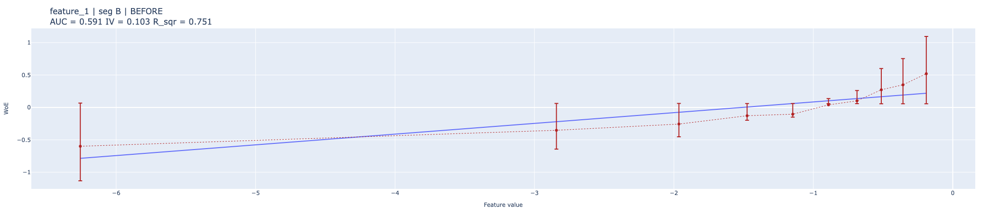

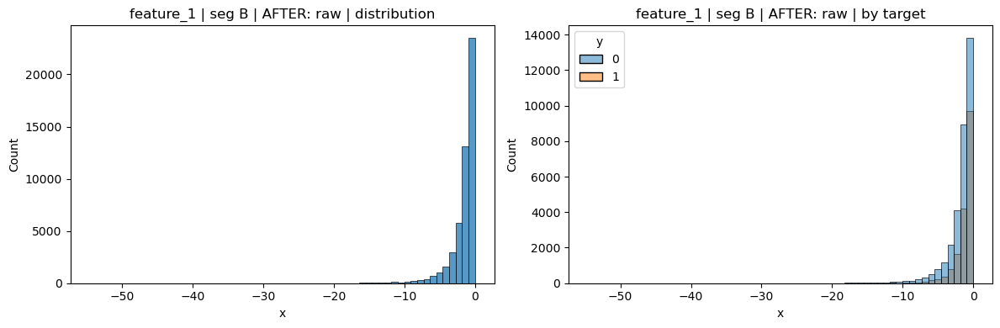

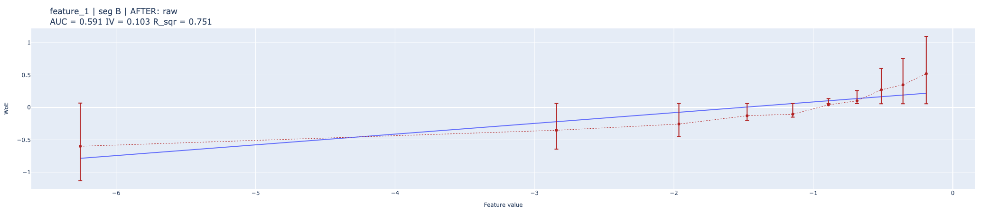

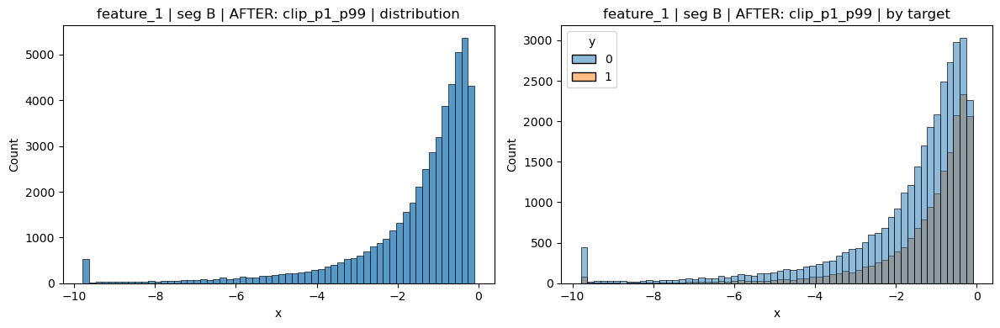

...

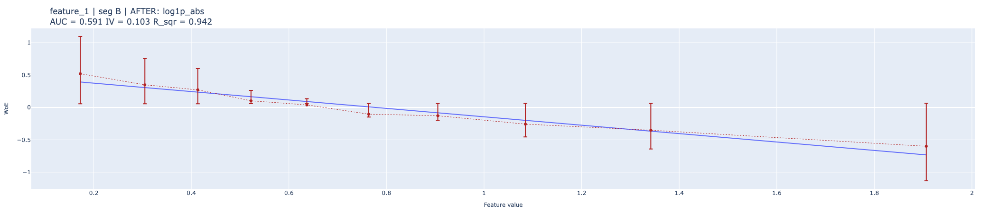

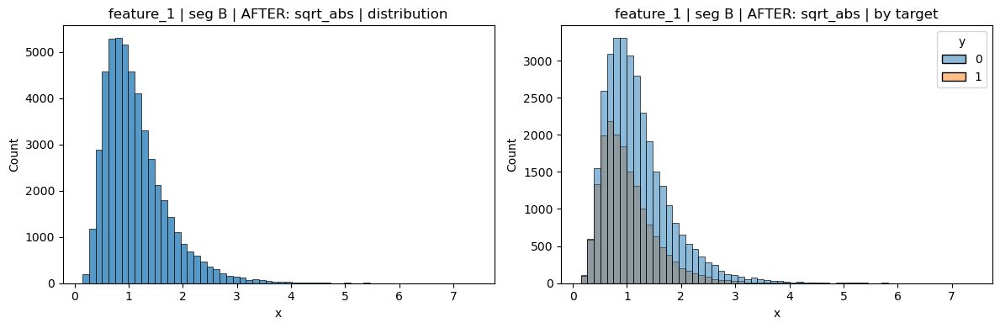

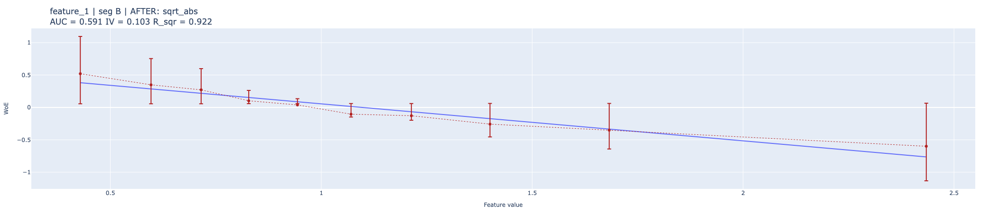

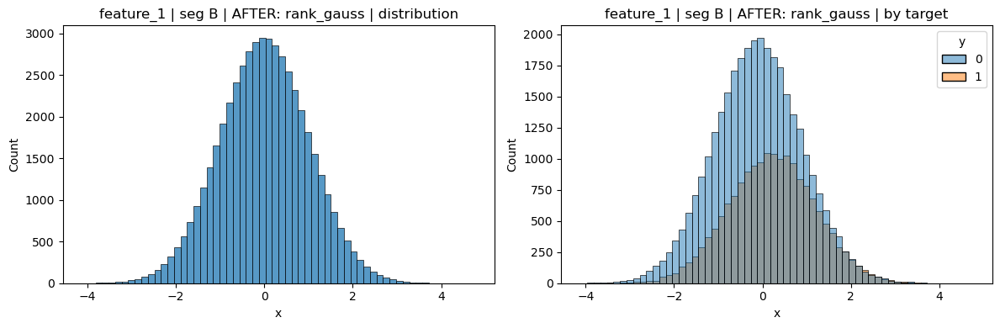

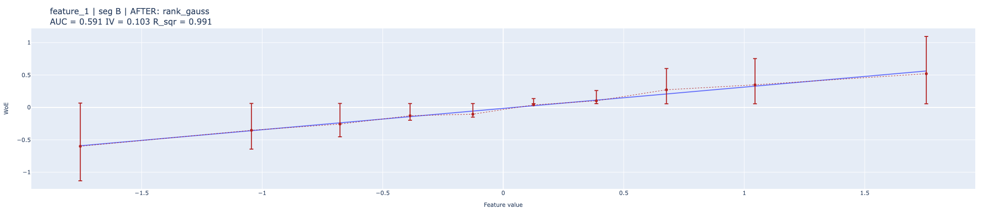

feature_2 | segment B


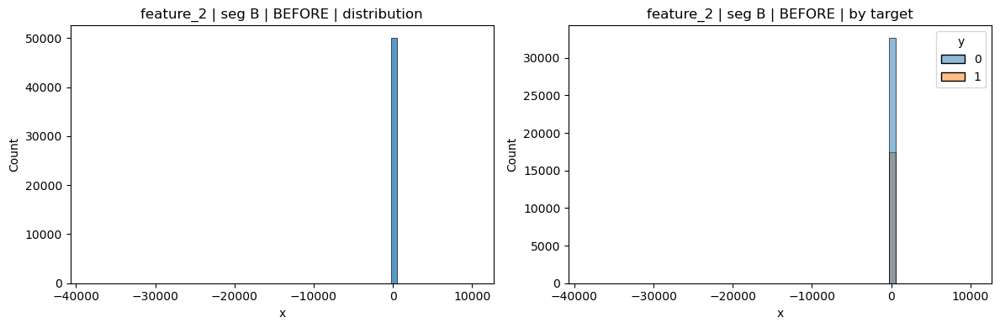

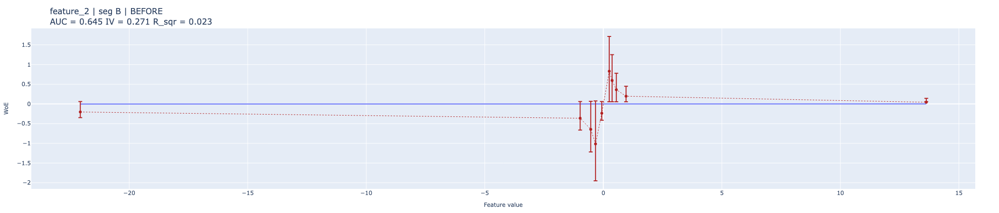

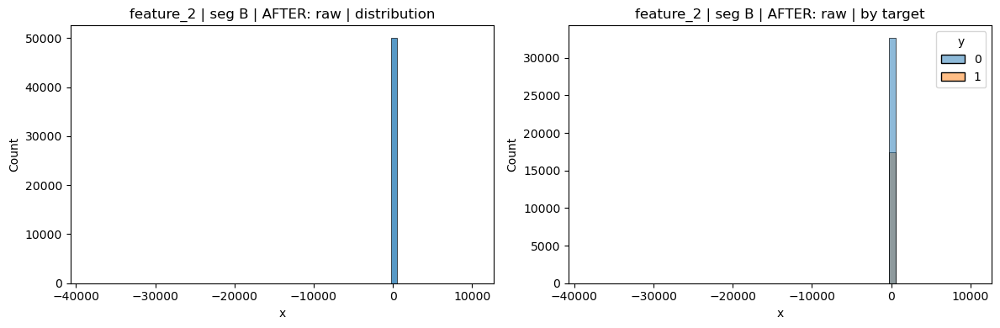

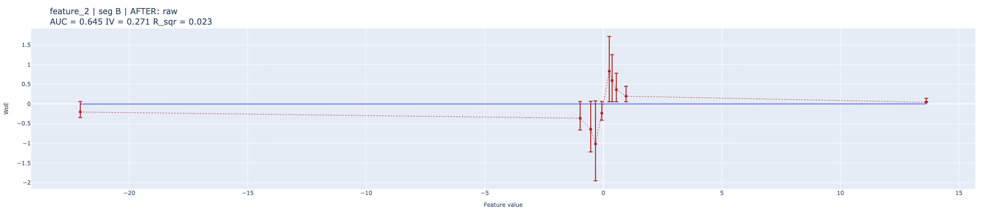

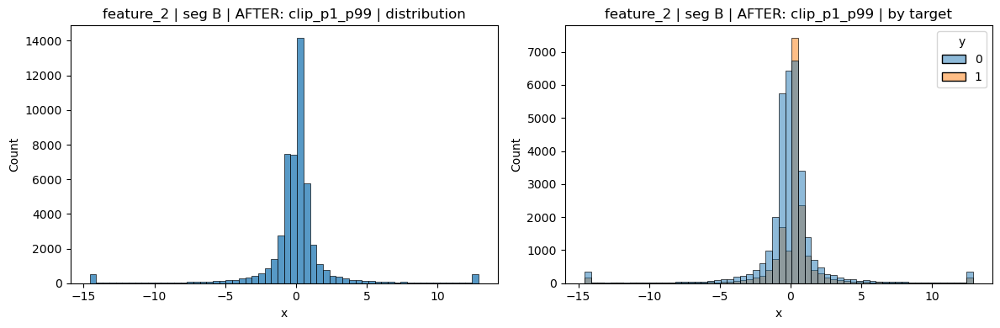

...

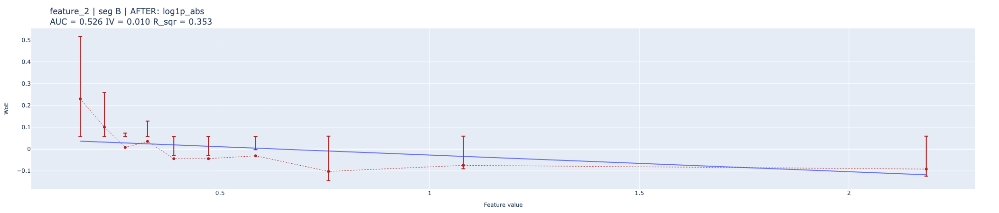

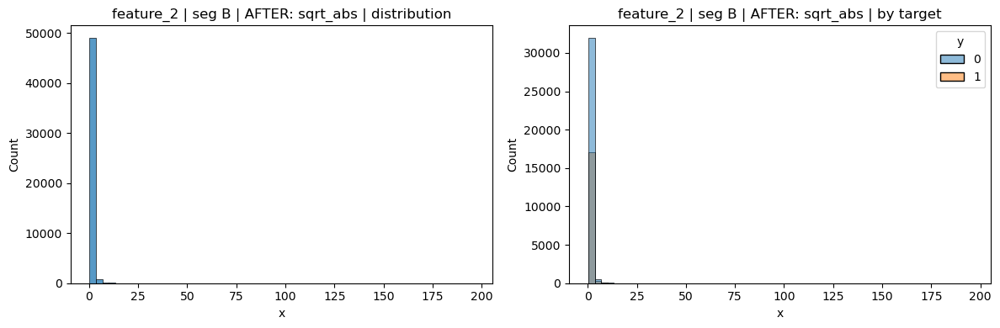

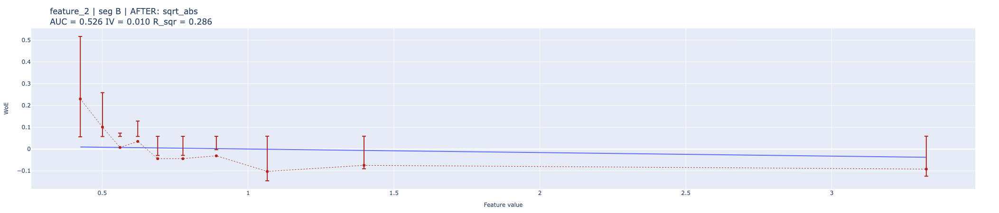

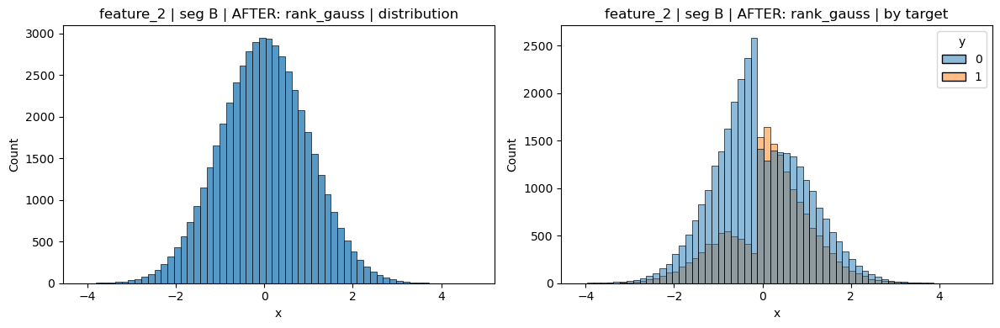

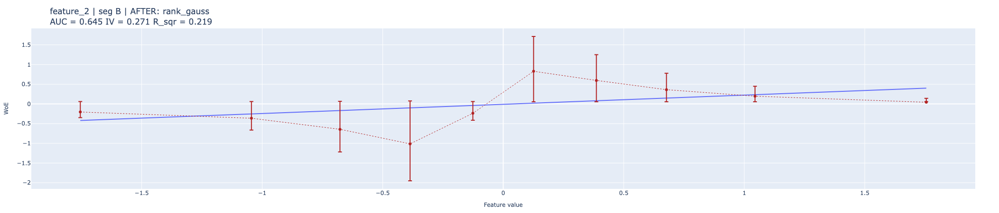

feature_3 | segment B


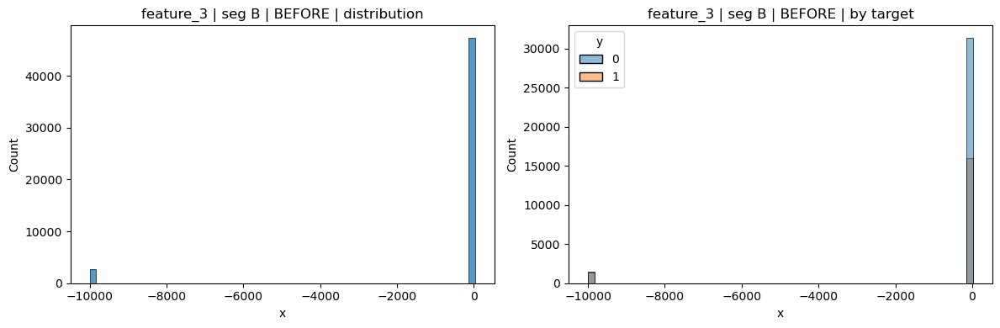

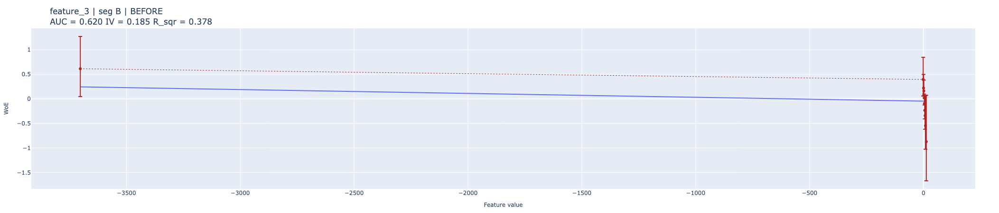

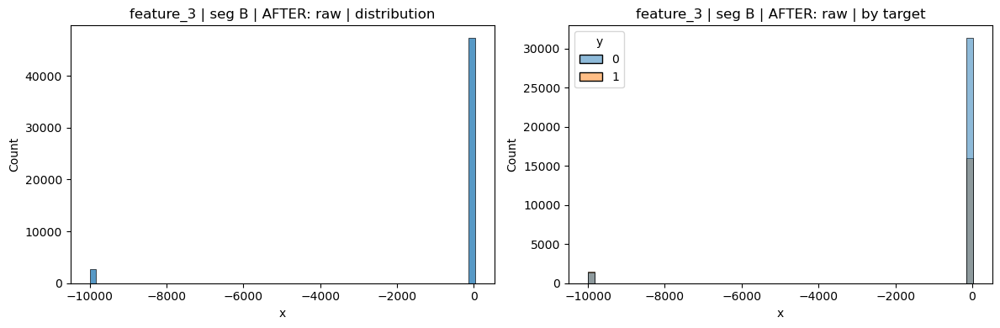

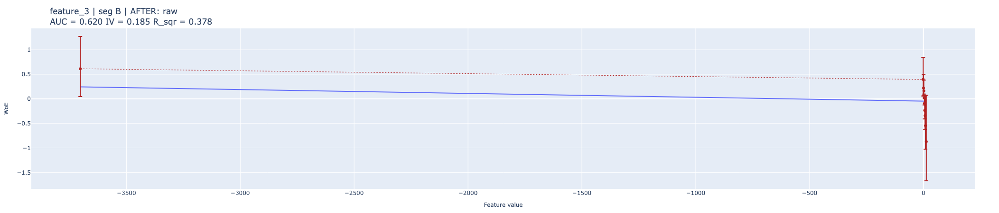

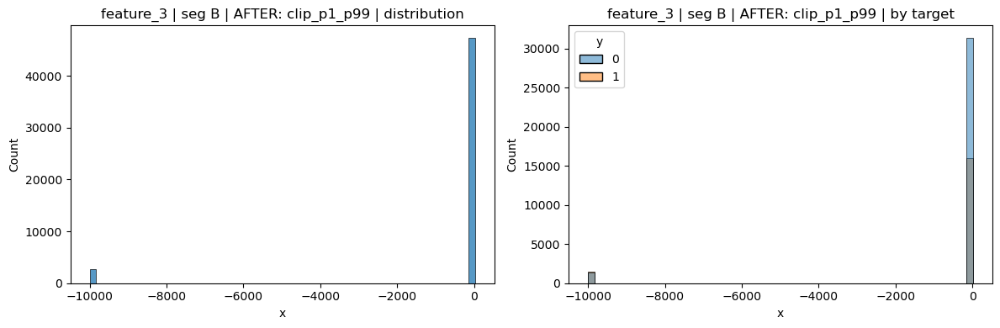

...

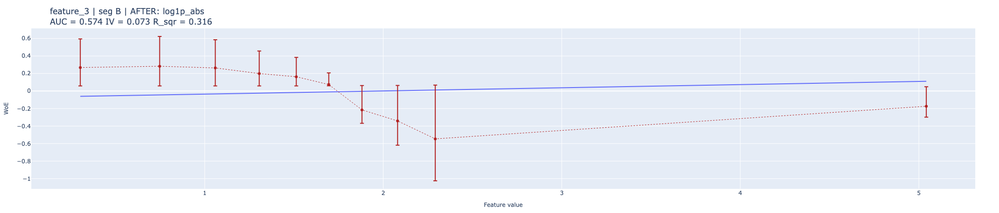

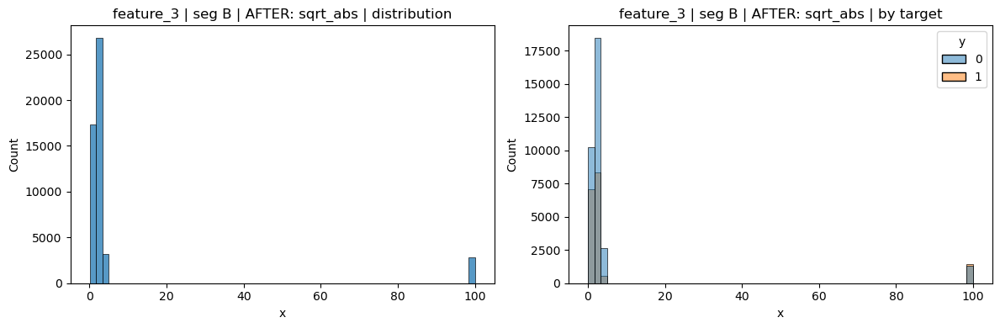

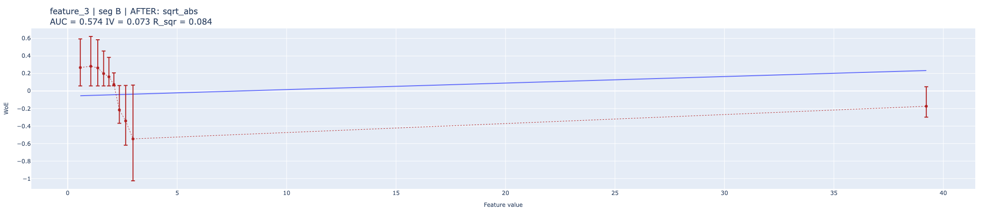

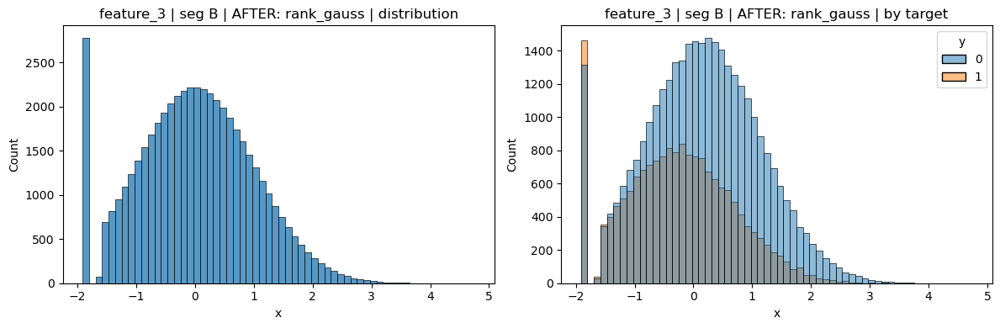

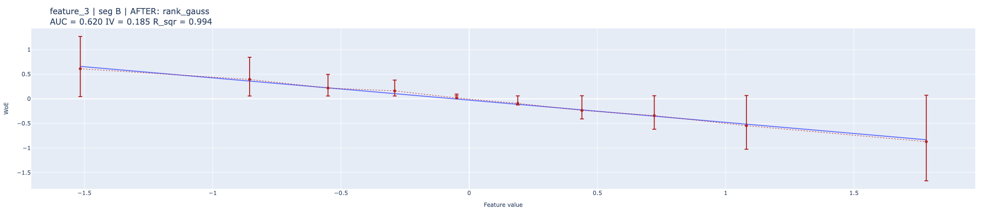

feature_4 | segment B


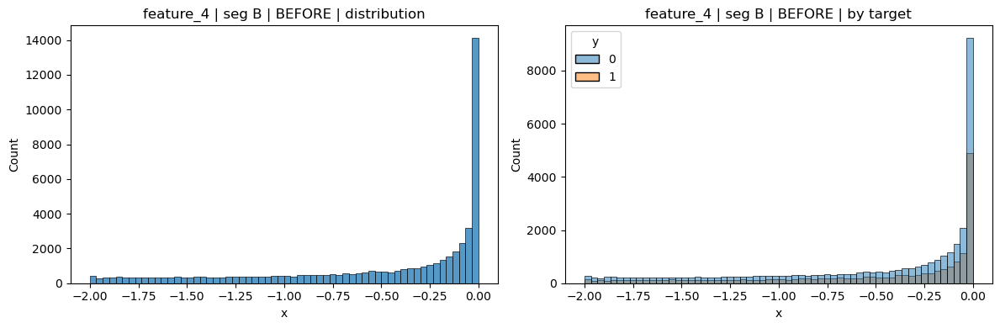

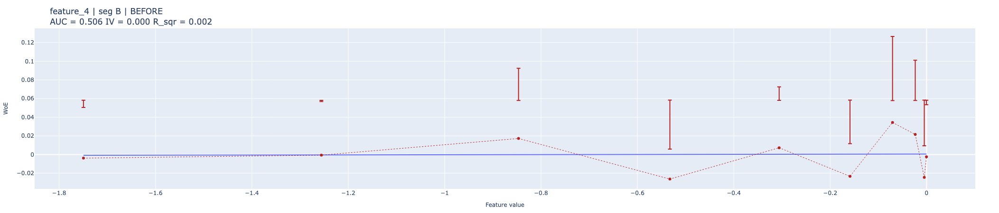

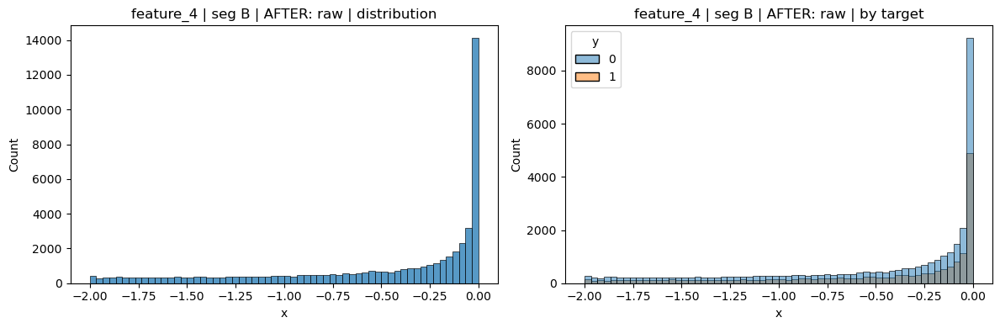

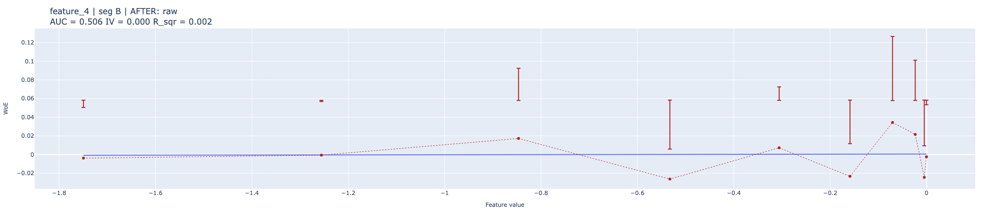

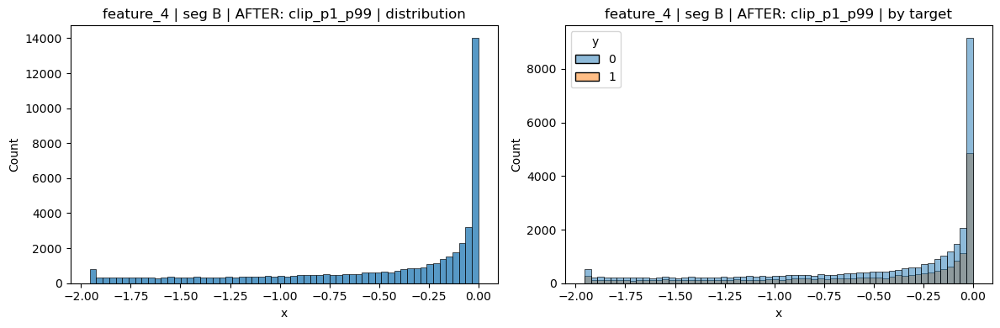

...

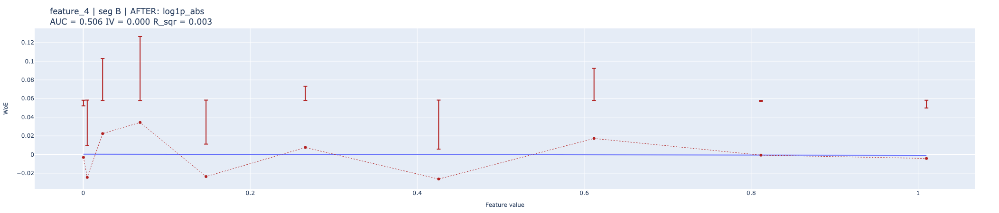

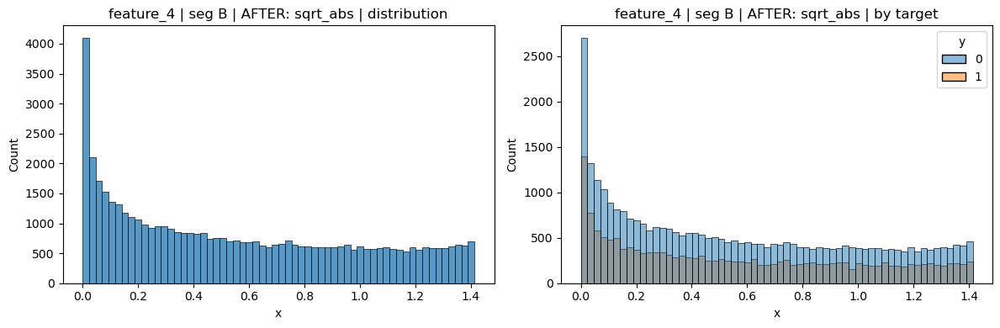

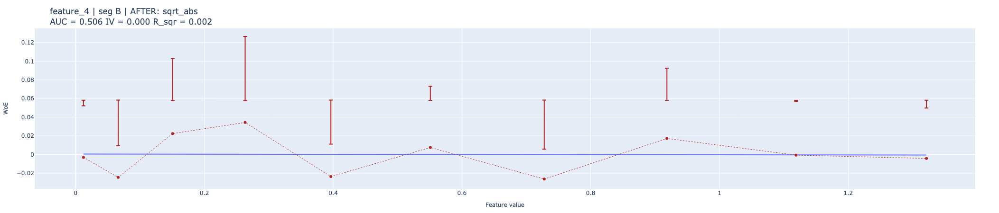

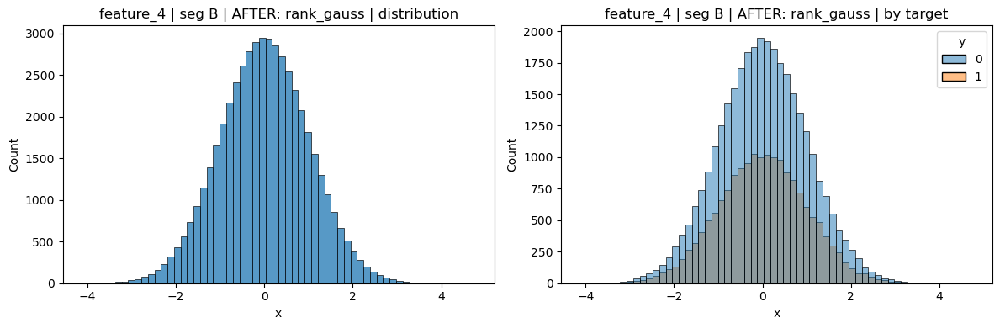

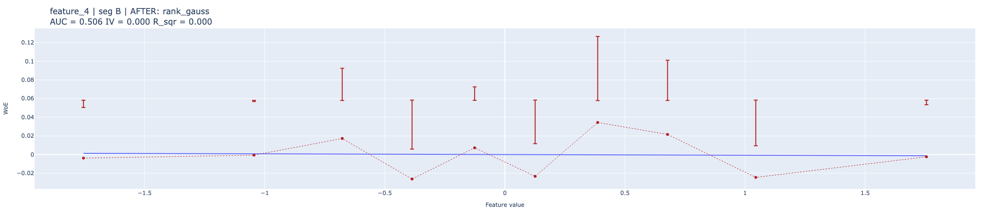

feature_5 | segment B


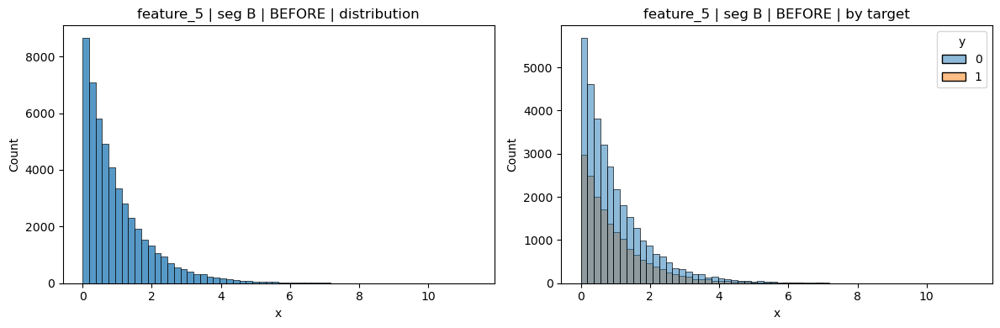

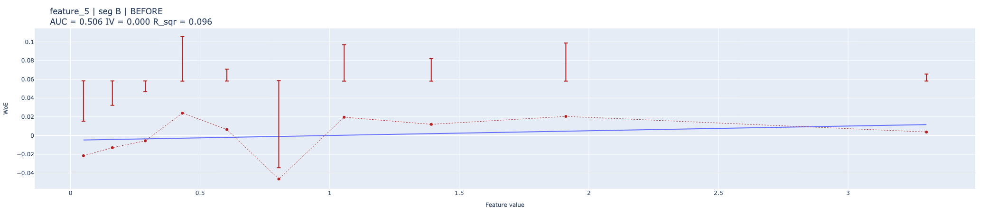

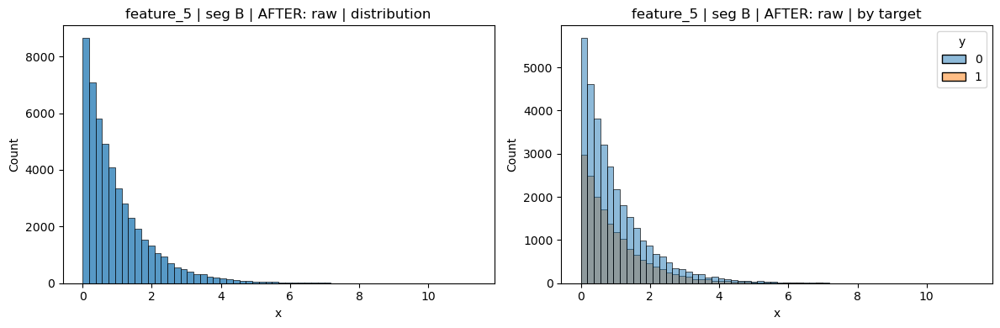

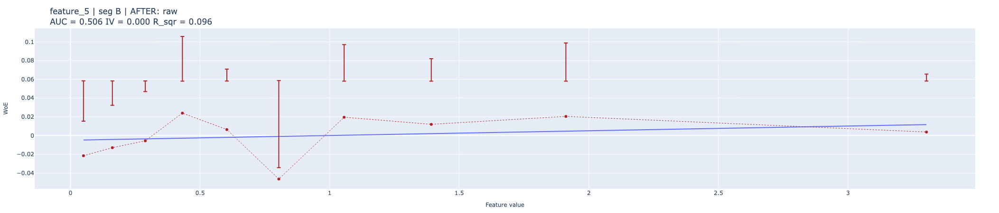

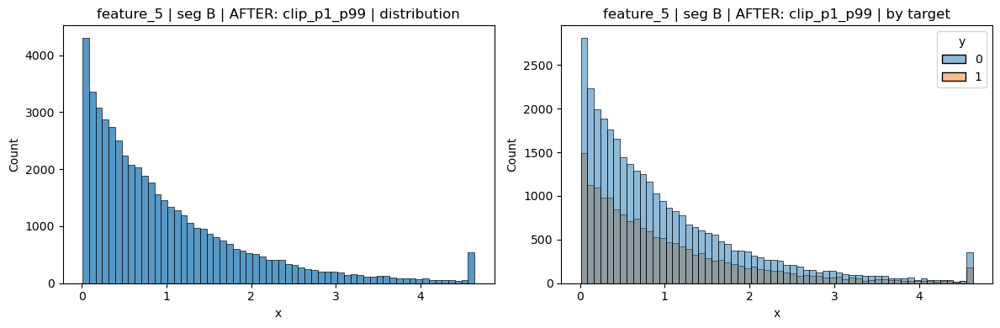

...

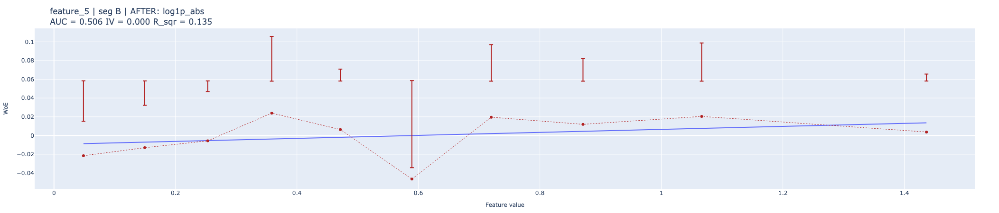

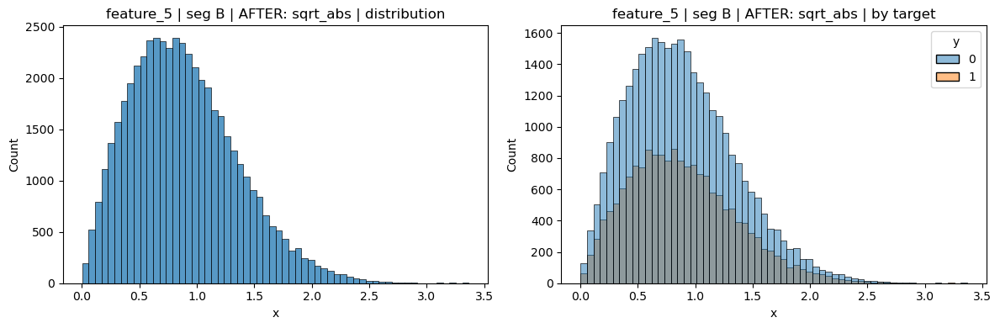

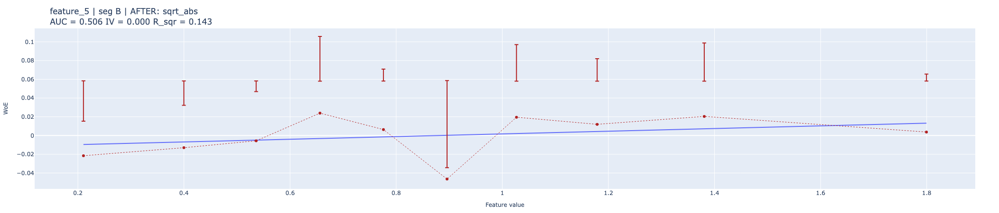

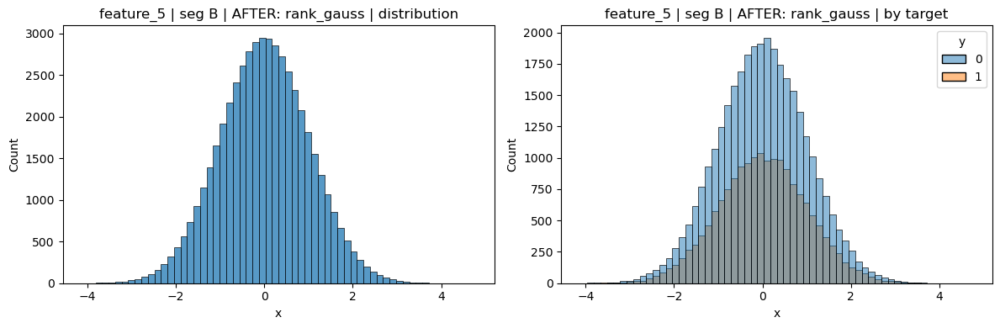

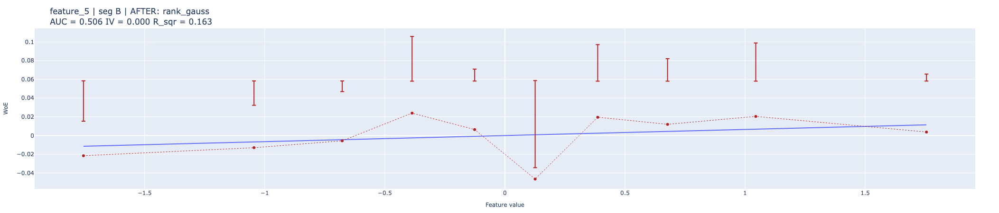

feature_6 | segment B


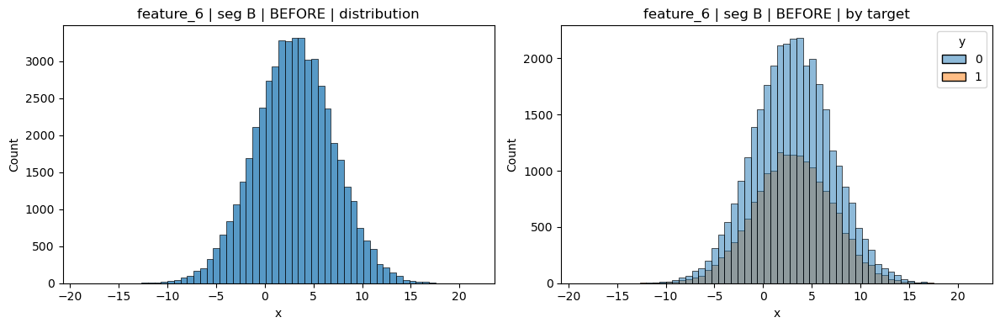

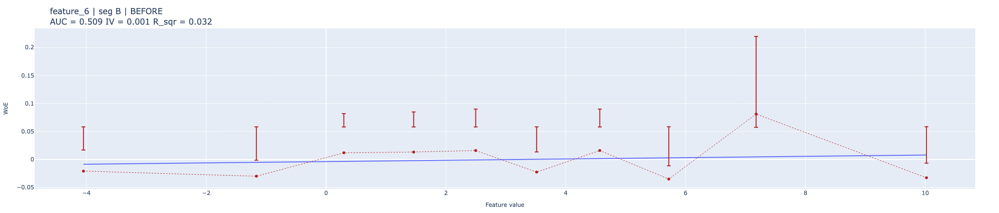

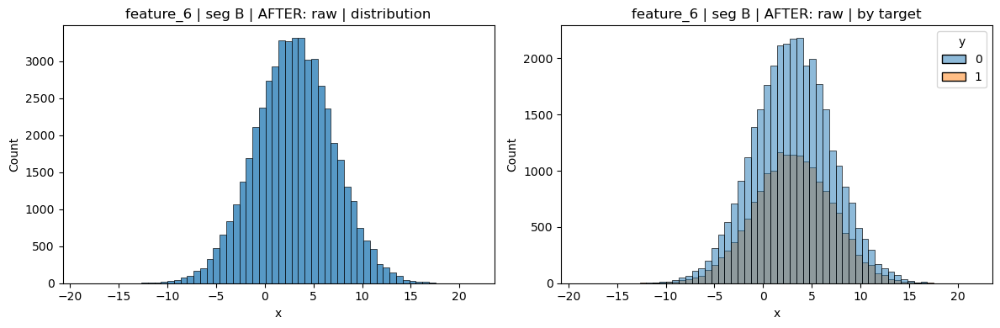

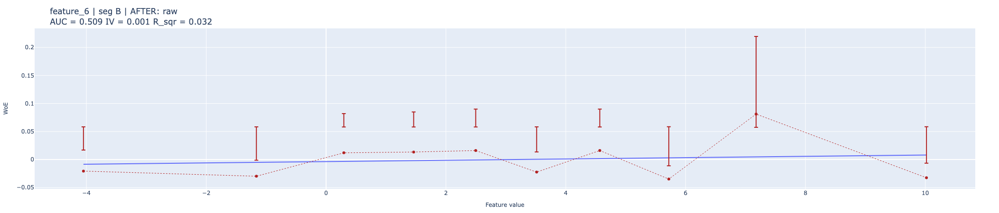

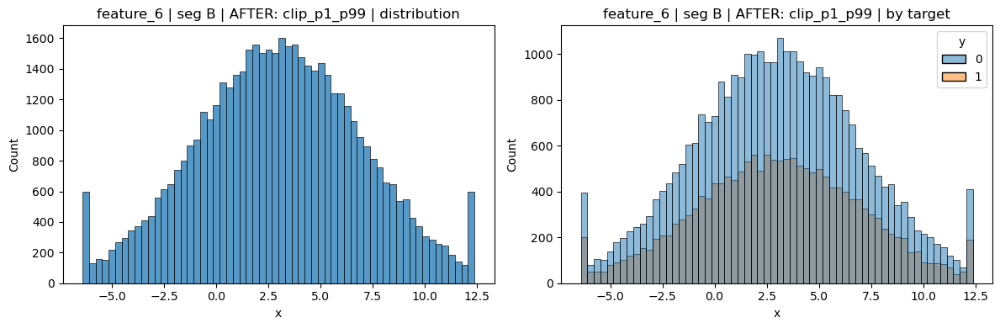

...

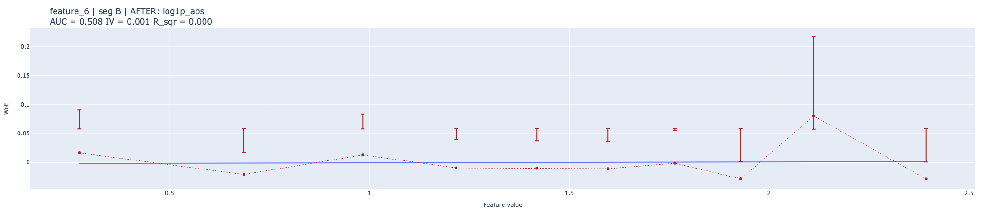

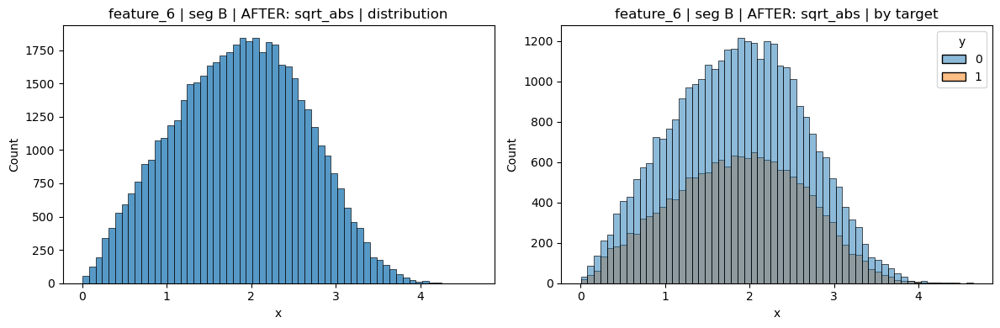

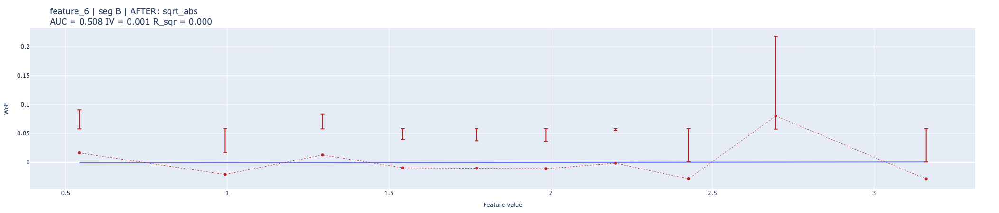

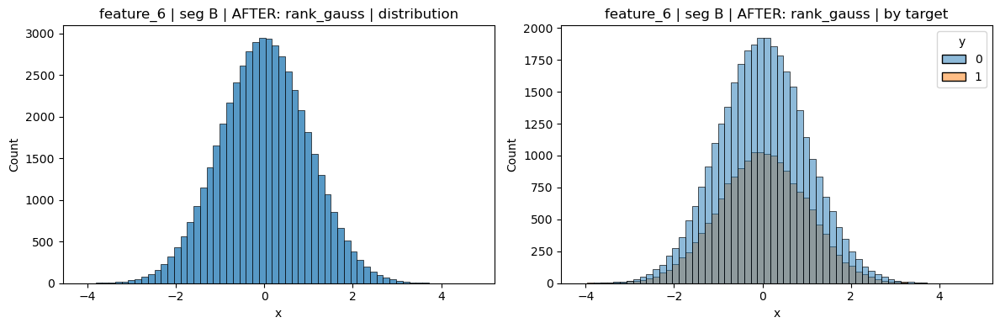

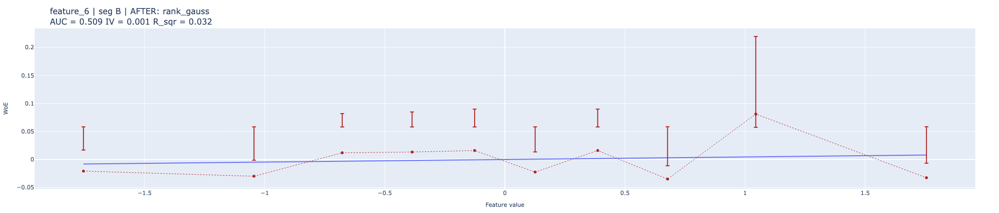

feature_7 | segment B


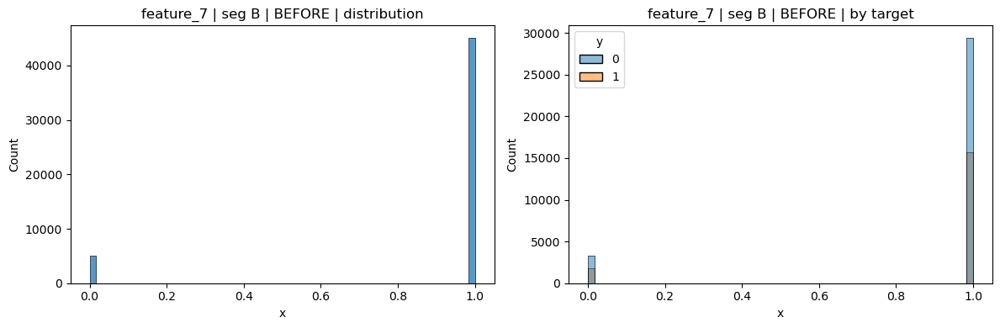

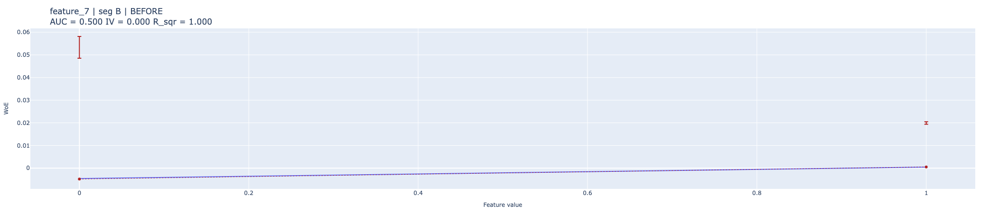

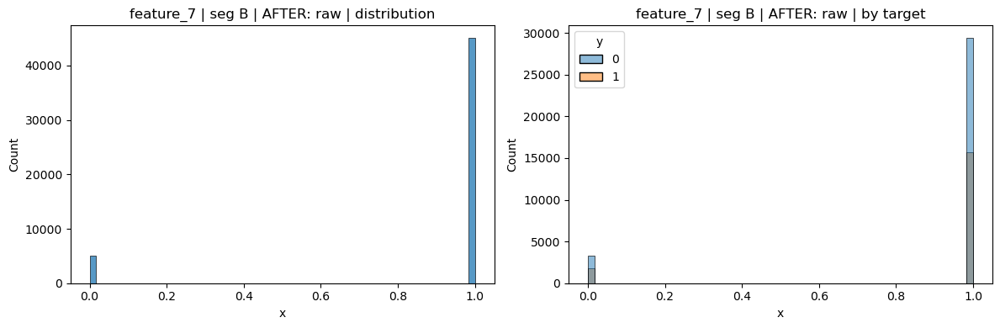

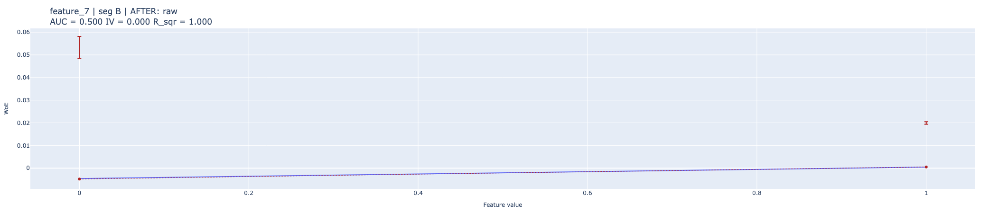

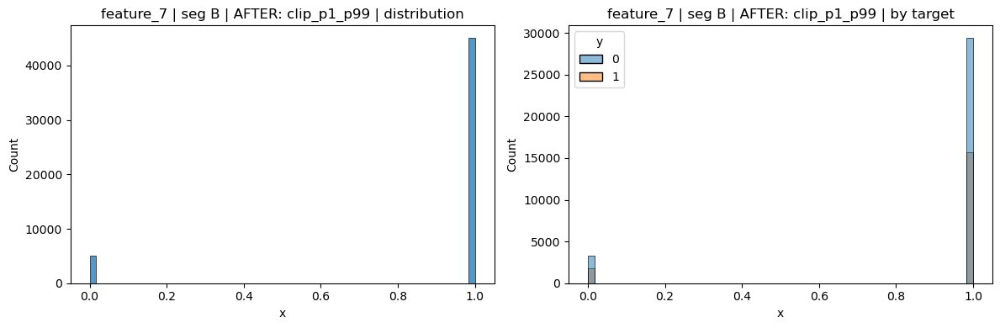

...

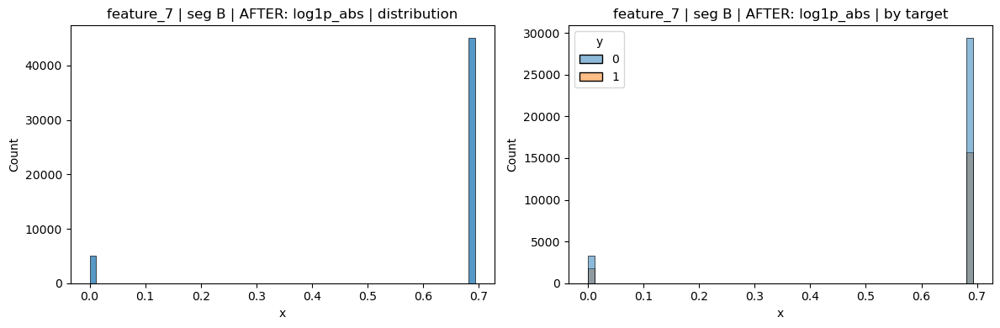

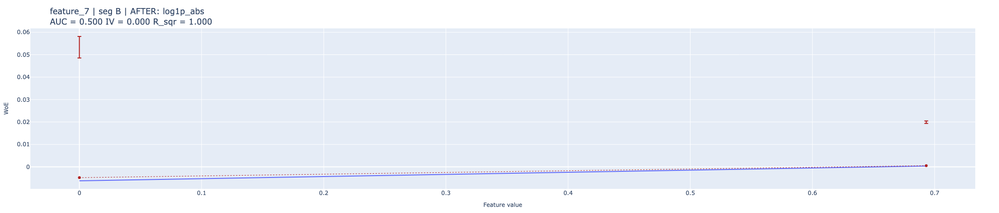

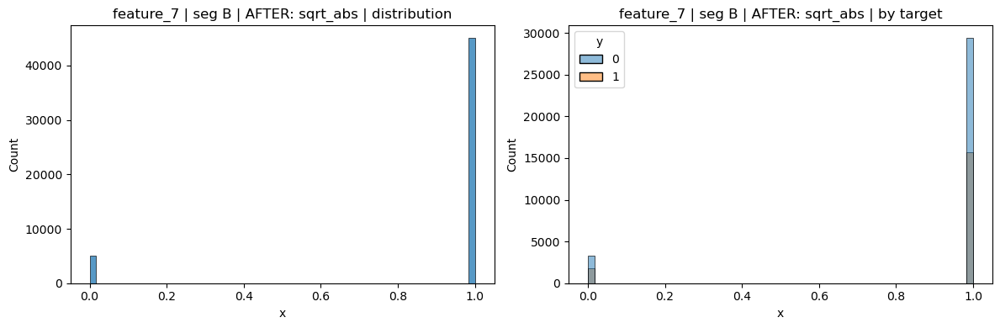

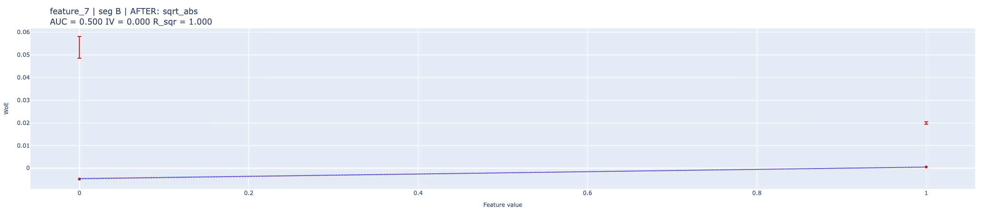

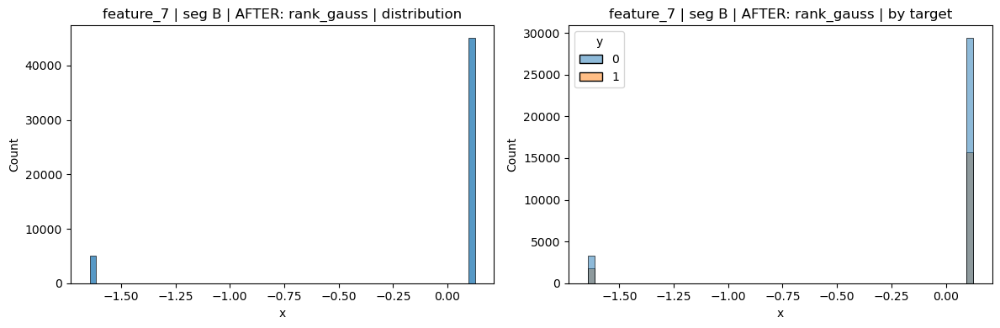

feature_8 | segment B


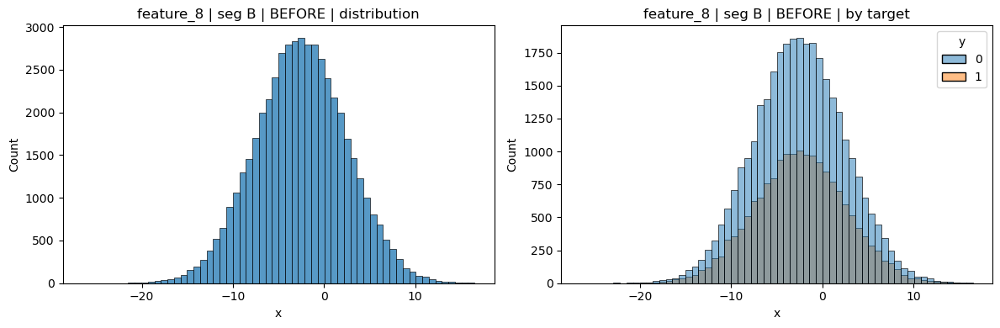

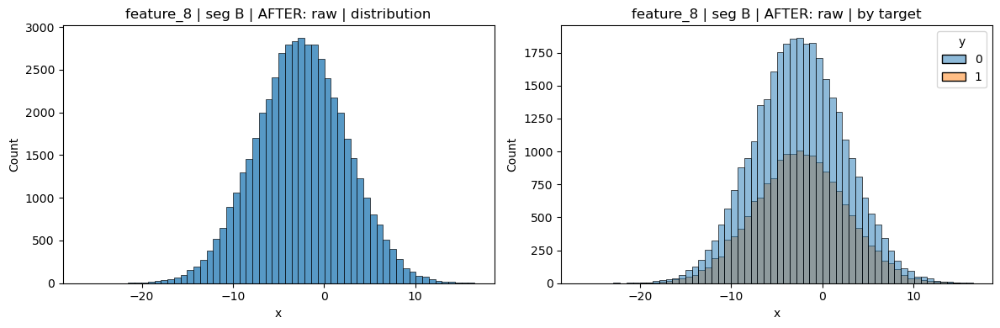

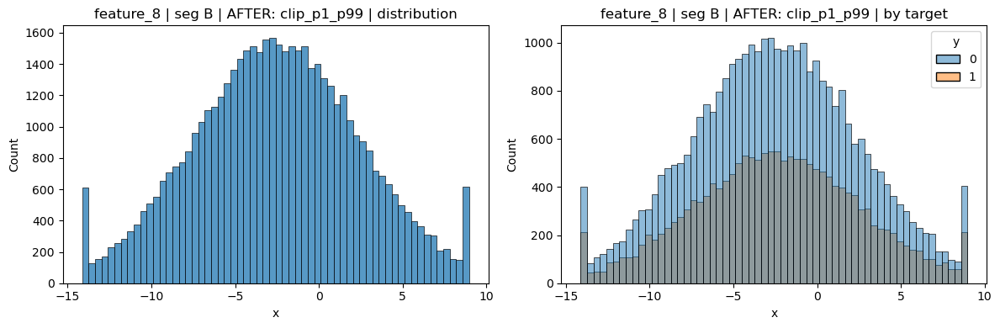

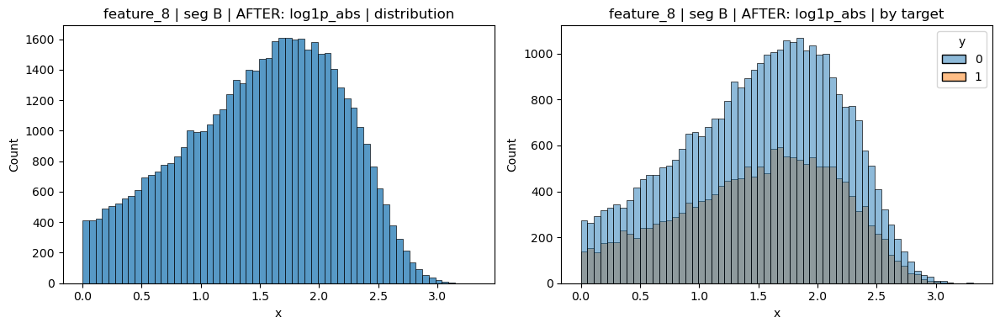

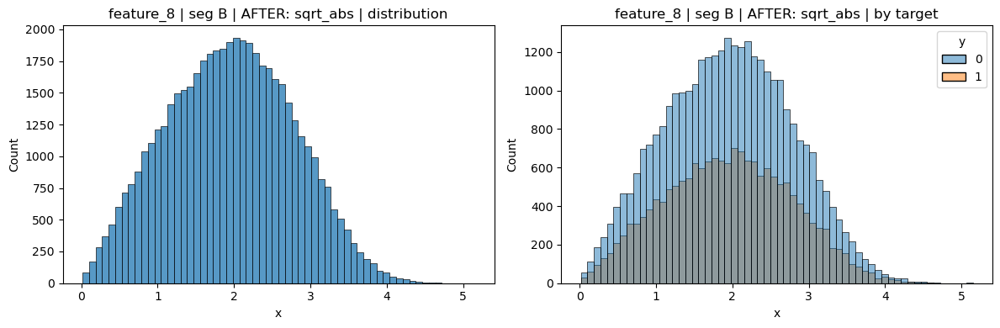

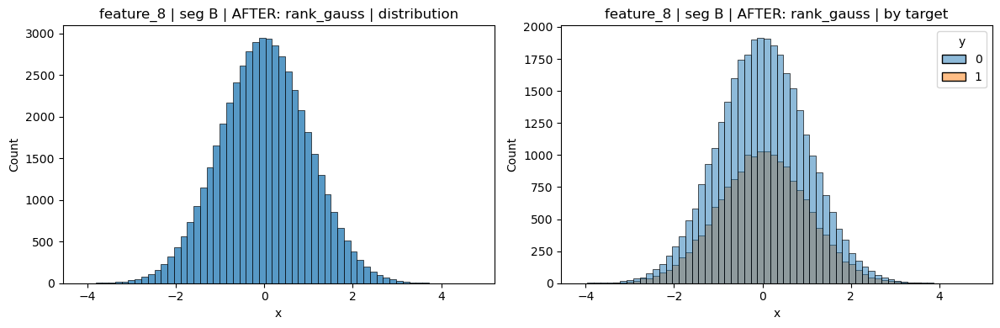

feature_9 | segment B


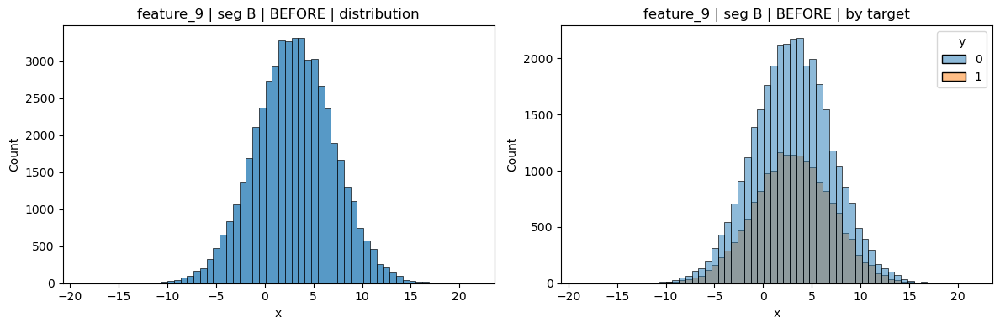

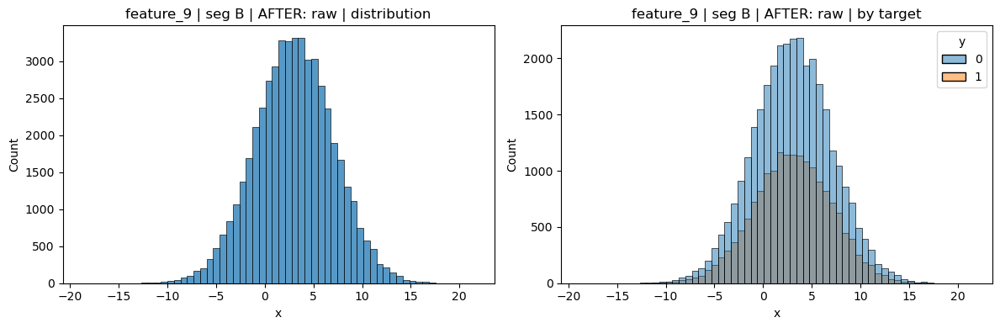

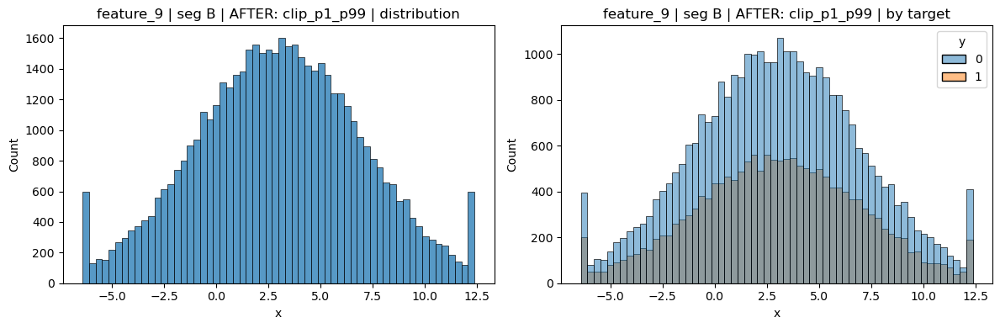

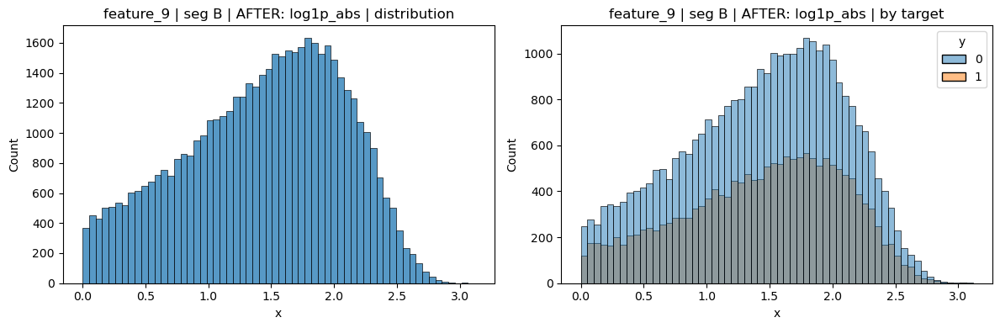

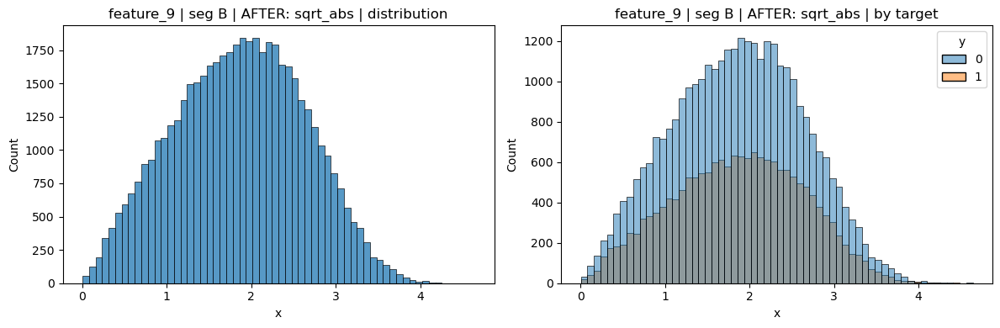

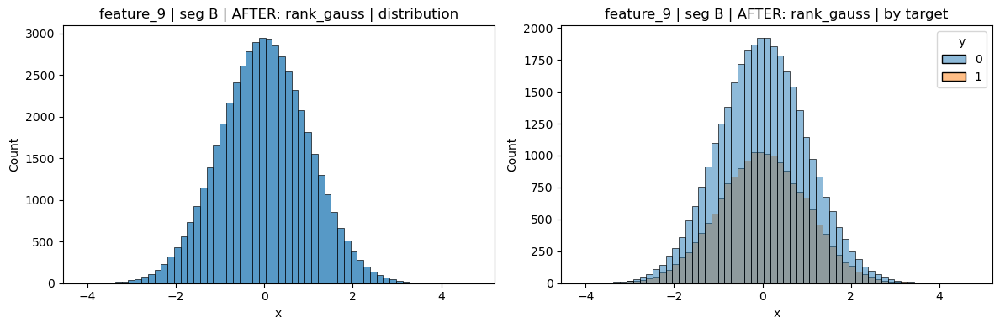

feature_10 | segment B


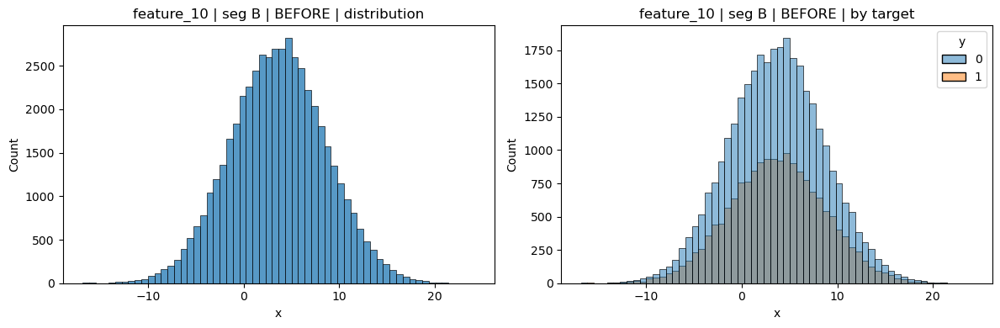

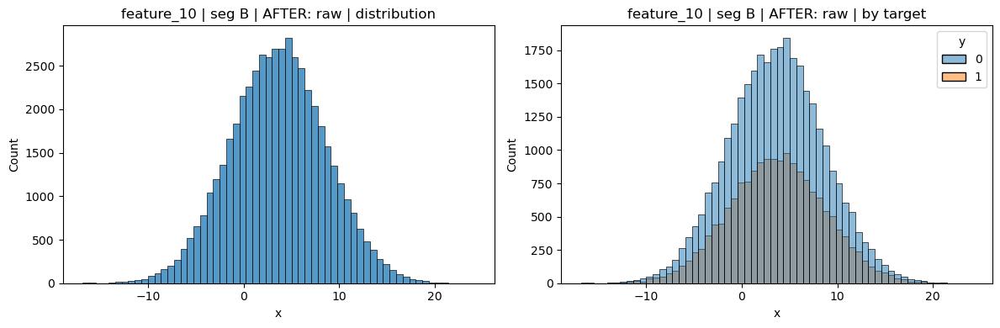

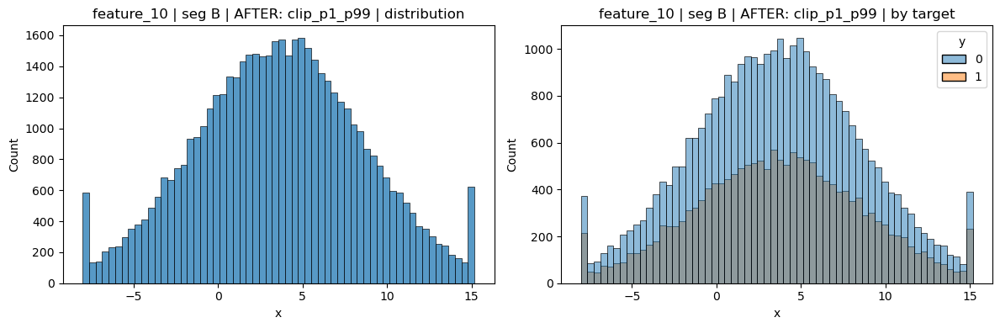

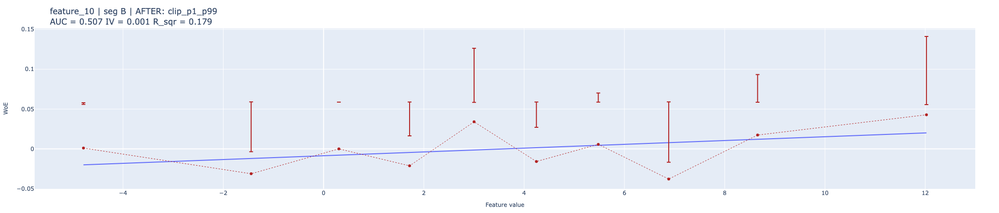

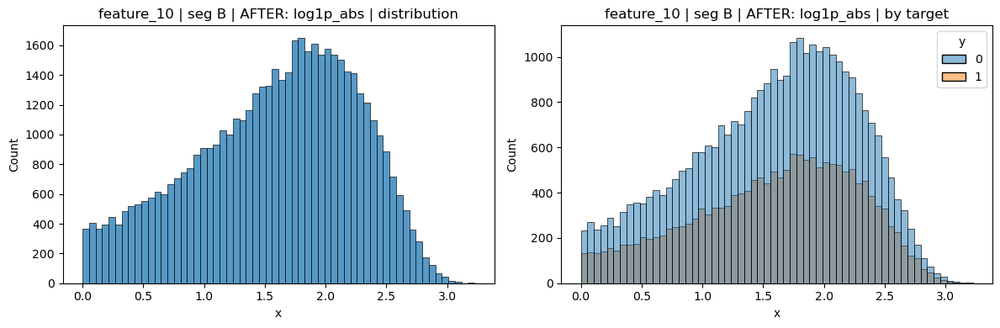

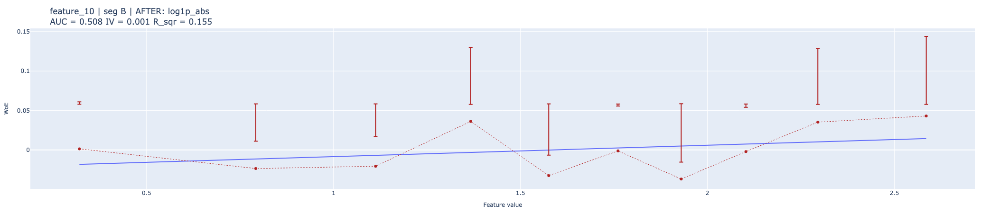

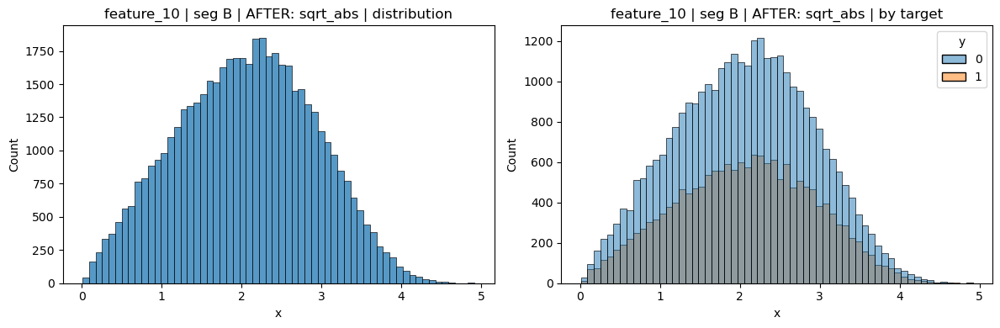

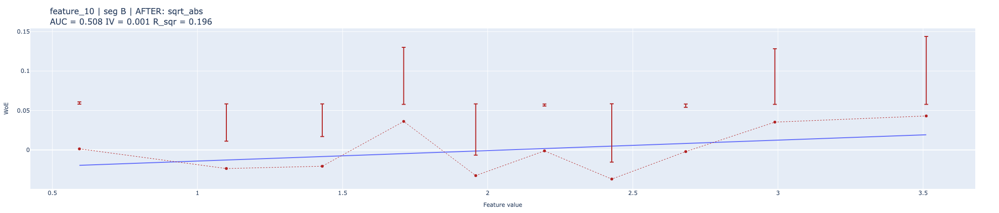

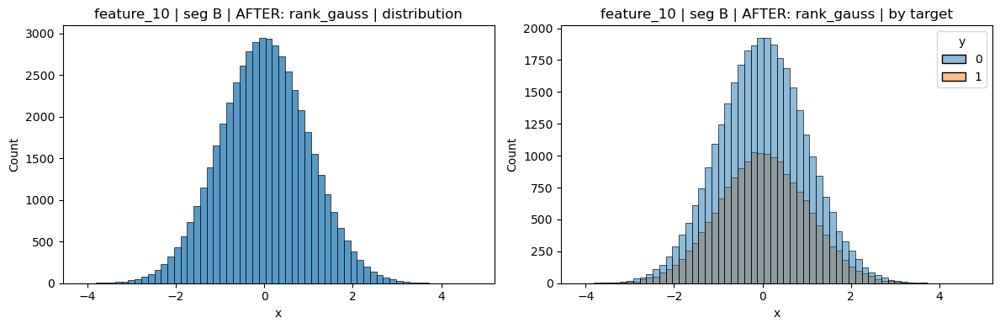

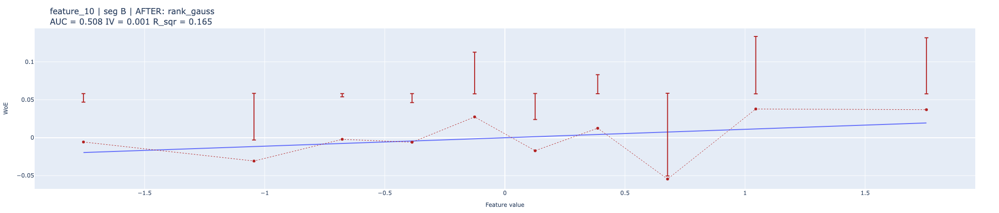

feature_11 | segment B


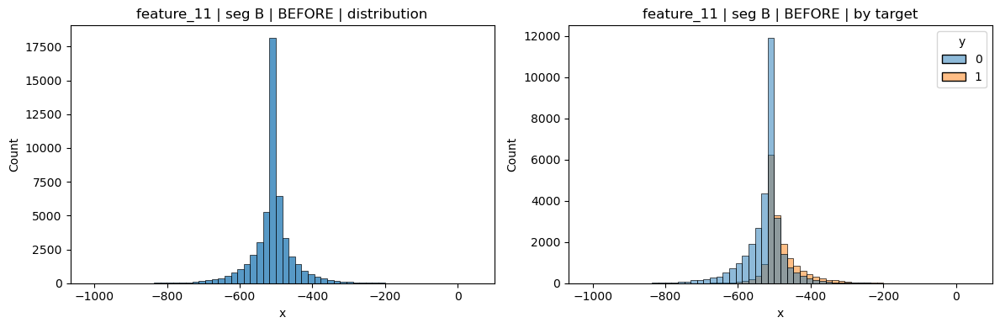

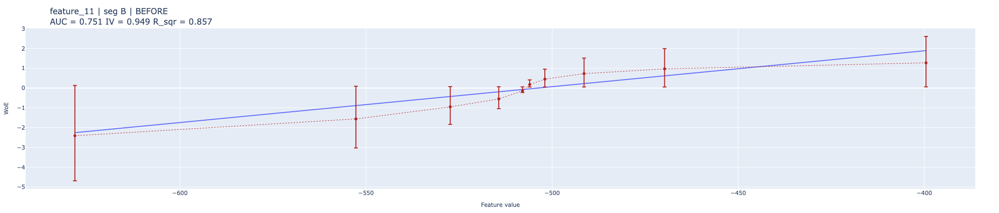

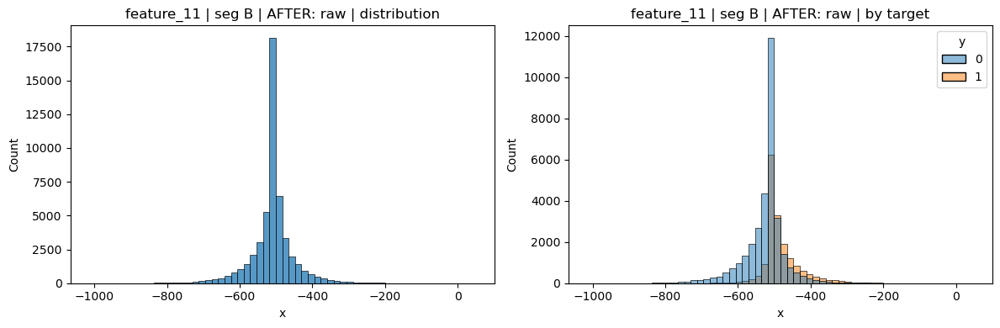

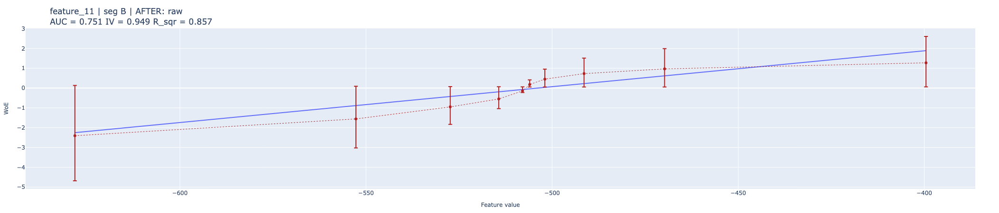

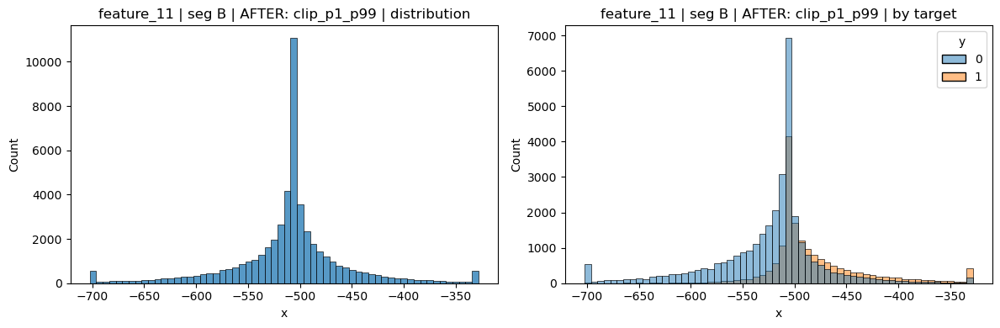

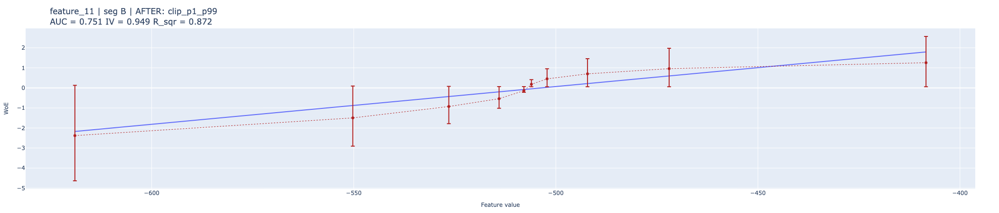

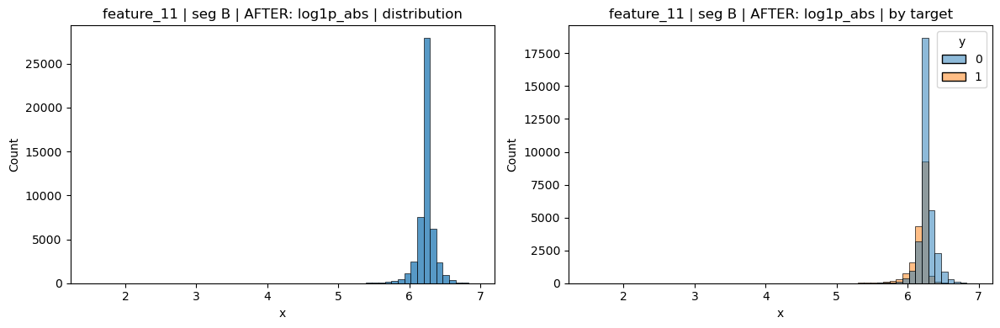

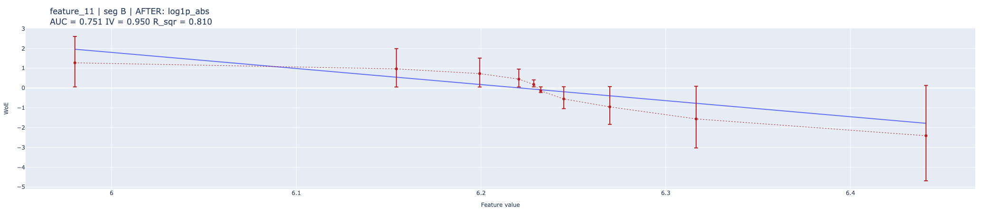

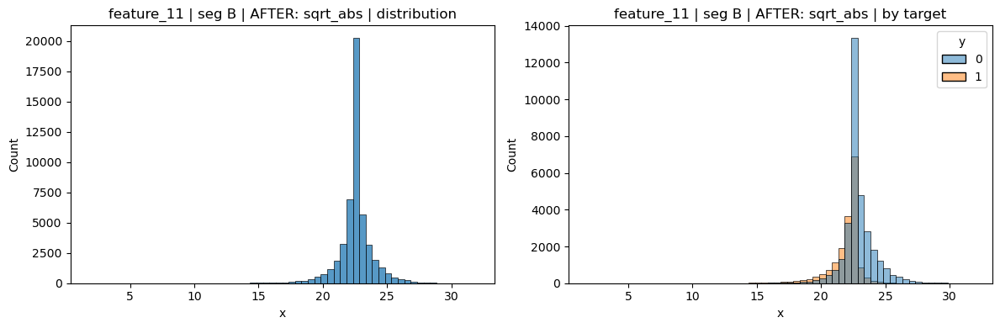

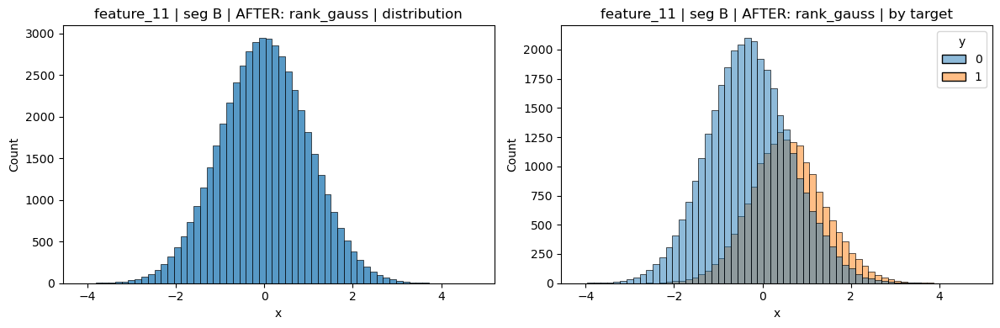

feature_12 | segment B


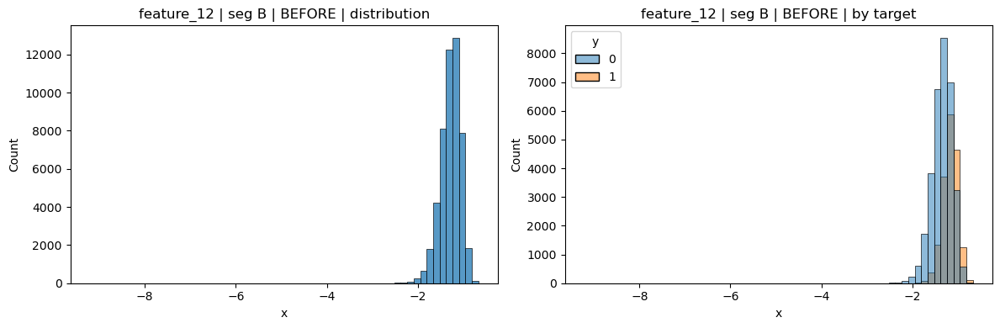

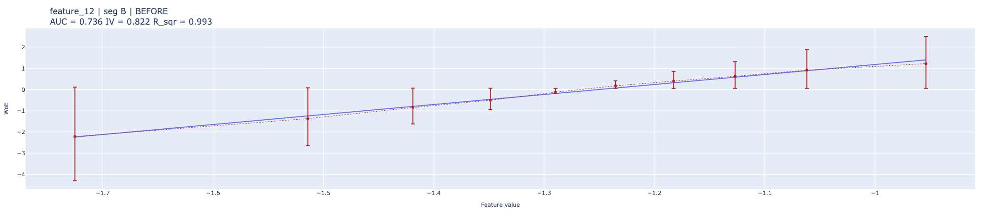

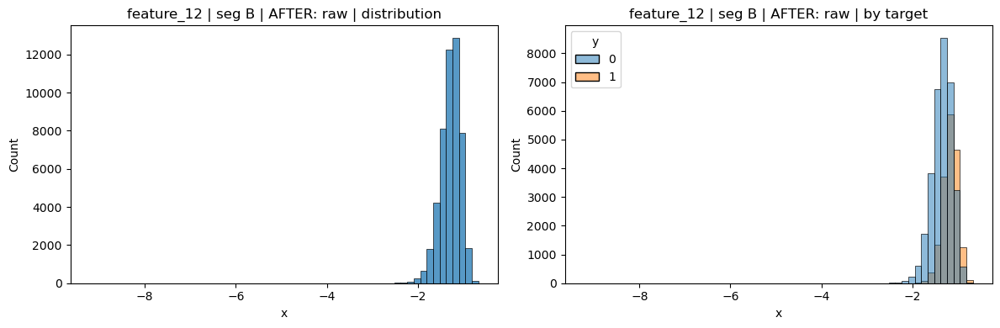

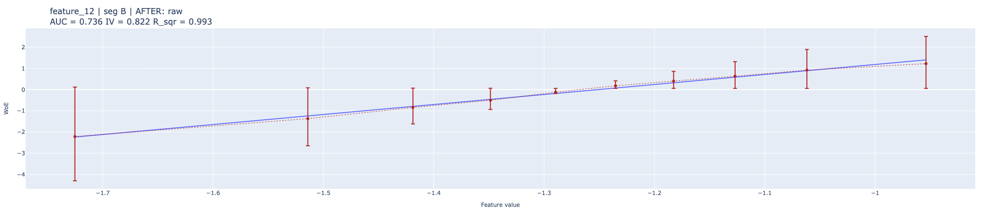

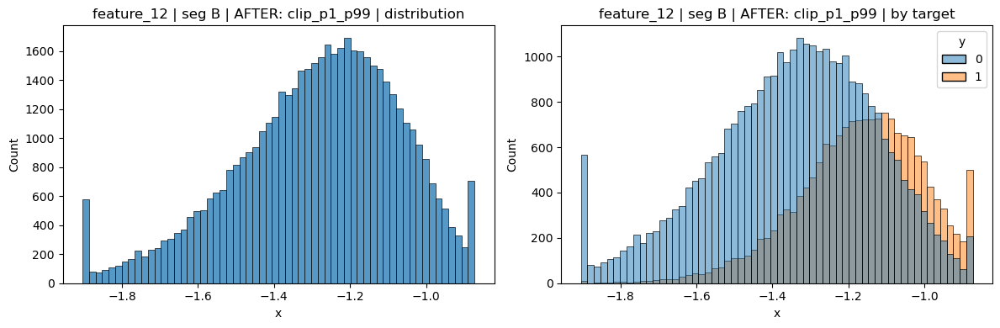

...

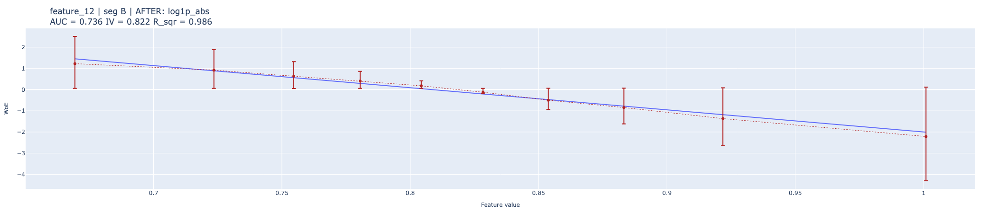

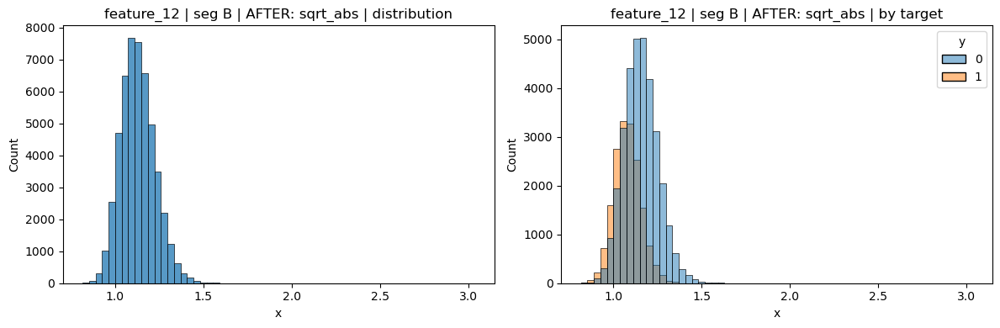

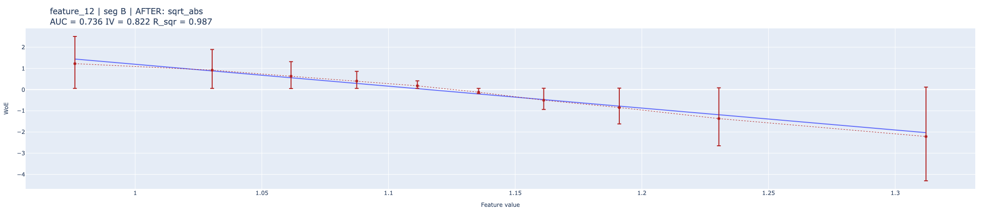

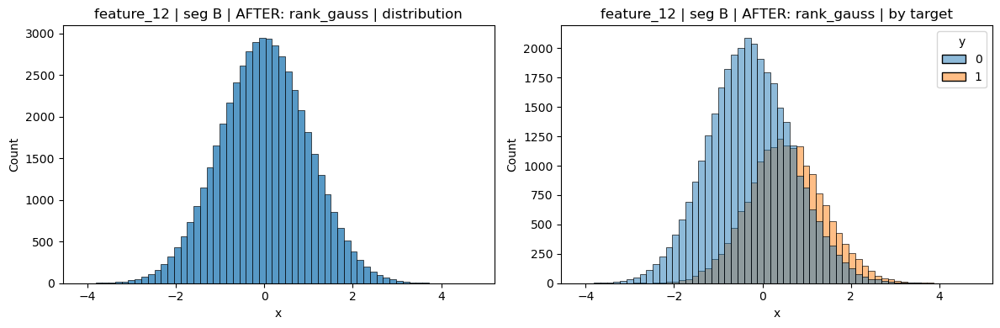

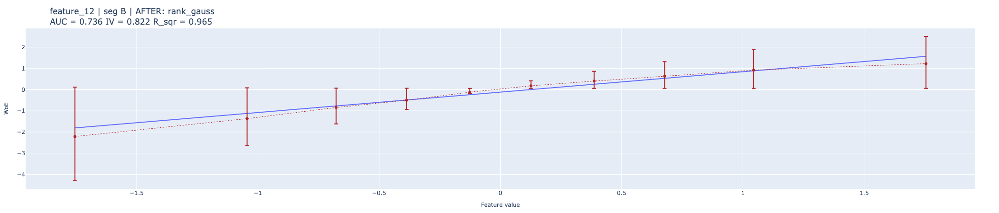

feature_13 | segment B


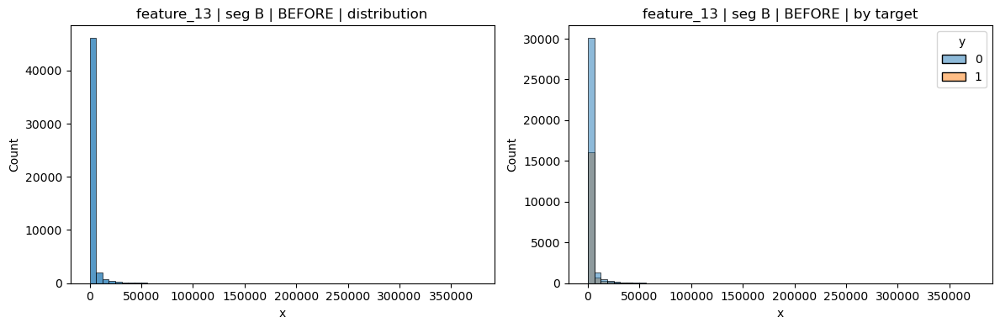

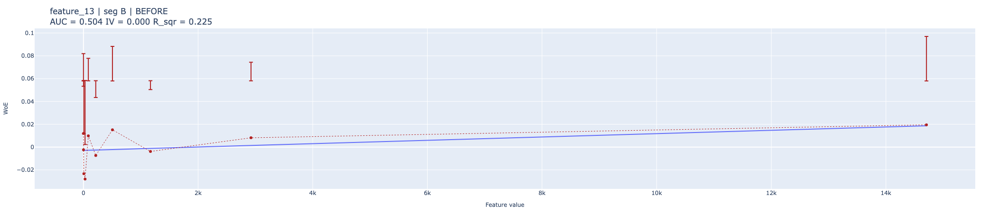

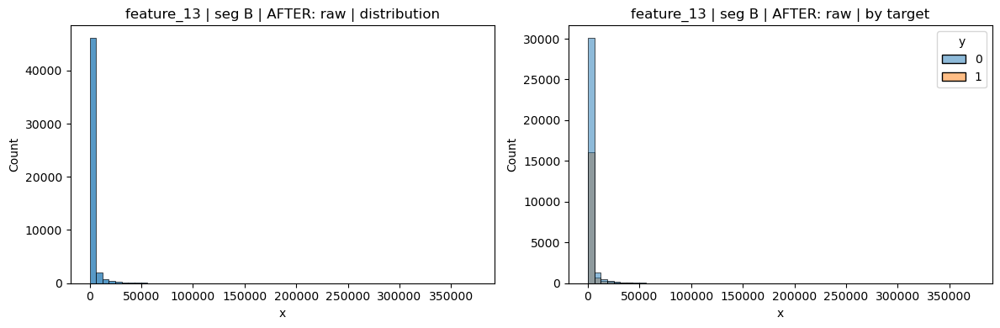

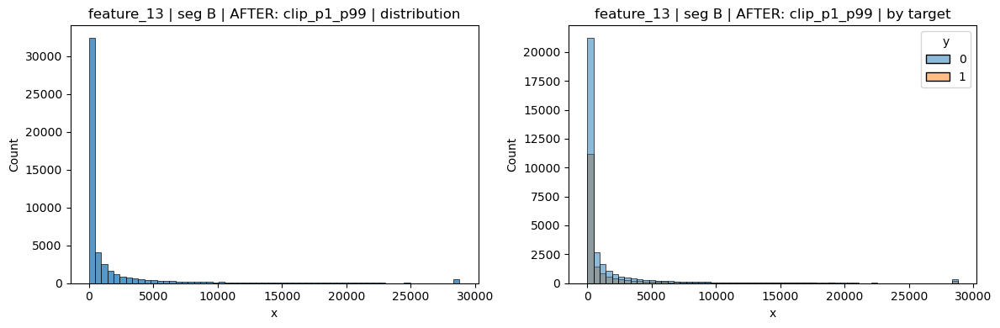

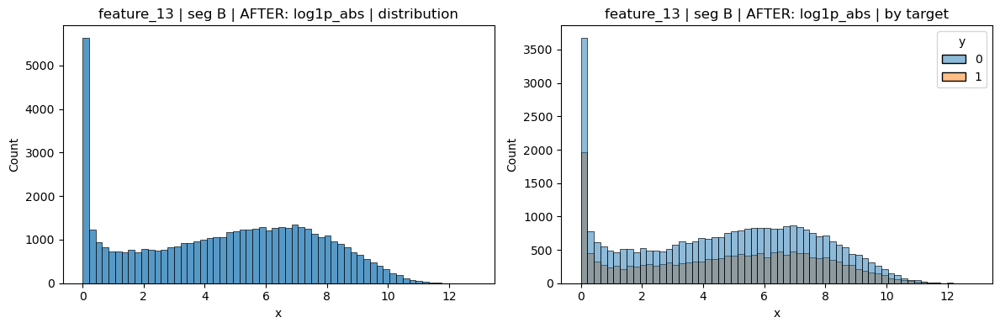

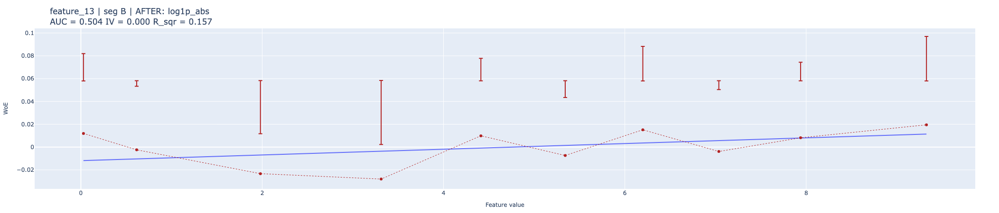

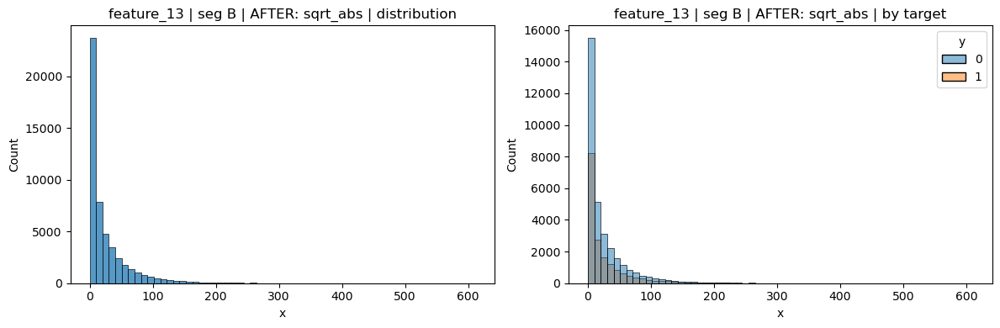

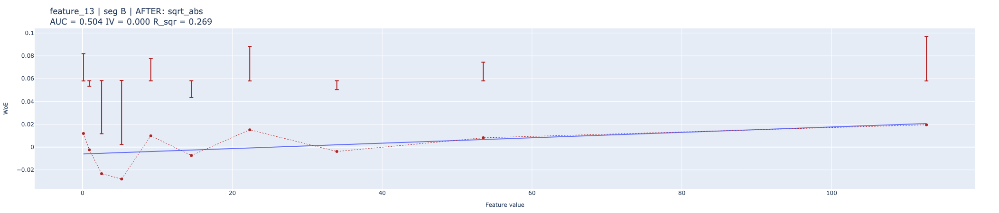

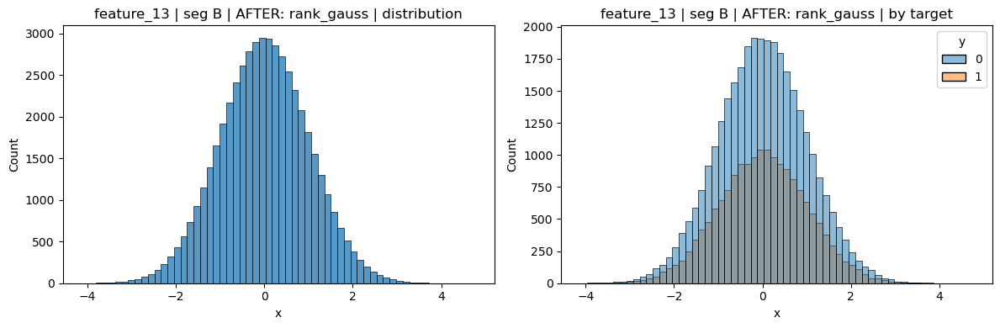

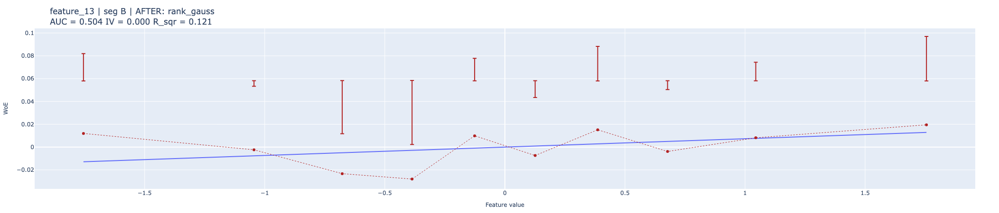

feature_14 | segment B


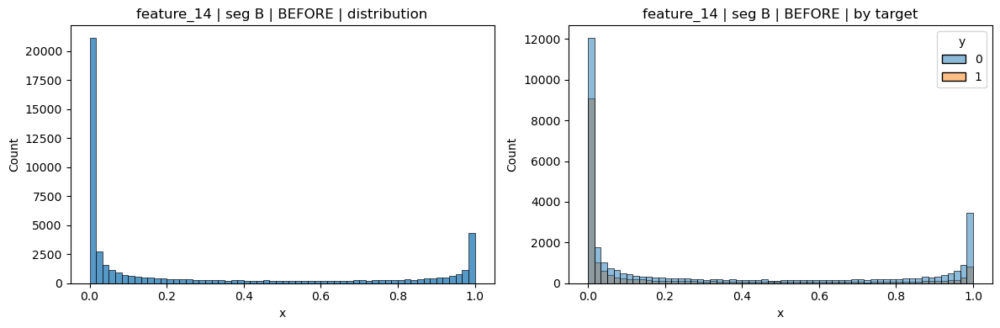

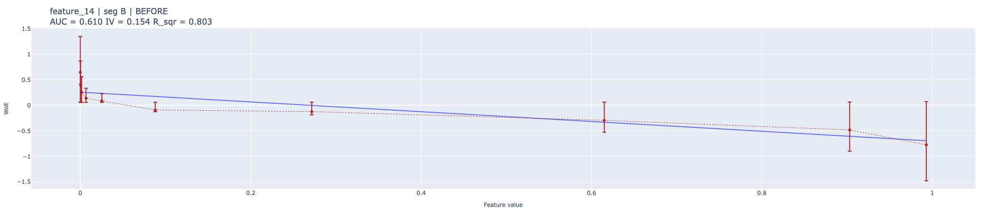

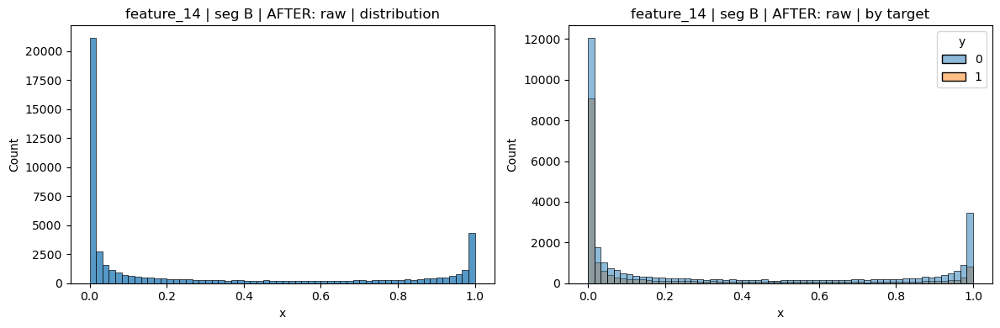

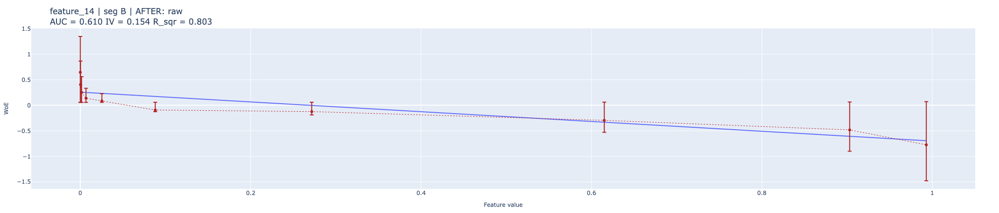

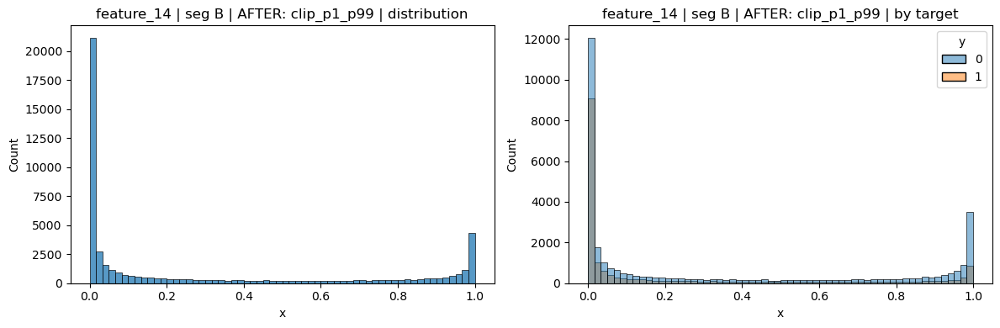

...

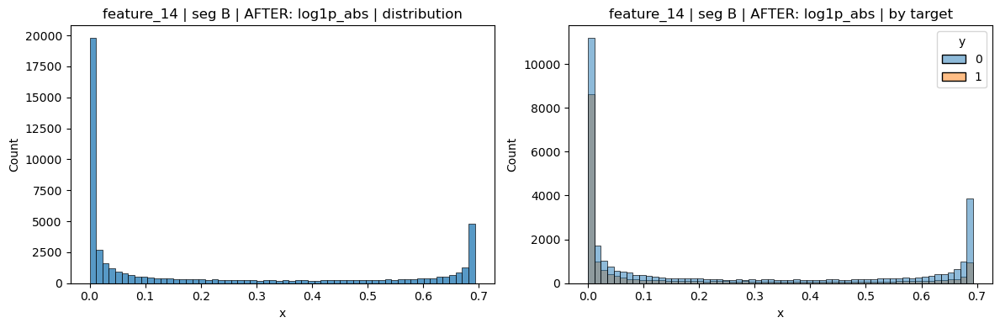

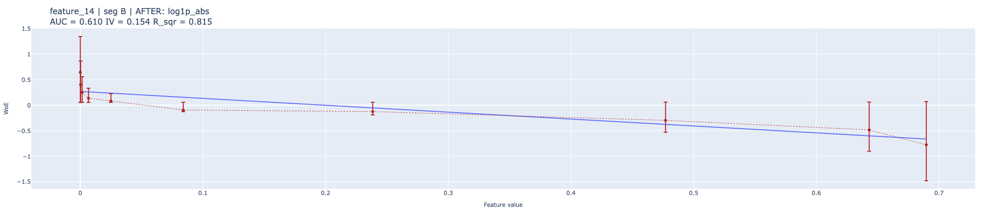

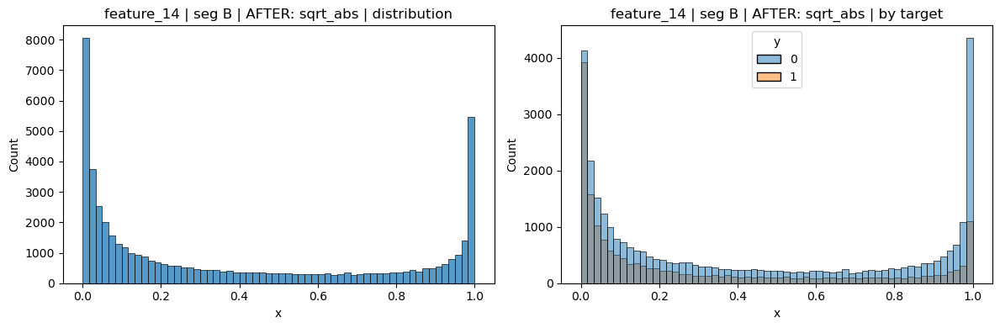

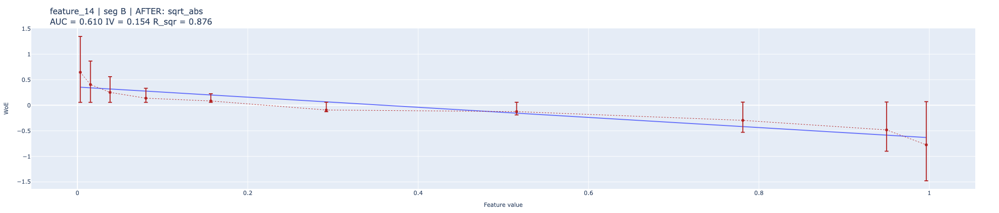

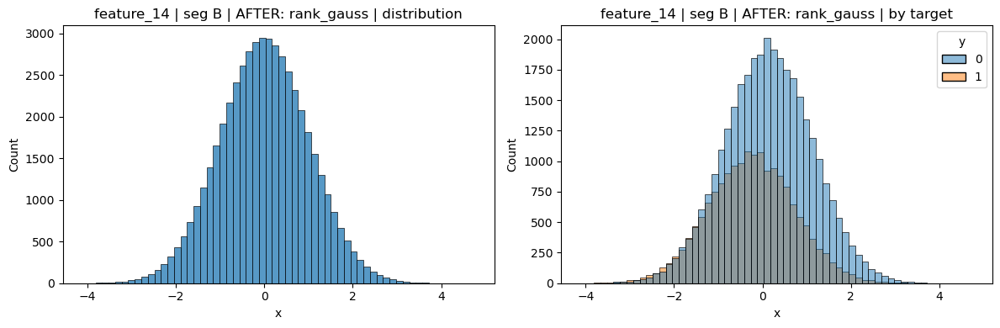

In [170]:
n_buckets = 10

for seg in sorted(df[seg_col].unique()):
    df_seg = df[df[seg_col] == seg].copy()
    y = df_seg[target_col].values.astype(int)

    print("сегмент:", seg, "size:", len(df_seg))

    for col in num_cols:
        x = df_seg[col].values
        print(f"{col} | segment {seg}")

        plot_distribution(x, y, title=f"{col} | seg {seg} | BEFORE")
        buckets_before = calc_buckets(x, n_buckets)
        title_before = calc_plot_title(values=x, target=y, buckets=buckets_before)
        fig_before = woe_line(values=x, target=y, n_buckets=n_buckets)
        fig_before.update_layout(title=f"{col} | seg {seg} | BEFORE<br>{title_before}")
        fig_before.show()

        for tname, f in transforms:
            xt = f(x)
            if not np.isfinite(xt).all():
                print(f"skip transform {tname}: non-finite values")
                continue
            plot_distribution(
                xt,
                y,
                title=f"{col} | seg {seg} | AFTER: {tname}"
            )
            buckets_after = calc_buckets(xt, n_buckets)
            title_after = calc_plot_title(
                values=xt,
                target=y,
                buckets=buckets_after
            )
            fig_after = woe_line(values=xt, target=y, n_buckets=n_buckets)
            fig_after.update_layout(
                title=f"{col} | seg {seg} | AFTER: {tname}<br>{title_after}"
            )
            fig_after.show()


### Задание 4. Финальная модель.

Обучите модели на признаках, которые вы отобрали и линеаризовали в задании 3. Пусть $logit_A$ – модель, обученная на сегменте $feature_{15} = A$. $logit_B$ – модель на втором сегменте. Тогда модель на всей выборке будем считать по формуле

$$
logit(x) = \mathbb I \{ feature_{15} = A \} \times logit_A(x) + \mathbb I \{ feature_{15} = B \} \times logit_B(x)
$$


Посчитайте для этой модели AUC и IV, оцените линейность на трейне и тесте. Сравните результаты с бейзлайном из задания 1.

Подсказка: если вы все сделали правильно, можно ожидать ROC AUC около 0.9 на тестовой выборке.

In [169]:
seg_transforms = {
    "A": {
        "feature_1": "rank_gauss",
        "feature_3": "rank_gauss",
        "feature_11": "rank_gauss",
        "feature_12": "rank_gauss",
        "feature_14": "rank_gauss",
    },
    "B": {
        "feature_1": "rank_gauss",
        "feature_3": "rank_gauss",
        "feature_11": "rank_gauss",
        "feature_12": "clip_p1_p99",
        "feature_14": "rank_gauss",
    }
}

transform_funcs = {
    "rank_gauss": safe_rank_gauss,
    "clip_p1_p99": clip_p1_p99
}

target_col = "d4p12"
seg_col = "feature_15"
n_buckets = 10
np.random.seed(89)
df_work = df.copy()

idx_train, idx_test = train_test_split(df_work.index, test_size=0.2, stratify=df_work[target_col])

df_train = df_work.loc[idx_train].copy()
df_test = df_work.loc[idx_test].copy()

def apply_segment_transforms(df_part: pd.DataFrame) -> pd.DataFrame:
    out = df_part.copy()
    for seg in ["A", "B"]:
        mask = out[seg_col] == seg
        for feat, tname in seg_transforms[seg].items():
            f = transform_funcs[tname]
            out.loc[mask, feat] = f(out.loc[mask, feat].values)
    return out

df_train_t = apply_segment_transforms(df_train)
df_test_t = apply_segment_transforms(df_test)

In [159]:
train_A = df_train_t[df_train_t[seg_col] == "A"].copy()
train_B = df_train_t[df_train_t[seg_col] == "B"].copy()
test_A = df_test_t[df_test_t[seg_col] == "A"].copy()
test_B = df_test_t[df_test_t[seg_col] == "B"].copy()

features_A = list(seg_transforms["A"].keys())
features_B = list(seg_transforms["B"].keys())

X_train_A = train_A[features_A].values
y_train_A = train_A[target_col].values.astype(int)
X_test_A = test_A[features_A].values
y_test_A = test_A[target_col].values.astype(int)

X_train_B = train_B[features_B].values
y_train_B = train_B[target_col].values.astype(int)
X_test_B = test_B[features_B].values
y_test_B = test_B[target_col].values.astype(int)

In [160]:
scaler_A = StandardScaler()
X_train_A_s = scaler_A.fit_transform(X_train_A)
X_test_A_s = scaler_A.transform(X_test_A)

scaler_B = StandardScaler()
X_train_B_s = scaler_B.fit_transform(X_train_B)
X_test_B_s = scaler_B.transform(X_test_B)

logit_A = LogisticRegression(max_iter=1000)
logit_B = LogisticRegression(max_iter=1000)

logit_A.fit(X_train_A_s, y_train_A)
logit_B.fit(X_train_B_s, y_train_B)

score_train_A = logit_A.predict_proba(X_train_A_s)[:, 1]
score_test_A = logit_A.predict_proba(X_test_A_s)[:, 1]

score_train_B = logit_B.predict_proba(X_train_B_s)[:, 1]
score_test_B = logit_B.predict_proba(X_test_B_s)[:, 1]

In [164]:
def assemble_scores(df_part: pd.DataFrame, score_A: np.ndarray, score_B: np.ndarray) -> np.ndarray:
    score = np.zeros(len(df_part), dtype=float)
    mask_A = (df_part[seg_col].values == "A")
    mask_B = (df_part[seg_col].values == "B")
    score[mask_A] = score_A
    score[mask_B] = score_B
    return score

train: AUC = 0.885 IV = 3.003 R_sqr = 0.925


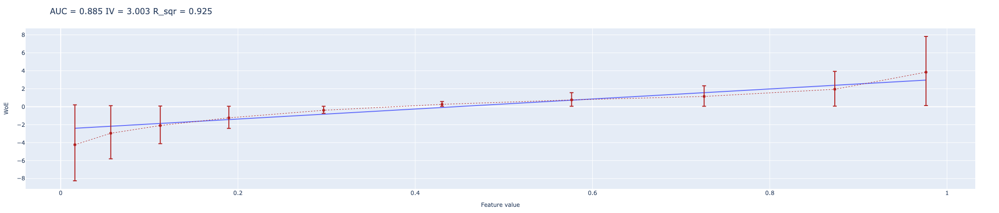

test : AUC = 0.881 IV = 2.844 R_sqr = 0.931


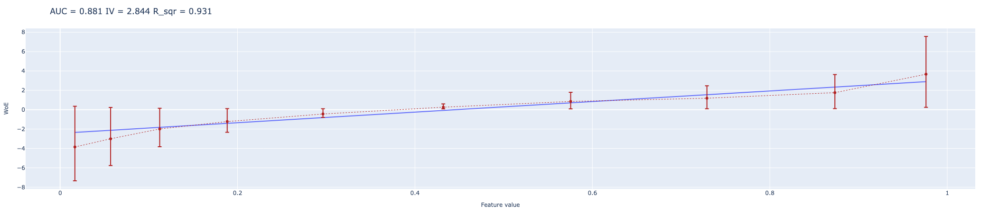

In [167]:
score_train = np.zeros(len(df_train_t), dtype=float)
score_test = np.zeros(len(df_test_t), dtype=float)

mask_train_A = df_train_t[seg_col].values == "A"
mask_train_B = df_train_t[seg_col].values == "B"
score_train[mask_train_A] = score_train_A
score_train[mask_train_B] = score_train_B

mask_test_A = df_test_t[seg_col].values == "A"
mask_test_B = df_test_t[seg_col].values == "B"
score_test[mask_test_A] = score_test_A
score_test[mask_test_B] = score_test_B

y_train_all = df_train_t[target_col].values.astype(int)
y_test_all = df_test_t[target_col].values.astype(int)

buckets_train = calc_buckets(score_train, n_buckets)
buckets_test = calc_buckets(score_test, n_buckets)

print("train:", calc_plot_title(score_train, y_train_all, buckets_train))
fig_train = woe_line(values=score_train, target=y_train_all, n_buckets=n_buckets)
fig_train.update_layout(title=calc_plot_title(score_train, y_train_all, buckets_train))
fig_train.show()

print("test :", calc_plot_title(score_test, y_test_all, buckets_test))
fig_test = woe_line(values=score_test, target=y_test_all, n_buckets=n_buckets)
fig_test.update_layout(title=calc_plot_title(score_test, y_test_all, buckets_test))
fig_test.show()


По сравнению с бейзлайном сегментированная модель с линеаризованными признаками показала рост качества: ROC AUC на тесте увеличился с 0.71 до 0.88, а IV — с 0.64 до 2.84, что говорит о значительно более сильной разделяющей способности . Метрики на трейне и тесте близки, поэтому признаков переобучения не наблюдается. Линейность скоринга немного снизилась. 

# Часть 3. Бонус. (3 балла)

На лекции мы накопили ряд упражнений, которые стоит решить для понимания происходившего. Вы можете $\TeX$ать их прямо в ноуте (или прикреплять картинки, если так удобнее).

#### **Упражнение 1**

Для определения $WoE$ мы пользовались Теоремой Байеса. Примените ее и **покажите, что верно равенство**:

$$
\ln \left(  \frac{P(x_i|y=1)}{P(x_i|y=0)} \right) = ... = \ln \left( \frac{P(y=1|x_i)}{P(y=0|x_i)} \right) - \ln \left( \frac{P(y=1)}{P(y=0)} \right)
$$

```
your solution here
```

#### **Упражнение 2**

Известно:

$WoE$ можно посчитать так:
$WoE_i(x_i) = \ln \Big ( \frac{B_i}{G_i} \Big ) - \ln \Big ( \frac{B}{G} \Big ) $

Частота выхода в дефолт:  $badrate = \frac{B}{B+G}; \quad badrate_i = \frac{B_i}{B_i+G_i}$

$
\sigma (x) = \frac{1}{1+e^{-x}}; \quad logit(x) = \ln \left( \frac{x}{1-x} \right)
$

**Покажите, что**
$WoE_i(x_i) = logit(badrate_i) - logit(badrate)$

```
your solution here
```

#### **Упражнение 3**

Пусть даны два дискретных распределения: 

$B=(b_1, ..., b_n)$ и $G=(g_1, ..., g_n)$.

KL-дивергенция для дискретных распределений

$$D_{KL}(B||G) = \sum_{j=1}^{n} b_j \ln \left( \frac{b_j}{g_j} \right)$$


Пусть $x$ - дикретный признак, принмиающий значения $x_1,...,x_n$.
Известно определение IV через KL-дивергенцию:

$$
IV_x = D_{KL}(B_x||G_x)+D_{KL}(G_x||B_x)
$$
где 

$$
B_x (x_i) = P(x=x_i|y=1) = b_i; \quad G_x (x_i) = P(x=x_i|y=0) = g_i
$$

**Выразите $IV$ через $WoE$**





```
your solution here
```